In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import yfinance as yf
from datetime import datetime, timedelta
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [2]:
# Set plotting styles
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("viridis")

def download_stock_data(ticker_symbol, period="5y", interval="1d"):
    """
    Download historical stock data using yfinance
    
    Parameters:
    ticker_symbol (str): Stock ticker symbol
    period (str): Period of data to download (e.g., '1y', '2y', '5y', 'max')
    interval (str): Data interval ('1d', '1wk', '1mo')
    
    Returns:
    pd.DataFrame: DataFrame with historical stock data
    """
    print(f"Downloading data for {ticker_symbol}...")
    stock = yf.Ticker(ticker_symbol)
    df = stock.history(period=period, interval=interval)
    
    # Reset index to make Date a column
    df.reset_index(inplace=True)
    
    # Add additional columns
    if 'Date' in df.columns:
        df['Year'] = df['Date'].dt.year
        df['Month'] = df['Date'].dt.month
        df['Day'] = df['Date'].dt.day
        df['Weekday'] = df['Date'].dt.day_name()
    
    # Calculate daily returns
    df['Daily_Return'] = df['Close'].pct_change() * 100
    
    # Calculate volatility (20-day rolling standard deviation of returns)
    df['Volatility_20d'] = df['Daily_Return'].rolling(window=20).std()
    
    print(f"Downloaded {len(df)} rows of data")
    return df, stock

In [3]:
def add_technical_indicators(df):
    """
    Add common technical indicators to the dataframe
    
    Parameters:
    df (pd.DataFrame): DataFrame with stock price data
    
    Returns:
    pd.DataFrame: DataFrame with added technical indicators
    """
    # Simple Moving Averages
    df['SMA_20'] = df['Close'].rolling(window=20).mean()
    df['SMA_50'] = df['Close'].rolling(window=50).mean()
    df['SMA_200'] = df['Close'].rolling(window=200).mean()
    
    # Exponential Moving Averages
    df['EMA_20'] = df['Close'].ewm(span=20, adjust=False).mean()
    
    # Bollinger Bands (20-day, 2 standard deviations)
    df['BB_Middle'] = df['SMA_20']
    df['BB_Upper'] = df['BB_Middle'] + 2 * df['Close'].rolling(window=20).std()
    df['BB_Lower'] = df['BB_Middle'] - 2 * df['Close'].rolling(window=20).std()
    
    # Relative Strength Index (RSI)
    delta = df['Close'].diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    avg_gain = gain.rolling(window=14).mean()
    avg_loss = loss.rolling(window=14).mean()
    rs = avg_gain / avg_loss
    df['RSI'] = 100 - (100 / (1 + rs))
    
    # MACD
    df['EMA_12'] = df['Close'].ewm(span=12, adjust=False).mean()
    df['EMA_26'] = df['Close'].ewm(span=26, adjust=False).mean()
    df['MACD'] = df['EMA_12'] - df['EMA_26']
    df['MACD_Signal'] = df['MACD'].ewm(span=9, adjust=False).mean()
    df['MACD_Hist'] = df['MACD'] - df['MACD_Signal']
    
    # Add trading volume moving averages
    df['Volume_SMA_20'] = df['Volume'].rolling(window=20).mean()
    
    # Price momentum
    df['Momentum_14d'] = df['Close'] - df['Close'].shift(14)
    
    return df

In [4]:
def plot_basic_stock_info(df, ticker_symbol):
    """
    Create basic plots for stock data analysis
    """
    fig, axes = plt.subplots(3, 1, figsize=(14, 18))
    
    # Plot 1: Stock price history with volume
    ax1 = axes[0]
    ax1.set_title(f'{ticker_symbol} Stock Price History', fontsize=16)
    ax1.plot(df['Date'], df['Close'], color='blue', linewidth=2)
    ax1.set_ylabel('Price ($)', fontsize=14)
    ax1.grid(True)
    
    # Create twin axis for volume
    ax1v = ax1.twinx()
    ax1v.bar(df['Date'], df['Volume'], alpha=0.3, color='gray')
    ax1v.set_ylabel('Volume', fontsize=14)
    
    # Plot 2: Daily returns
    ax2 = axes[1]
    ax2.set_title(f'{ticker_symbol} Daily Returns', fontsize=16)
    ax2.plot(df['Date'], df['Daily_Return'], color='green', alpha=0.7)
    ax2.axhline(y=0, color='r', linestyle='-', alpha=0.3)
    ax2.set_ylabel('Daily Return (%)', fontsize=14)
    ax2.grid(True)
    
    # Plot 3: Volatility
    ax3 = axes[2]
    ax3.set_title(f'{ticker_symbol} Volatility (20-day Rolling Std Dev)', fontsize=16)
    ax3.plot(df['Date'], df['Volatility_20d'], color='red')
    ax3.set_ylabel('Volatility (%)', fontsize=14)
    ax3.grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # Distribution of daily returns
    plt.figure(figsize=(14, 6))
    sns.histplot(df['Daily_Return'].dropna(), kde=True, bins=100)
    plt.title(f'Distribution of Daily Returns for {ticker_symbol}', fontsize=16)
    plt.xlabel('Daily Return (%)')
    plt.ylabel('Frequency')
    plt.axvline(x=0, color='r', linestyle='--')
    plt.grid(True)
    plt.show()
    
    # QQ Plot for returns
    plt.figure(figsize=(10, 10))
    from scipy import stats
    stats.probplot(df['Daily_Return'].dropna(), dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of Daily Returns for {ticker_symbol}', fontsize=16)
    plt.grid(True)
    plt.show()

In [5]:
def plot_technical_indicators(df, ticker_symbol):
    """
    Plot technical indicators for the stock
    """
    # Create subplot for price and indicators
    fig, axes = plt.subplots(4, 1, figsize=(14, 20))
    
    # Plot 1: Price with SMA and Bollinger Bands
    ax1 = axes[0]
    ax1.set_title(f'{ticker_symbol} Price with SMA and Bollinger Bands', fontsize=16)
    ax1.plot(df['Date'], df['Close'], label='Close Price', color='blue')
    ax1.plot(df['Date'], df['SMA_20'], label='SMA 20', color='orange', alpha=0.7)
    ax1.plot(df['Date'], df['SMA_50'], label='SMA 50', color='green', alpha=0.7)
    ax1.plot(df['Date'], df['SMA_200'], label='SMA 200', color='red', alpha=0.7)
    ax1.plot(df['Date'], df['BB_Upper'], label='BB Upper', color='gray', linestyle='--', alpha=0.5)
    ax1.plot(df['Date'], df['BB_Lower'], label='BB Lower', color='gray', linestyle='--', alpha=0.5)
    ax1.fill_between(df['Date'], df['BB_Upper'], df['BB_Lower'], alpha=0.1, color='gray')
    ax1.set_ylabel('Price ($)', fontsize=14)
    ax1.legend()
    ax1.grid(True)
    
    # Plot 2: RSI
    ax2 = axes[1]
    ax2.set_title(f'{ticker_symbol} Relative Strength Index (RSI)', fontsize=16)
    ax2.plot(df['Date'], df['RSI'], color='purple')
    ax2.axhline(y=70, color='r', linestyle='--', alpha=0.5)
    ax2.axhline(y=30, color='g', linestyle='--', alpha=0.5)
    ax2.set_ylabel('RSI', fontsize=14)
    ax2.grid(True)
    
    # Plot 3: MACD
    ax3 = axes[2]
    ax3.set_title(f'{ticker_symbol} MACD', fontsize=16)
    ax3.plot(df['Date'], df['MACD'], label='MACD', color='blue')
    ax3.plot(df['Date'], df['MACD_Signal'], label='Signal Line', color='red')
    ax3.bar(df['Date'], df['MACD_Hist'], label='Histogram', color='green', alpha=0.5)
    ax3.set_ylabel('MACD', fontsize=14)
    ax3.legend()
    ax3.grid(True)
    
    # Plot 4: Volume
    ax4 = axes[3]
    ax4.set_title(f'{ticker_symbol} Trading Volume', fontsize=16)
    ax4.bar(df['Date'], df['Volume'], color='darkblue', alpha=0.7)
    ax4.plot(df['Date'], df['Volume_SMA_20'], color='orange', label='Volume SMA 20')
    ax4.set_ylabel('Volume', fontsize=14)
    ax4.legend()
    ax4.grid(True)
    
    plt.tight_layout()
    plt.show()

In [6]:
def seasonal_analysis(df, ticker_symbol):
    """
    Perform seasonal analysis on the stock data
    """
    # Aggregate returns by month
    monthly_returns = df.copy()
    monthly_returns = monthly_returns.groupby(['Year', 'Month'])['Daily_Return'].mean().reset_index()
    monthly_pivot = monthly_returns.pivot_table(index='Month', columns='Year', values='Daily_Return')
    
    plt.figure(figsize=(14, 7))
    sns.heatmap(monthly_pivot, cmap='RdYlGn', center=0, annot=True, fmt='.2f')
    plt.title(f'Monthly Returns Heatmap for {ticker_symbol}', fontsize=16)
    plt.xlabel('Year')
    plt.ylabel('Month')
    plt.show()
    
    # Average returns by month
    avg_monthly = monthly_returns.groupby('Month')['Daily_Return'].mean()
    
    plt.figure(figsize=(14, 7))
    avg_monthly.plot(kind='bar', color=sns.color_palette("viridis", 12))
    plt.title(f'Average Monthly Returns for {ticker_symbol}', fontsize=16)
    plt.xlabel('Month')
    plt.ylabel('Average Daily Return (%)')
    plt.grid(True, axis='y')
    plt.show()
    
    # Average returns by weekday
    weekday_returns = df.groupby('Weekday')['Daily_Return'].mean().reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'])
    
    plt.figure(figsize=(14, 7))
    weekday_returns.plot(kind='bar', color=sns.color_palette("viridis", 5))
    plt.title(f'Average Returns by Weekday for {ticker_symbol}', fontsize=16)
    plt.xlabel('Weekday')
    plt.ylabel('Average Daily Return (%)')
    plt.grid(True, axis='y')
    plt.show()
    
    # Time series decomposition (on closing prices)
    # Resampling to monthly frequency for better decomposition
    monthly_close = df.set_index('Date')['Close'].resample('ME').last()
    
    try:
        decomposition = seasonal_decompose(monthly_close, model='multiplicative', period=12)
        
        fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(14, 16))
        decomposition.observed.plot(ax=ax1)
        ax1.set_title('Observed', fontsize=14)
        decomposition.trend.plot(ax=ax2)
        ax2.set_title('Trend', fontsize=14)
        decomposition.seasonal.plot(ax=ax3)
        ax3.set_title('Seasonal', fontsize=14)
        decomposition.resid.plot(ax=ax4)
        ax4.set_title('Residual', fontsize=14)
        
        plt.tight_layout()
        plt.suptitle(f'Time Series Decomposition for {ticker_symbol}', fontsize=16, y=1.02)
        plt.show()
    except:
        print("Could not perform seasonal decomposition, possibly due to NaN values or insufficient data")
        
    # ACF and PACF
    plt.figure(figsize=(14, 7))
    plot_acf(df['Close'].dropna(), lags=50, ax=plt.gca())
    plt.title(f'Autocorrelation Function (ACF) for {ticker_symbol} Close Price', fontsize=16)
    plt.grid(True)
    plt.show()
    
    plt.figure(figsize=(14, 7))
    plot_pacf(df['Close'].dropna(), lags=50, ax=plt.gca())
    plt.title(f'Partial Autocorrelation Function (PACF) for {ticker_symbol} Close Price', fontsize=16)
    plt.grid(True)
    plt.show()

In [7]:
def correlation_analysis(tickers_list, period="5y"):
    """
    Analyze correlation between multiple stocks
    
    Parameters:
    tickers_list (list): List of ticker symbols
    period (str): Period of data to download
    """
    # Download data for all tickers
    data = {}
    for ticker in tickers_list:
        stock_data, _ = download_stock_data(ticker, period=period)
        data[ticker] = stock_data.set_index('Date')['Close']
    
    # Create dataframe with all close prices
    all_stocks = pd.DataFrame(data)
    
    # Calculate daily returns
    returns_df = all_stocks.pct_change().dropna()
    
    # Calculate correlation matrix
    corr_matrix = returns_df.corr()
    
    # Plot correlation heatmap
    plt.figure(figsize=(12, 10))
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot=True, 
                fmt=".2f", linewidths=0.5, vmin=-1, vmax=1)
    plt.title('Correlation Matrix of Daily Returns', fontsize=16)
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()
    
    # Plot all stocks normalized
    normalized = all_stocks / all_stocks.iloc[0] * 100
    
    plt.figure(figsize=(14, 8))
    for col in normalized.columns:
        plt.plot(normalized.index, normalized[col], label=col)
    plt.title('Comparative Performance (Normalized to 100)', fontsize=16)
    plt.xlabel('Date')
    plt.ylabel('Normalized Price')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    return returns_df, corr_matrix

In [8]:
def plot_interactive_chart(df, ticker_symbol):
    """
    Create an interactive chart using Plotly
    """
    fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                        vertical_spacing=0.1, subplot_titles=(f'{ticker_symbol} Stock Price', 'Volume'), 
                        row_heights=[0.7, 0.3])
    
    # Add candlestick chart
    fig.add_trace(go.Candlestick(x=df['Date'],
                                 open=df['Open'],
                                 high=df['High'],
                                 low=df['Low'],
                                 close=df['Close'],
                                 name='Price'),
                  row=1, col=1)
    
    # Add moving averages
    fig.add_trace(go.Scatter(x=df['Date'], y=df['SMA_20'], line=dict(color='orange', width=1), 
                             name='SMA 20'), row=1, col=1)
    fig.add_trace(go.Scatter(x=df['Date'], y=df['SMA_50'], line=dict(color='green', width=1), 
                             name='SMA 50'), row=1, col=1)
    fig.add_trace(go.Scatter(x=df['Date'], y=df['SMA_200'], line=dict(color='red', width=1), 
                             name='SMA 200'), row=1, col=1)
    
    # Add Bollinger Bands
    fig.add_trace(go.Scatter(x=df['Date'], y=df['BB_Upper'], line=dict(color='rgba(0,0,0,0.3)', width=1), 
                             name='BB Upper'), row=1, col=1)
    fig.add_trace(go.Scatter(x=df['Date'], y=df['BB_Lower'], line=dict(color='rgba(0,0,0,0.3)', width=1), 
                             name='BB Lower'), row=1, col=1)
    fig.add_trace(go.Scatter(x=df['Date'], y=df['BB_Middle'], line=dict(color='rgba(0,0,0,0.3)', width=1), 
                             name='BB Middle'), row=1, col=1)
    
    # Add volume bar chart
    fig.add_trace(go.Bar(x=df['Date'], y=df['Volume'], name='Volume', marker_color='darkblue'), 
                  row=2, col=1)
    
    # Update layout
    fig.update_layout(title=f'{ticker_symbol} Stock Analysis', 
                      yaxis_title='Price ($)',
                      yaxis2_title='Volume',
                      height=800, width=1200,
                      showlegend=True,
                      xaxis_rangeslider_visible=False)
    
    # Update x and y axes
    fig.update_xaxes(type='date', rangeslider_visible=False)
    fig.update_yaxes(autorange=True)
    
    fig.show()

In [9]:
def perform_feature_importance(df):
    """
    Perform feature importance analysis for predicting stock price movement
    """
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.preprocessing import StandardScaler
    from sklearn.model_selection import train_test_split
    from sklearn.metrics import classification_report
    import matplotlib.pyplot as plt
    
    # Create target: 1 if price goes up next day, 0 if it goes down
    df['Target'] = (df['Close'].shift(-1) > df['Close']).astype(int)
    
    # Select potential predictor features
    features = ['Open', 'High', 'Low', 'Close', 'Volume', 
                'Daily_Return', 'Volatility_20d', 'SMA_20', 'SMA_50', 'SMA_200',
                'RSI', 'MACD', 'MACD_Signal', 'Momentum_14d']
    
    # Drop rows with NaN (usually at the beginning due to rolling calculations)
    df_ml = df.dropna().copy()
    
    # Create feature matrix X and target vector y
    X = df_ml[features]
    y = df_ml['Target']
    
    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    # Train Random Forest Classifier
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X_train_scaled, y_train)
    
    # Evaluate model
    y_pred = rf.predict(X_test_scaled)
    print("\nRandom Forest Classification Report (Predicting Price Direction):")
    print(classification_report(y_test, y_pred))
    
    # Plot feature importances
    importances = rf.feature_importances_
    indices = np.argsort(importances)[::-1]
    
    plt.figure(figsize=(12, 8))
    plt.title('Feature Importances for Price Direction Prediction', fontsize=16)
    plt.bar(range(X.shape[1]), importances[indices], align='center')
    plt.xticks(range(X.shape[1]), [features[i] for i in indices], rotation=90)
    plt.tight_layout()
    plt.show()
    
    return rf, features, indices, importances

In [10]:
def explore_specific_stocks(ticker_symbols=['AAPL', 'MSFT', 'GOOG', 'GOOGL', 'AMZN', 'ABBV', 'ADBE', 'ADI', 'ABNB', 'ZTS', 'XOM', 'JNJ', 'ACN', 'CMCSA', 'LMT']):
    """
    Perform EDA on a list of specific stocks
    """
    for ticker in ticker_symbols:
        print(f"\n{'='*50}")
        print(f"Analyzing {ticker}")
        print(f"{'='*50}")
        
        # Download data
        df, stock = download_stock_data(ticker)
        
        # Add technical indicators
        df = add_technical_indicators(df)
        
        # Basic company info
        info = stock.info
        print("\nCompany Information:")
        try:
            print(f"Company: {info.get('longName', 'N/A')}")
            print(f"Sector: {info.get('sector', 'N/A')}")
            print(f"Industry: {info.get('industry', 'N/A')}")
            print(f"Market Cap: ${info.get('marketCap', 'N/A'):,}")
            print(f"52-Week High: ${info.get('fiftyTwoWeekHigh', 'N/A')}")
            print(f"52-Week Low: ${info.get('fiftyTwoWeekLow', 'N/A')}")
            print(f"Beta: {info.get('beta', 'N/A')}")
            print(f"P/E Ratio: {info.get('trailingPE', 'N/A')}")
        except:
            print("Could not retrieve company information")
        
        # Basic statistics
        print("\nPrice Statistics (Last 5 years):")
        print(f"Mean Close Price: ${df['Close'].mean():.2f}")
        print(f"Standard Deviation: ${df['Close'].std():.2f}")
        print(f"Min Close Price: ${df['Close'].min():.2f}")
        print(f"Max Close Price: ${df['Close'].max():.2f}")
        print(f"Current Close Price: ${df['Close'].iloc[-1]:.2f}")
        
        print("\nReturn Statistics:")
        print(f"Mean Daily Return: {df['Daily_Return'].mean():.4f}%")
        print(f"Daily Return Std Dev: {df['Daily_Return'].std():.4f}%")
        print(f"Min Daily Return: {df['Daily_Return'].min():.4f}%")
        print(f"Max Daily Return: {df['Daily_Return'].max():.4f}%")
        
        annualized_return = ((1 + df['Daily_Return'].mean()/100) ** 252 - 1) * 100
        annualized_volatility = df['Daily_Return'].std() * np.sqrt(252)
        sharpe = annualized_return / annualized_volatility if annualized_volatility != 0 else 0
        
        print(f"Annualized Return: {annualized_return:.2f}%")
        print(f"Annualized Volatility: {annualized_volatility:.2f}%")
        print(f"Sharpe Ratio (Risk-free rate = 0%): {sharpe:.4f}")
        
        # Plots
        plot_basic_stock_info(df, ticker)
        plot_technical_indicators(df, ticker)
        seasonal_analysis(df, ticker)
        plot_interactive_chart(df, ticker)
        
        # Feature importance
        rf, features, indices, importances = perform_feature_importance(df)
        
        # Save data to CSV
        df.to_csv(f"{ticker}_data.csv", index=False)
        print(f"\nSaved processed data to {ticker}_data.csv")


Analyzing AAPL
Downloaded 1256 rows of data

Company Information:
Company: Apple Inc.
Sector: Technology
Industry: Consumer Electronics
Market Cap: $3,059,856,965,632
52-Week High: $260.1
52-Week Low: $164.92
Beta: 1.259
P/E Ratio: 31.704762

Price Statistics (Last 5 years):
Mean Close Price: $161.55
Standard Deviation: $40.03
Min Close Price: $66.74
Max Close Price: $258.74
Current Close Price: $199.74

Return Statistics:
Mean Daily Return: 0.1051%
Daily Return Std Dev: 1.8848%
Min Daily Return: -9.2456%
Max Daily Return: 15.3289%
Annualized Return: 30.29%
Annualized Volatility: 29.92%
Sharpe Ratio (Risk-free rate = 0%): 1.0124


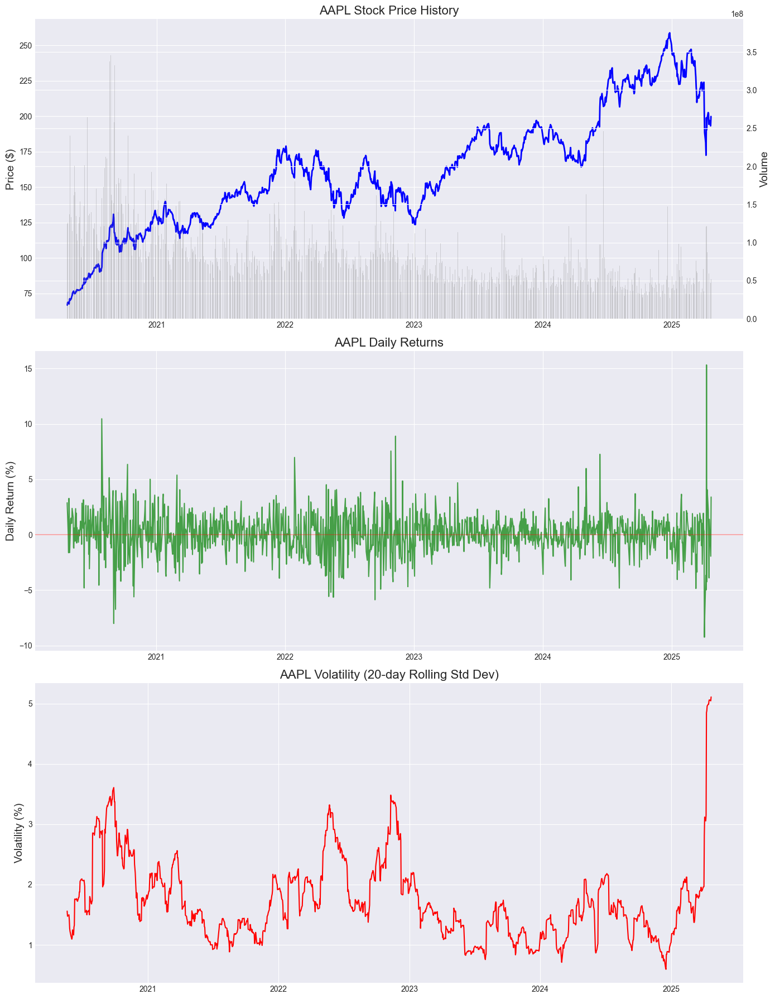

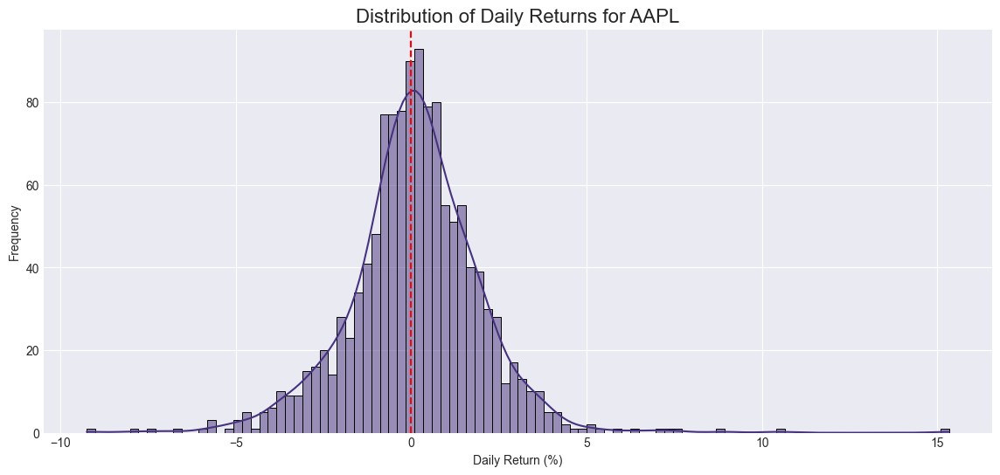

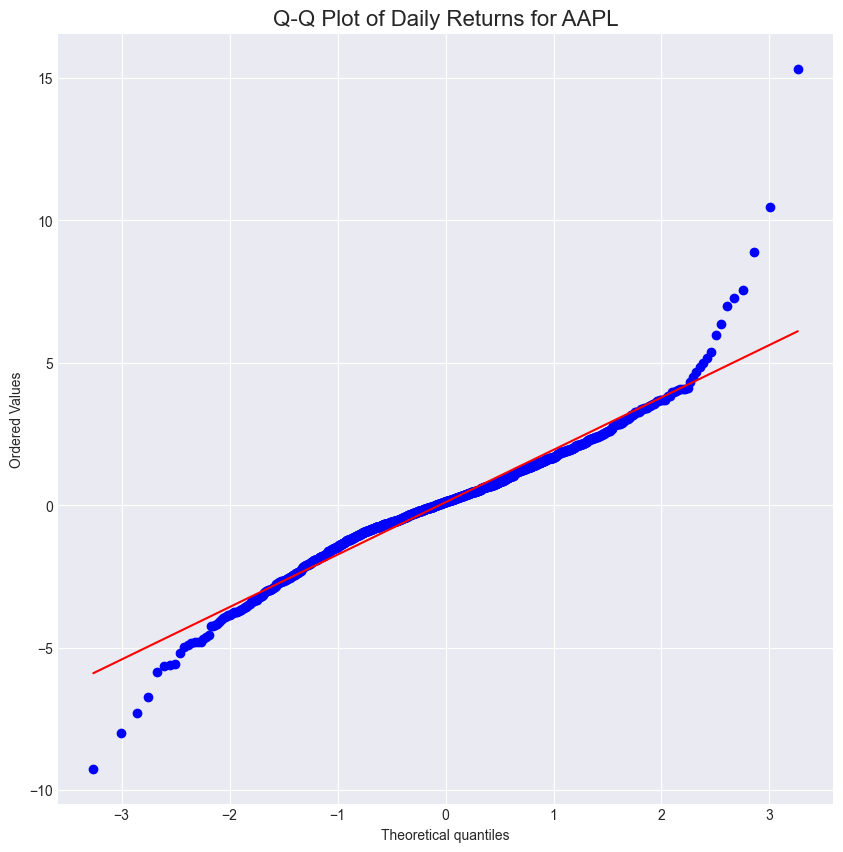

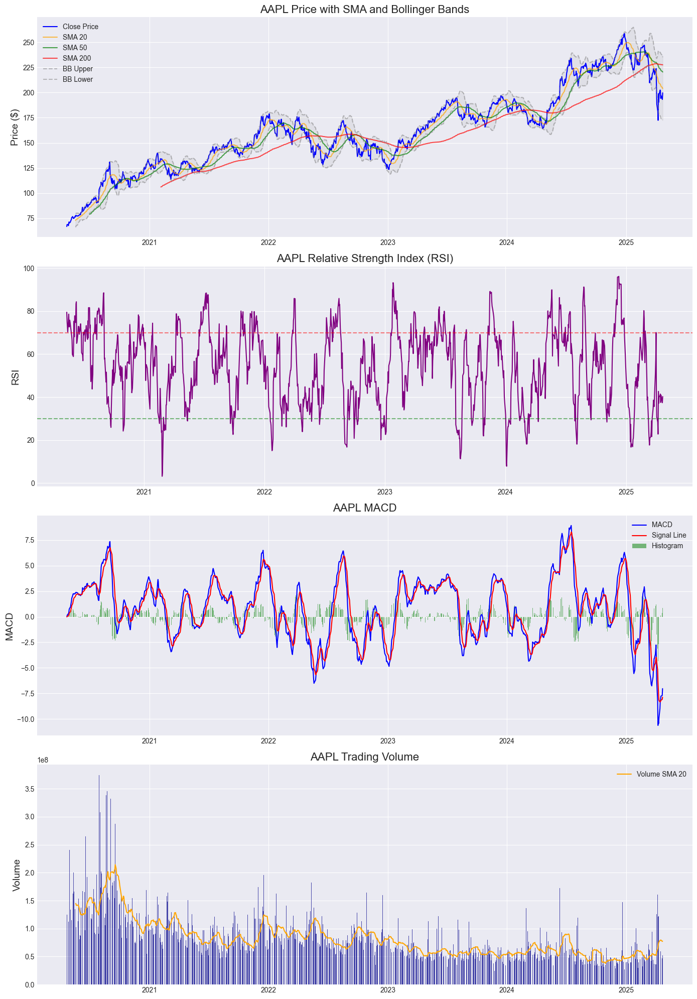

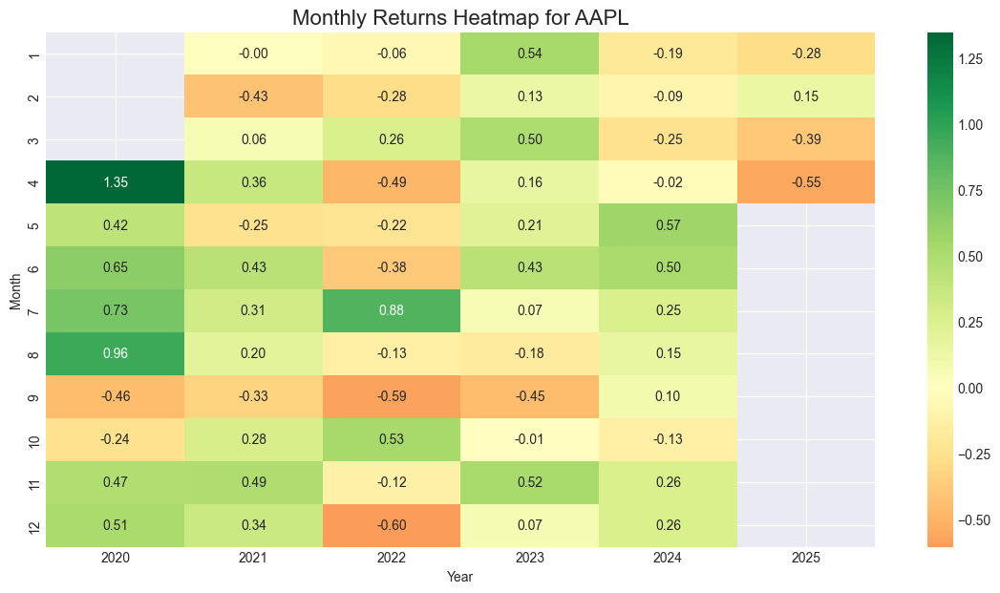

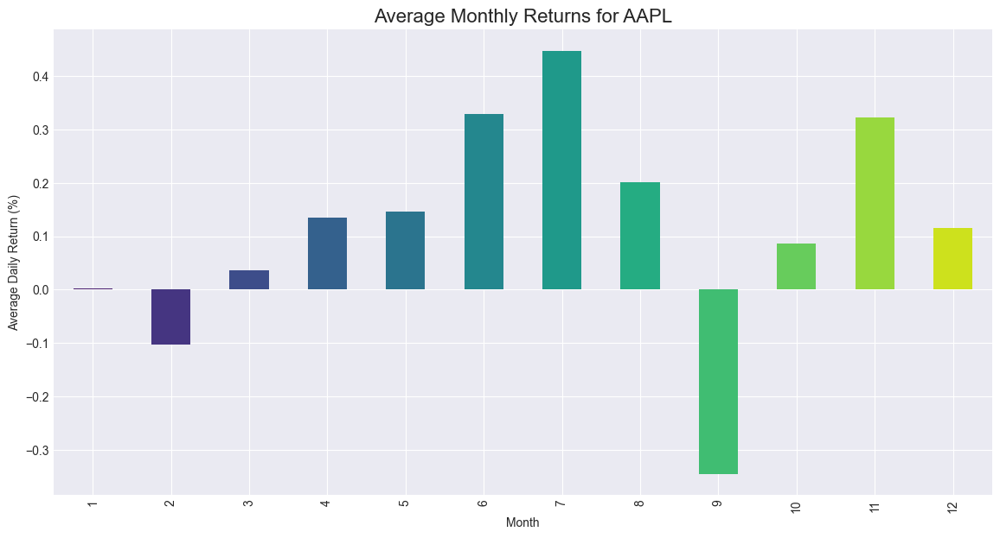

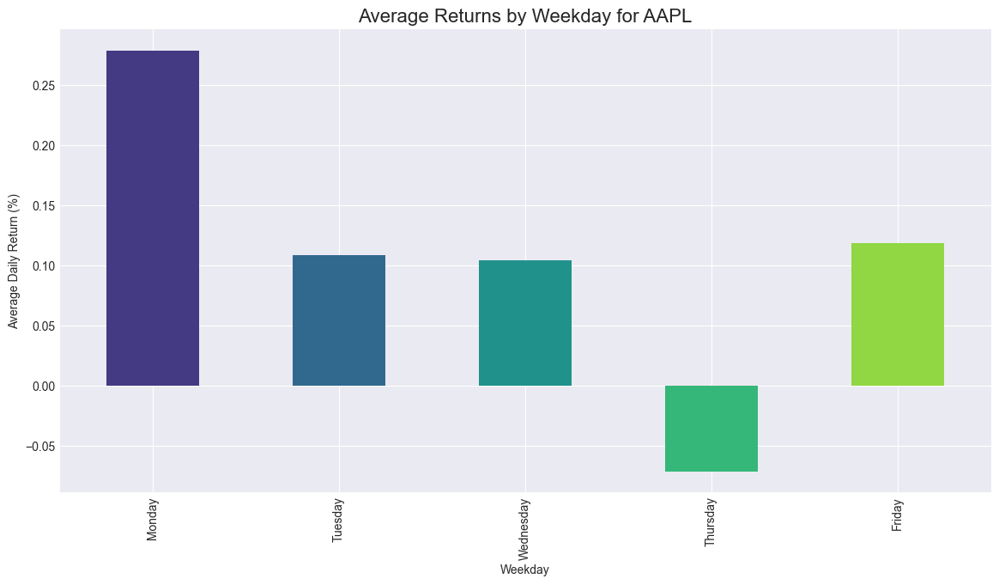

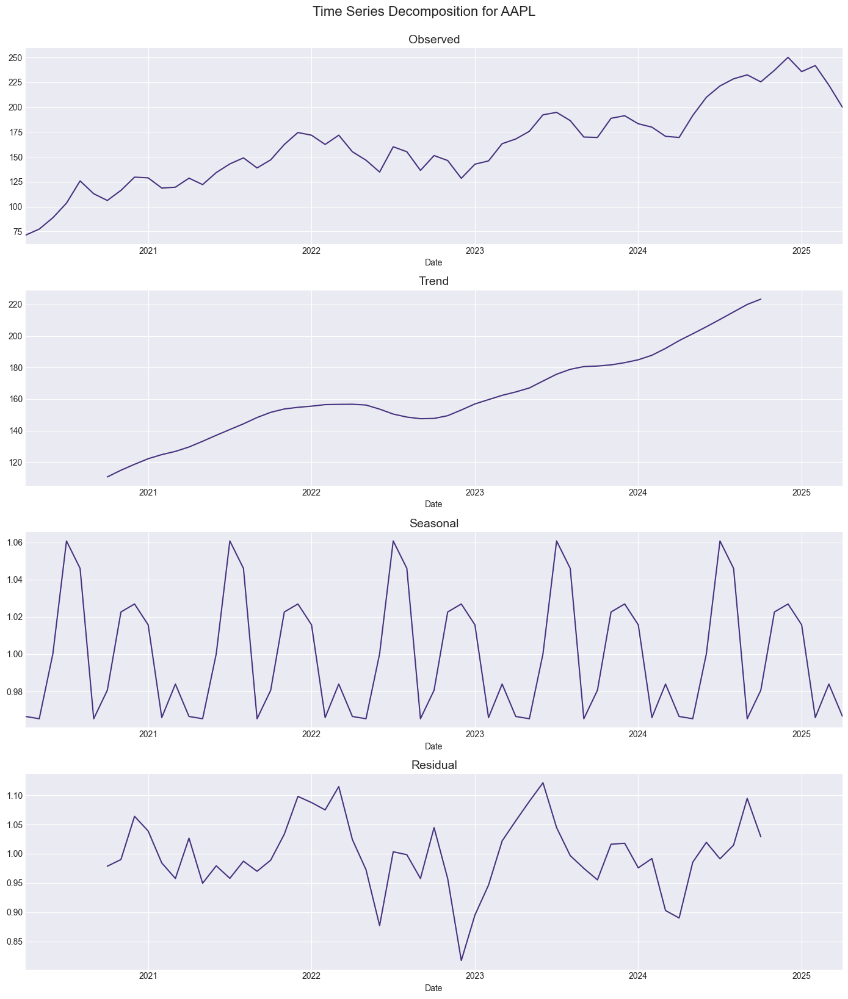

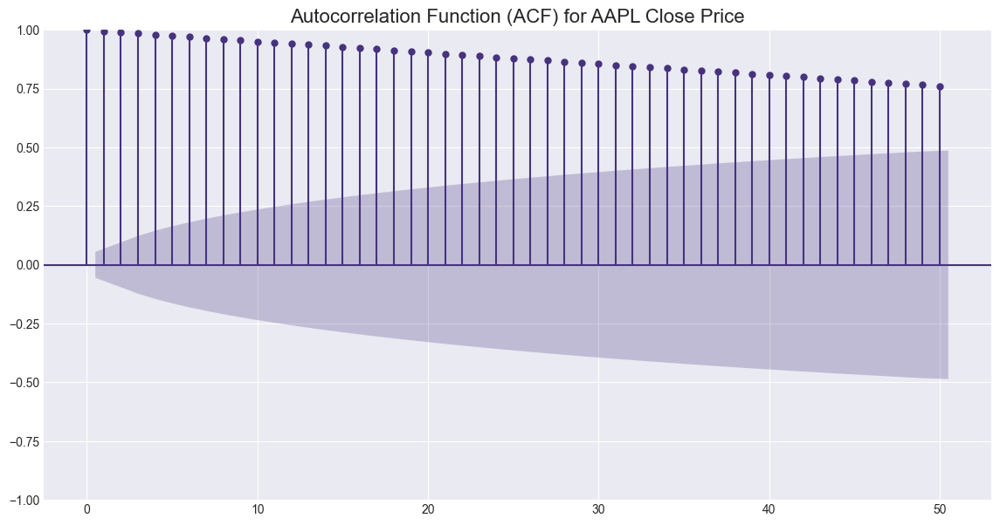

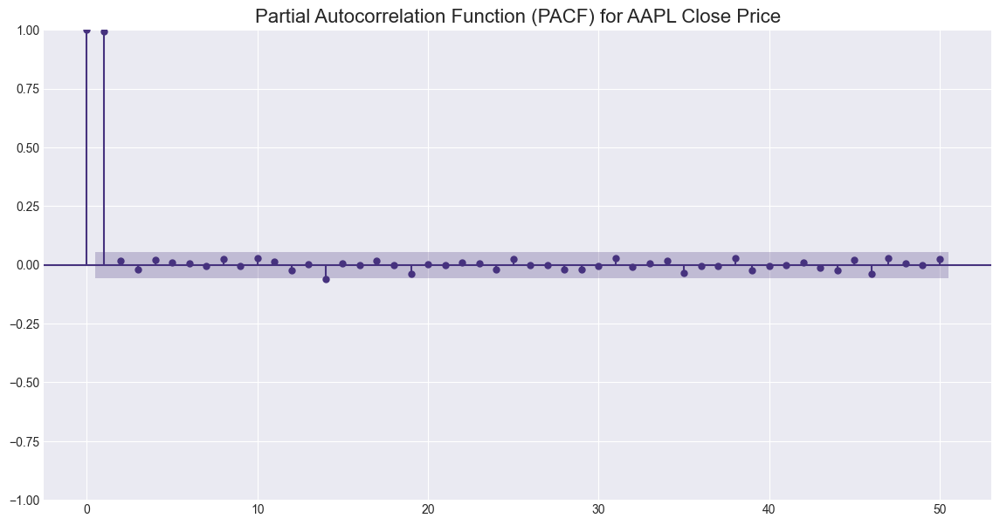


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.48      0.44      0.46        97
           1       0.56      0.59      0.57       115

    accuracy                           0.52       212
   macro avg       0.52      0.52      0.52       212
weighted avg       0.52      0.52      0.52       212



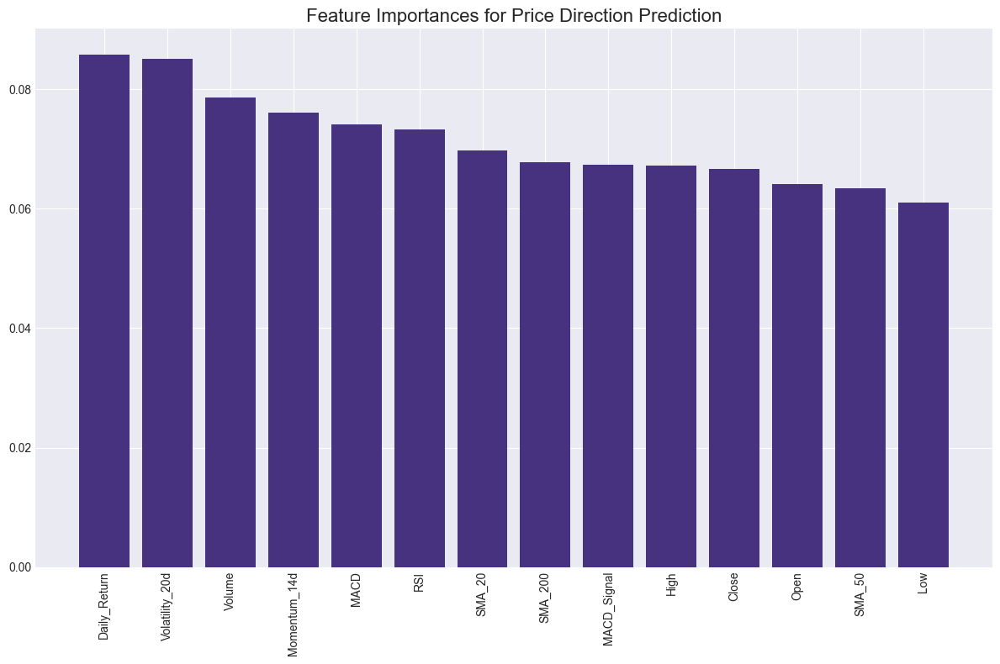


Saved processed data to AAPL_data.csv

Analyzing MSFT
Downloaded 1256 rows of data

Company Information:
Company: Microsoft Corporation
Sector: Technology
Industry: Software - Infrastructure
Market Cap: $2,792,692,383,744
52-Week High: $468.35
52-Week Low: $344.79
Beta: 1.0
P/E Ratio: 29.51086

Price Statistics (Last 5 years):
Mean Close Price: $303.25
Standard Deviation: $78.83
Min Close Price: $162.54
Max Close Price: $464.85
Current Close Price: $366.82

Return Statistics:
Mean Daily Return: 0.0786%
Daily Return Std Dev: 1.7034%
Min Daily Return: -7.7156%
Max Daily Return: 10.1337%
Annualized Return: 21.90%
Annualized Volatility: 27.04%
Sharpe Ratio (Risk-free rate = 0%): 0.8099


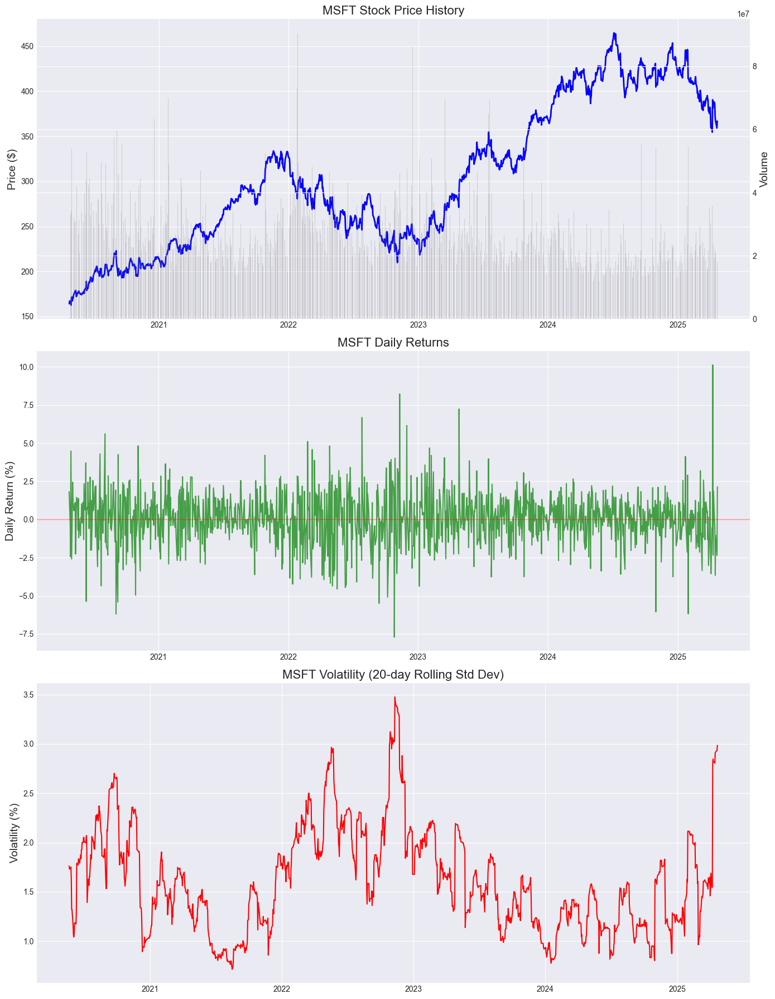

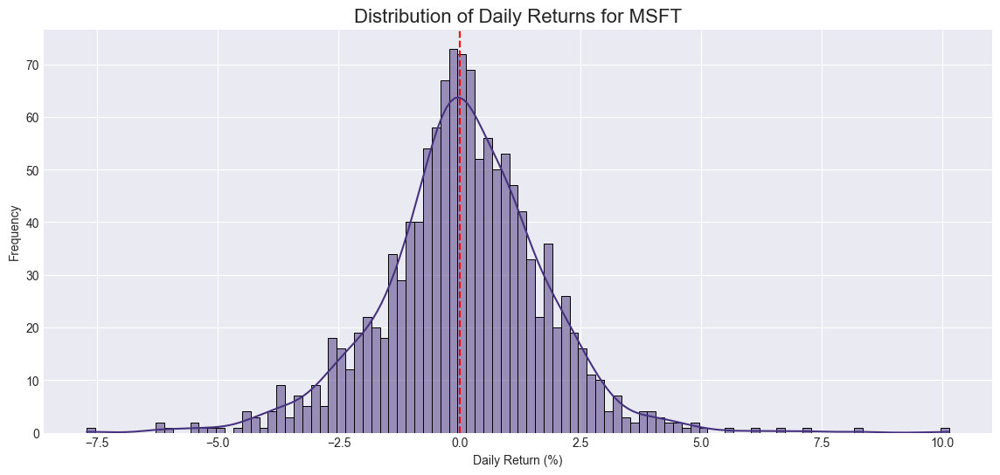

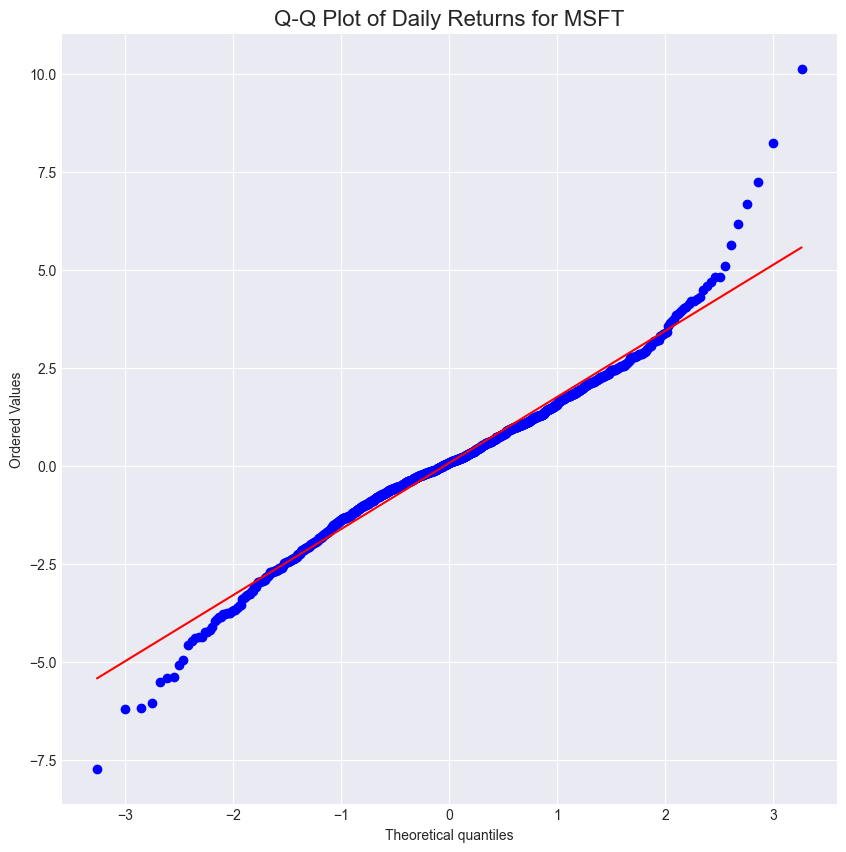

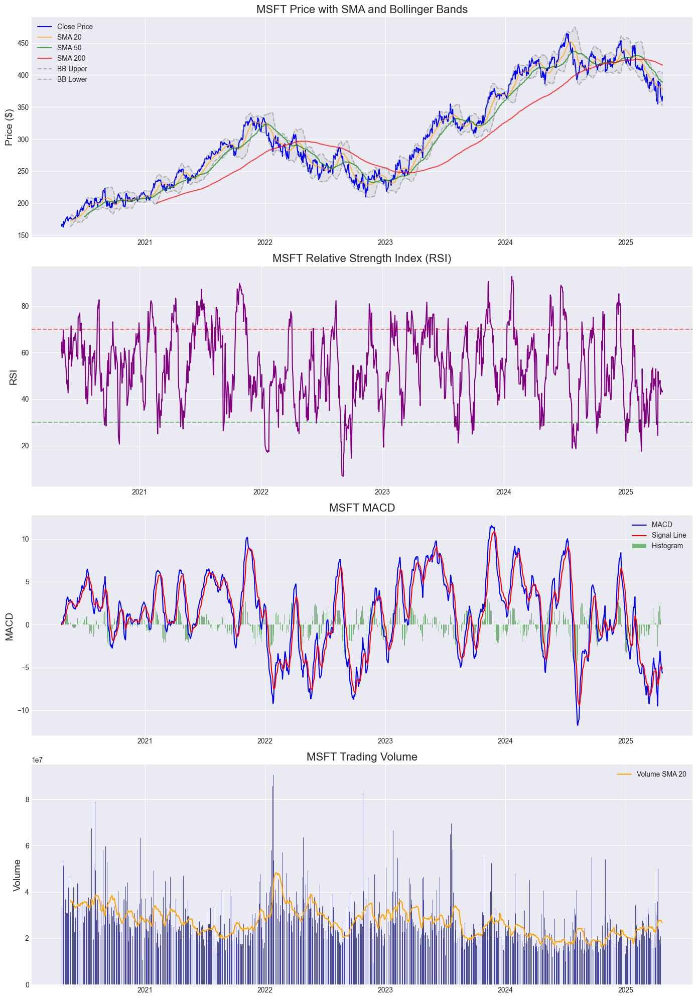

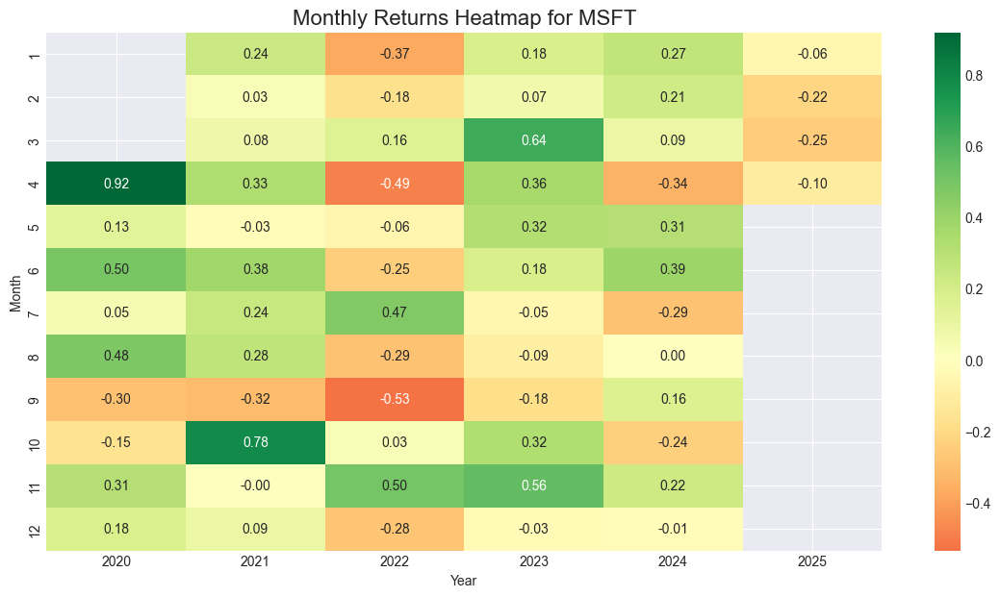

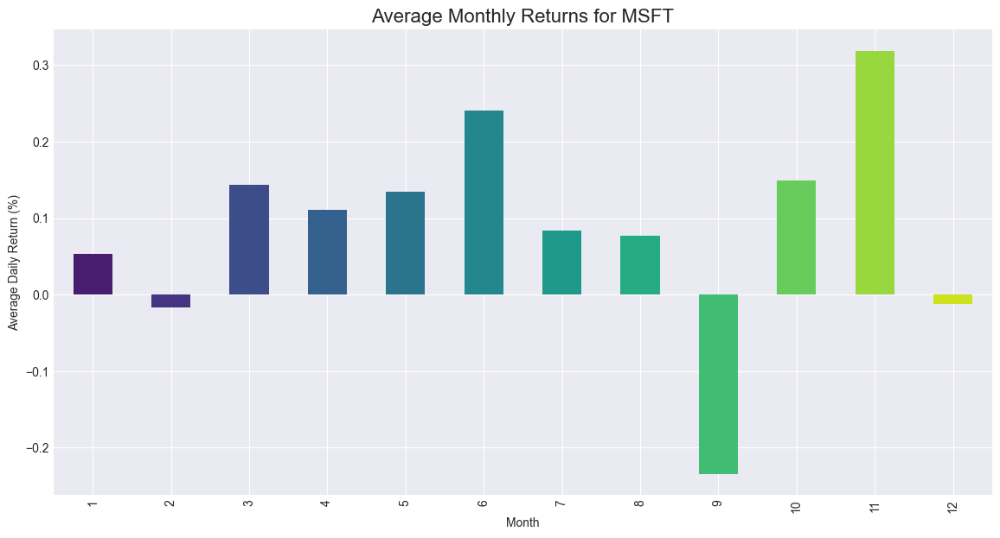

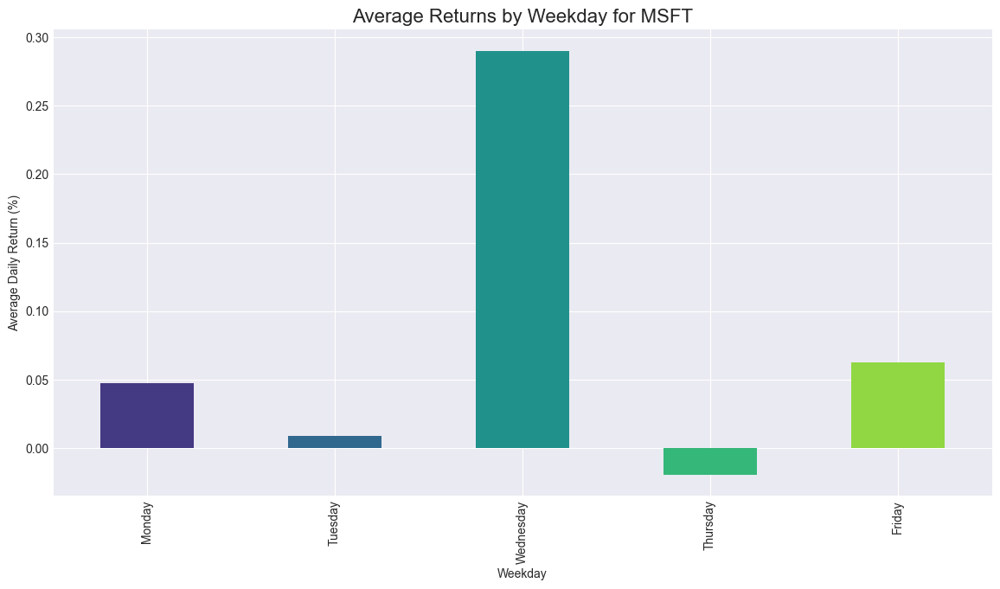

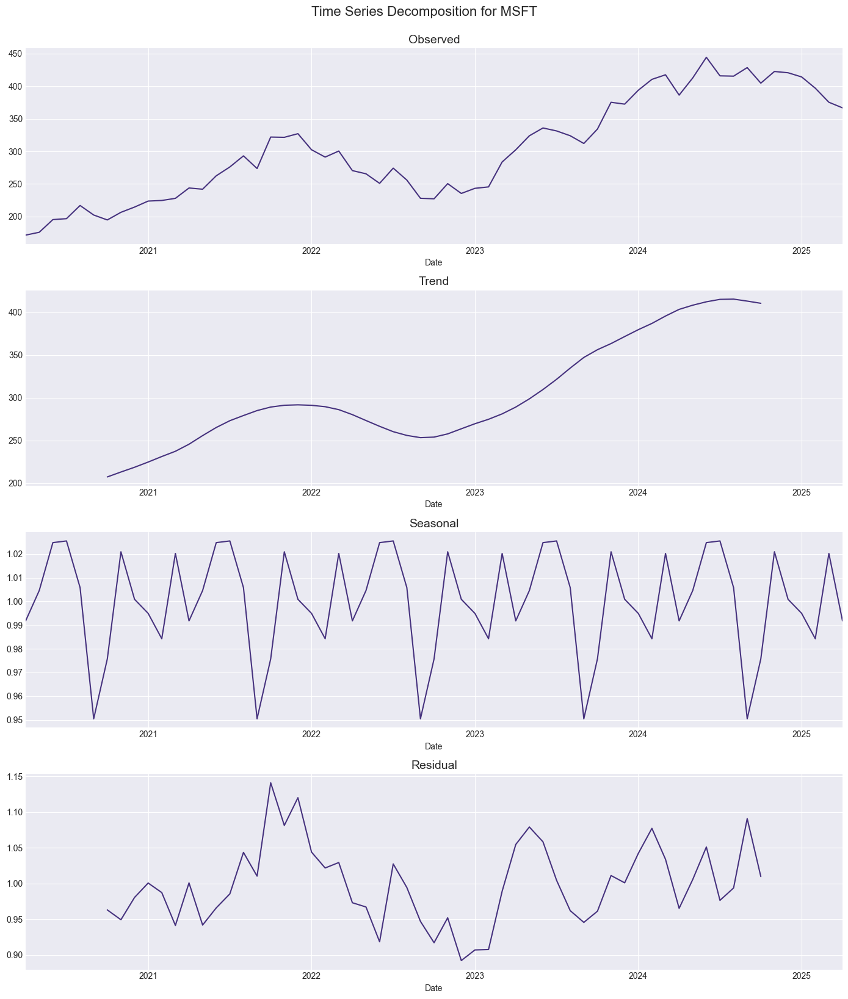

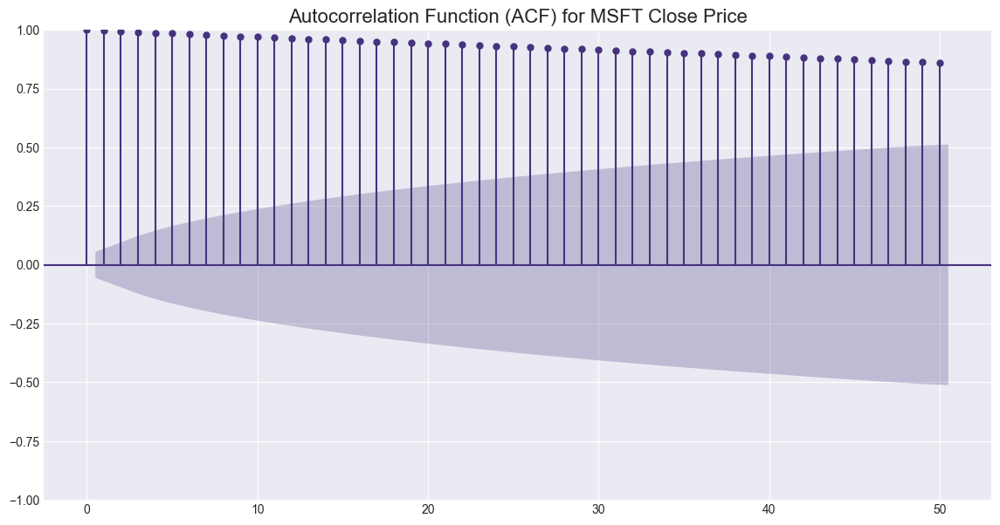

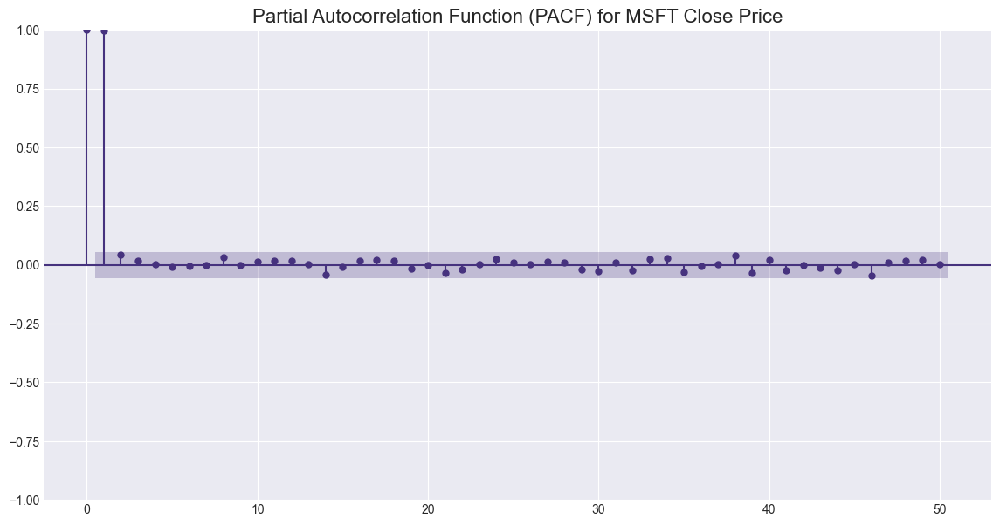


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.50      0.50      0.50       101
           1       0.54      0.53      0.54       111

    accuracy                           0.52       212
   macro avg       0.52      0.52      0.52       212
weighted avg       0.52      0.52      0.52       212



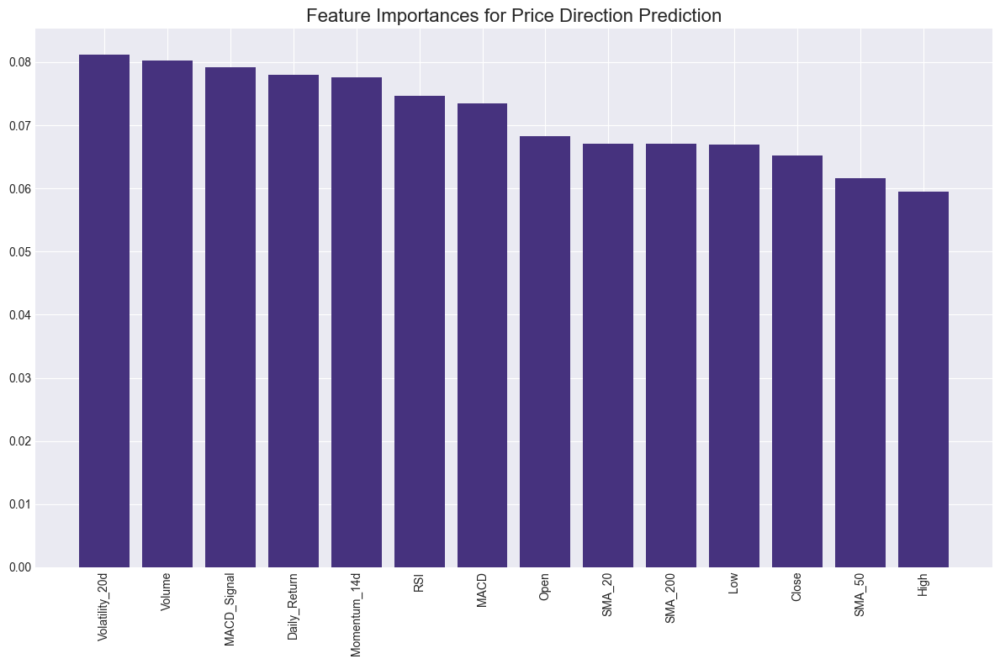


Saved processed data to MSFT_data.csv

Analyzing GOOG
Downloaded 1256 rows of data

Company Information:
Company: Alphabet Inc.
Sector: Communication Services
Industry: Internet Content & Information
Market Cap: $1,904,727,818,240
52-Week High: $208.7
52-Week Low: $142.66
Beta: 1.035
P/E Ratio: 19.118011

Price Statistics (Last 5 years):
Mean Close Price: $126.11
Standard Deviation: $32.74
Min Close Price: $61.39
Max Close Price: $207.47
Current Close Price: $153.90

Return Statistics:
Mean Daily Return: 0.0896%
Daily Return Std Dev: 1.9547%
Min Daily Return: -9.6350%
Max Daily Return: 9.9652%
Annualized Return: 25.33%
Annualized Volatility: 31.03%
Sharpe Ratio (Risk-free rate = 0%): 0.8162


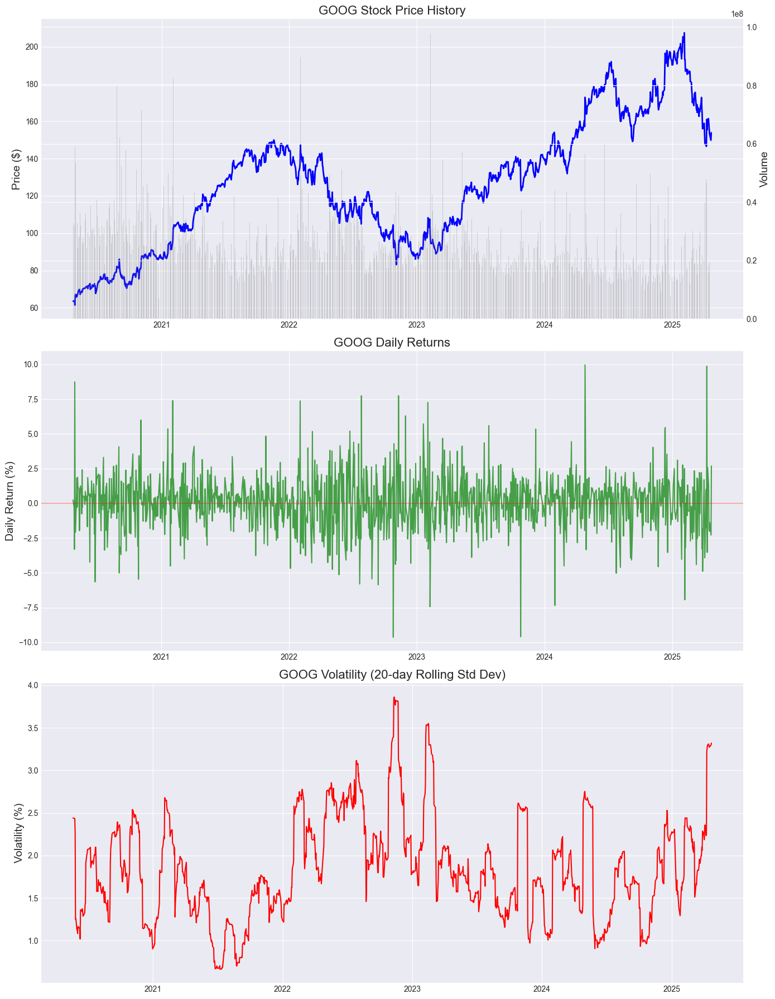

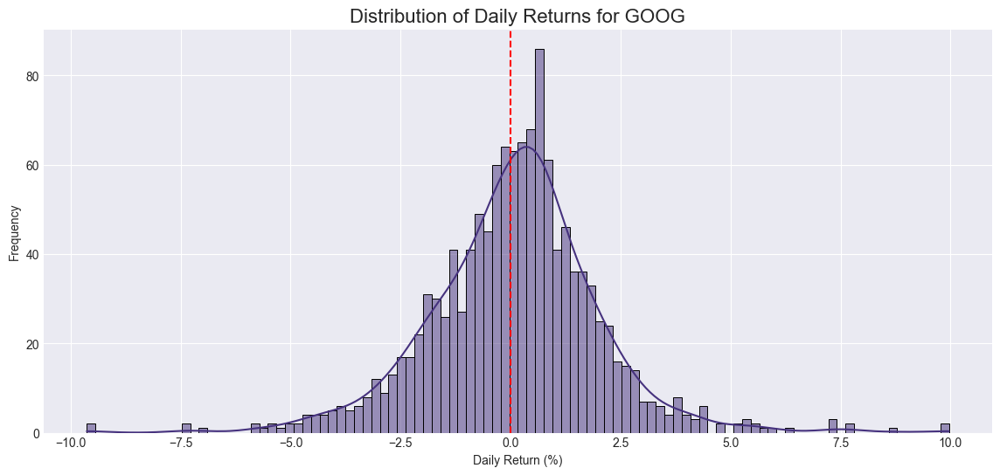

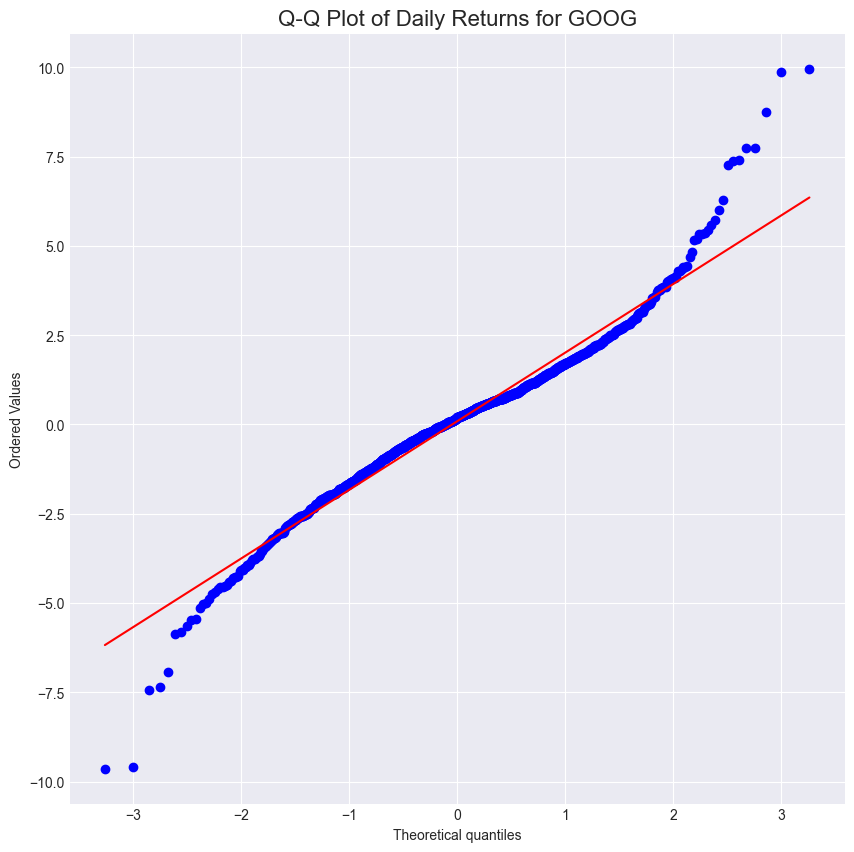

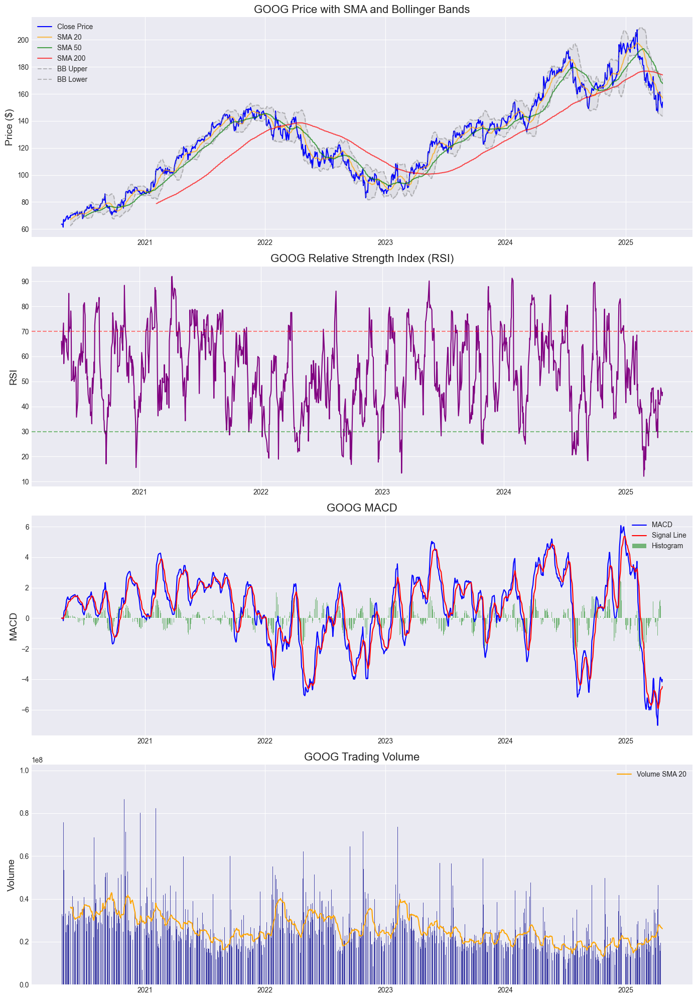

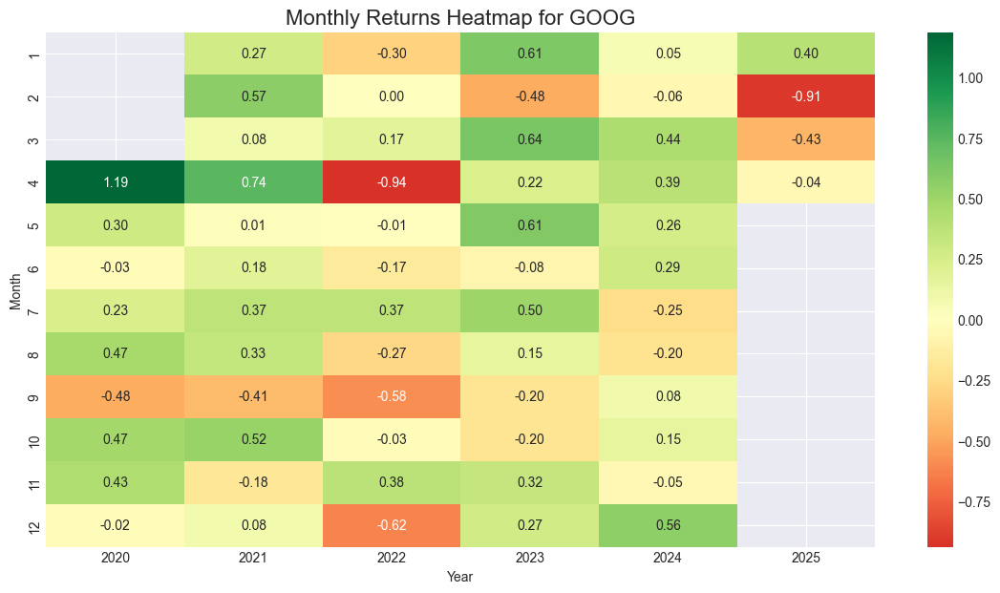

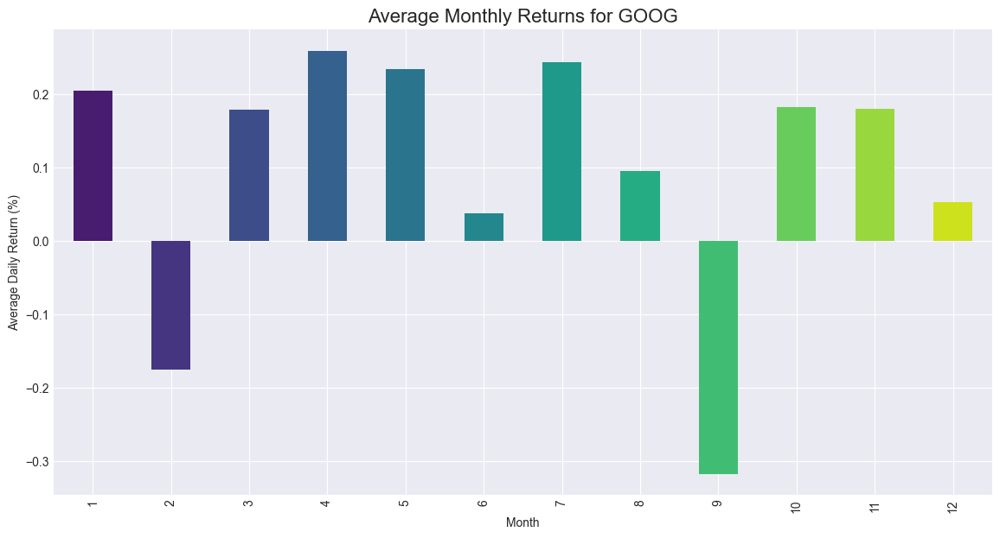

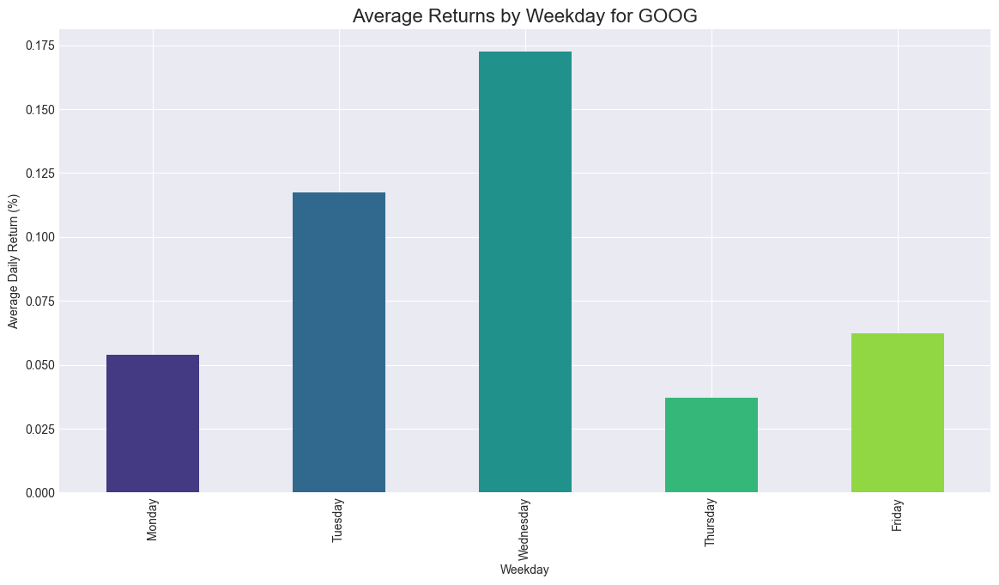

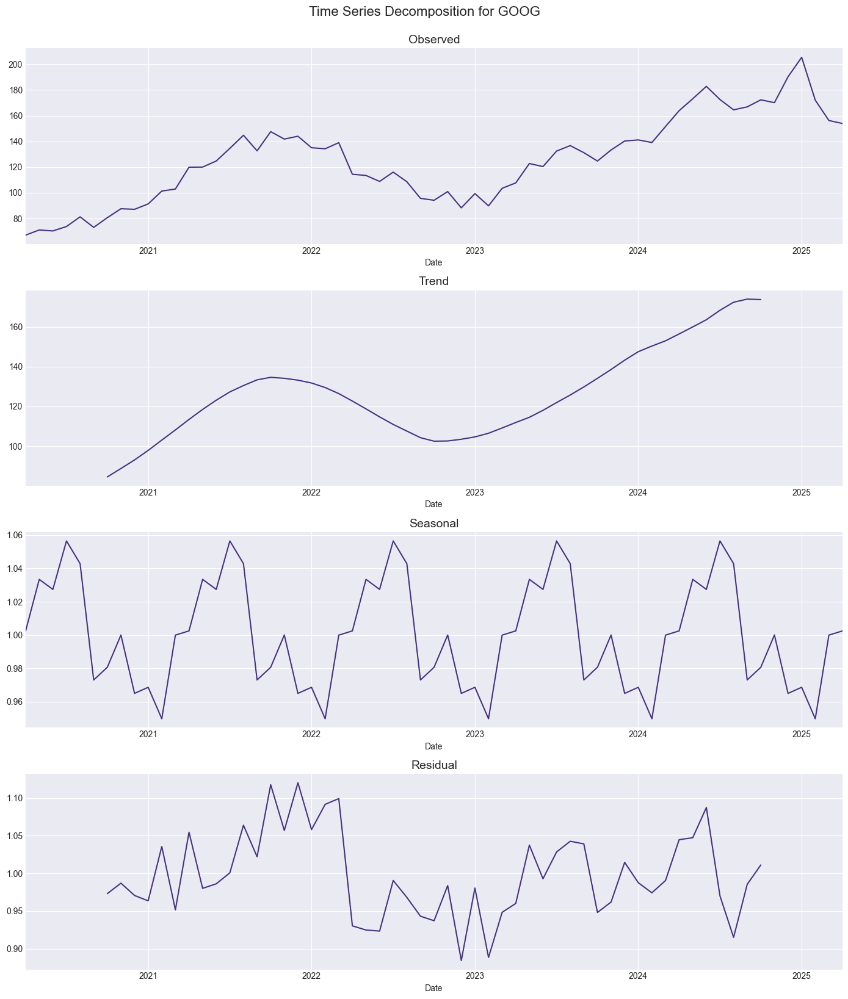

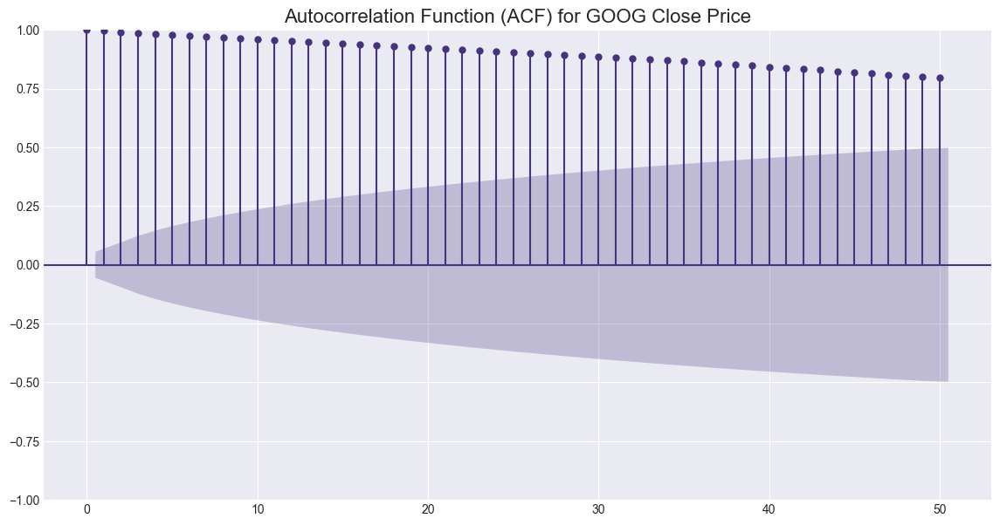

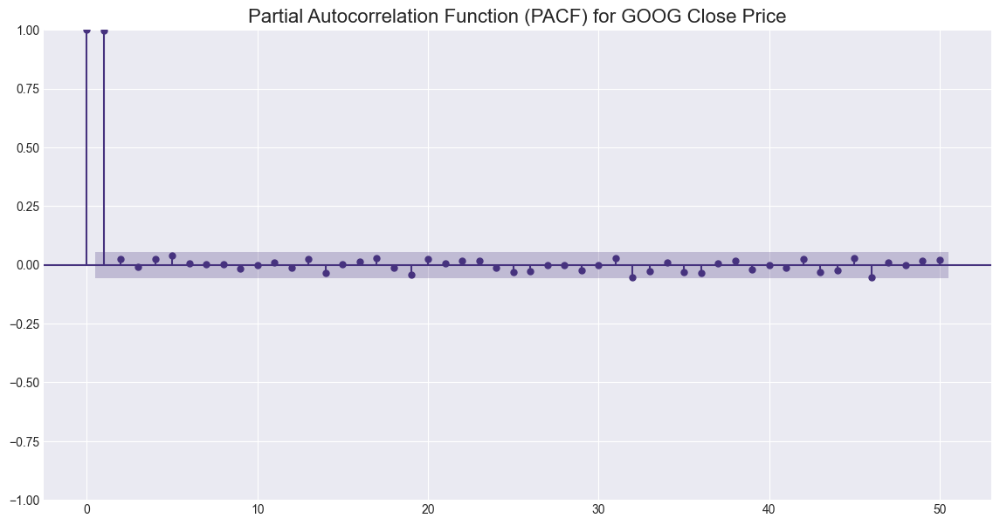


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.47      0.46      0.46        92
           1       0.59      0.60      0.60       120

    accuracy                           0.54       212
   macro avg       0.53      0.53      0.53       212
weighted avg       0.54      0.54      0.54       212



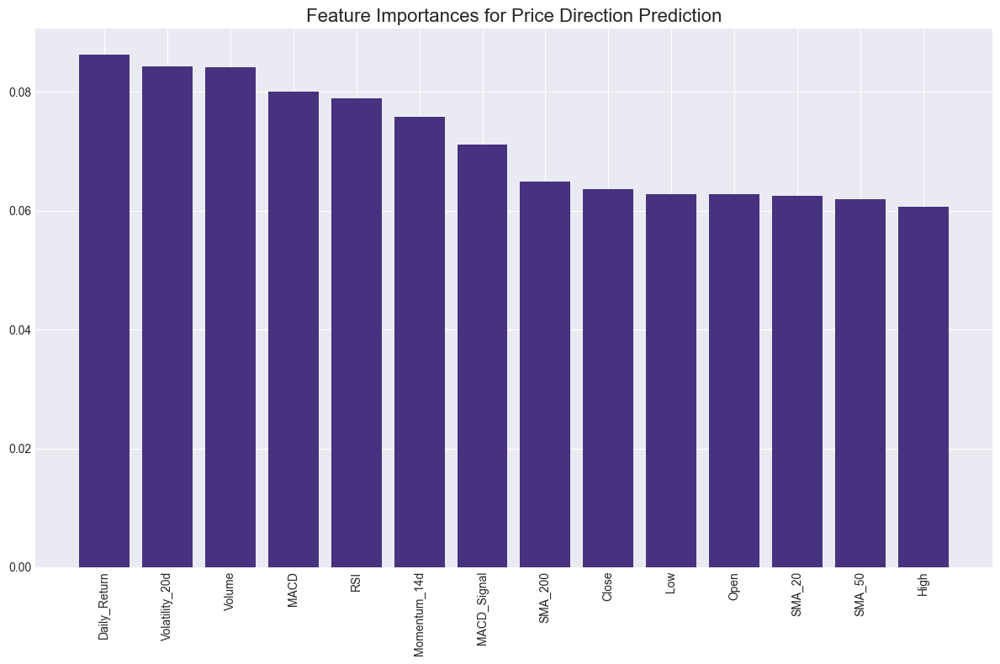


Saved processed data to GOOG_data.csv

Analyzing GOOGL
Downloaded 1256 rows of data

Company Information:
Company: Alphabet Inc.
Sector: Communication Services
Industry: Internet Content & Information
Market Cap: $1,902,463,156,224
52-Week High: $207.05
52-Week Low: $140.53
Beta: 1.035
P/E Ratio: 18.863014

Price Statistics (Last 5 years):
Mean Close Price: $125.17
Standard Deviation: $32.31
Min Close Price: $61.34
Max Close Price: $206.14
Current Close Price: $151.47

Return Statistics:
Mean Daily Return: 0.0888%
Daily Return Std Dev: 1.9597%
Min Daily Return: -9.5094%
Max Daily Return: 10.2244%
Annualized Return: 25.06%
Annualized Volatility: 31.11%
Sharpe Ratio (Risk-free rate = 0%): 0.8055


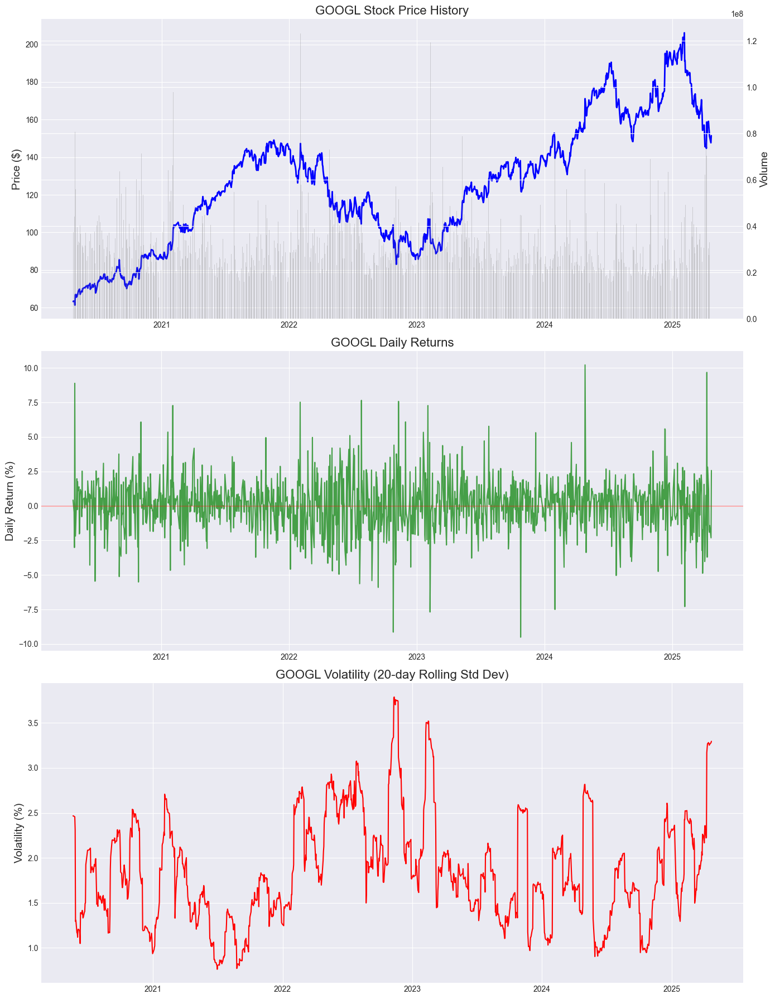

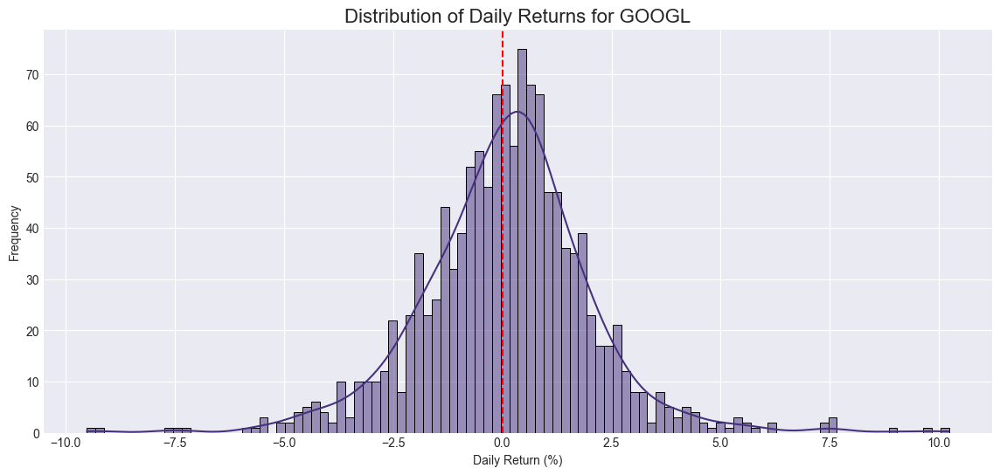

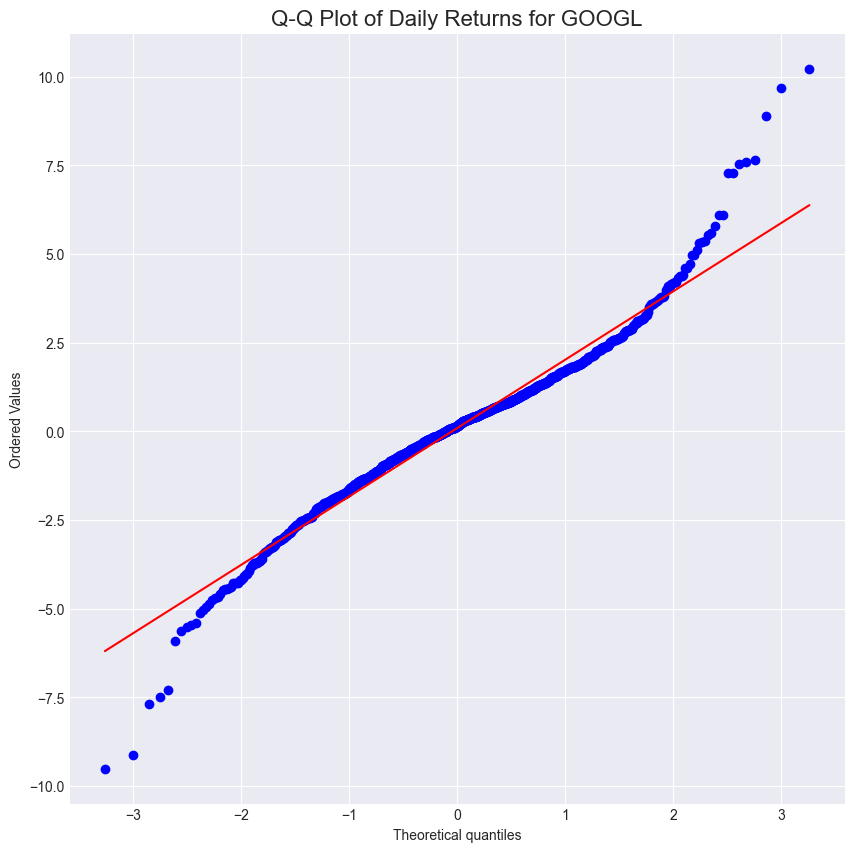

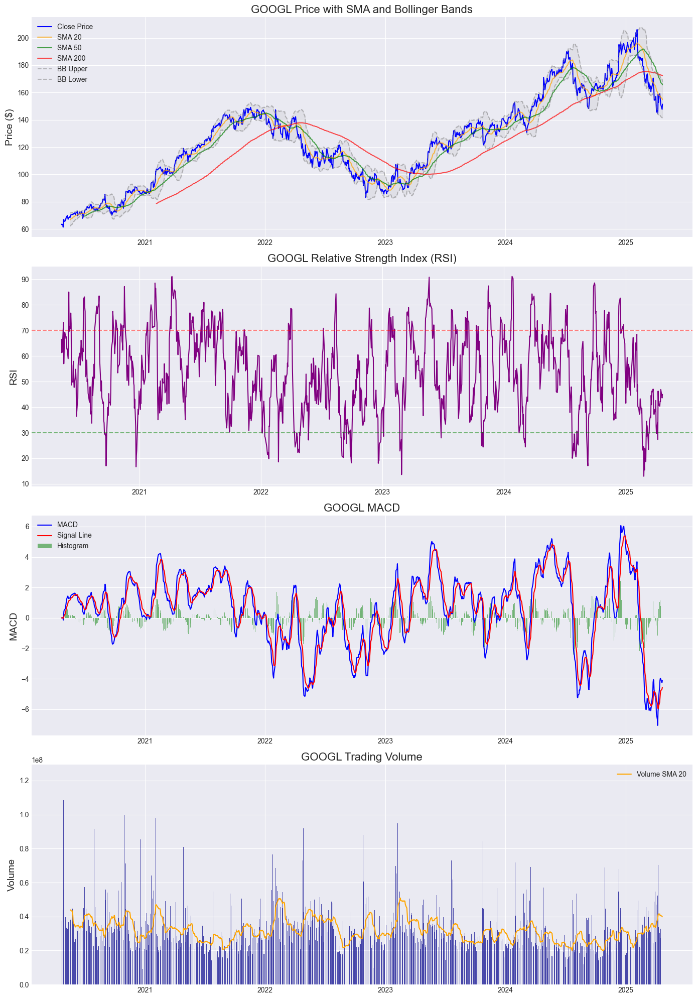

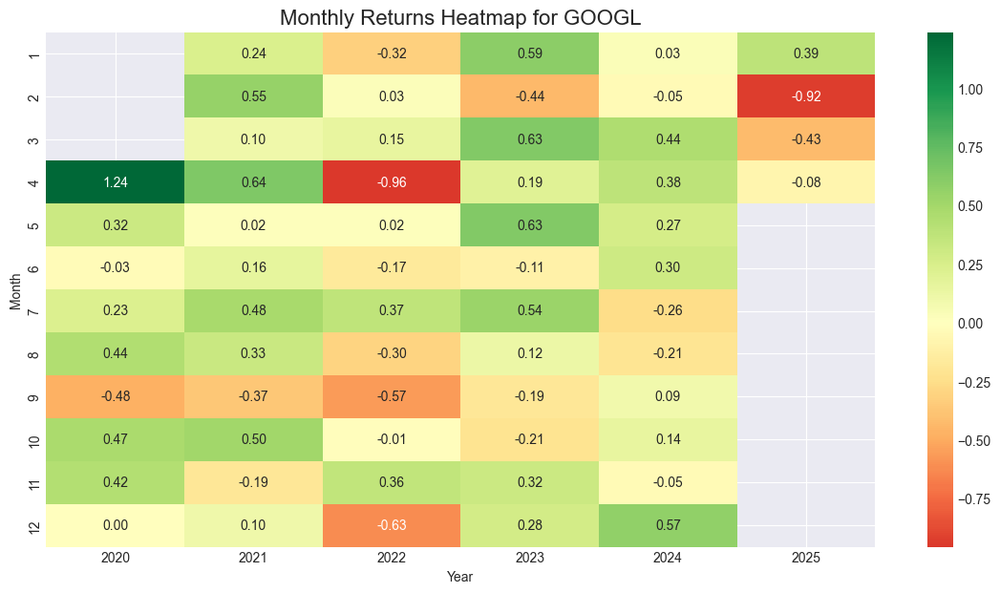

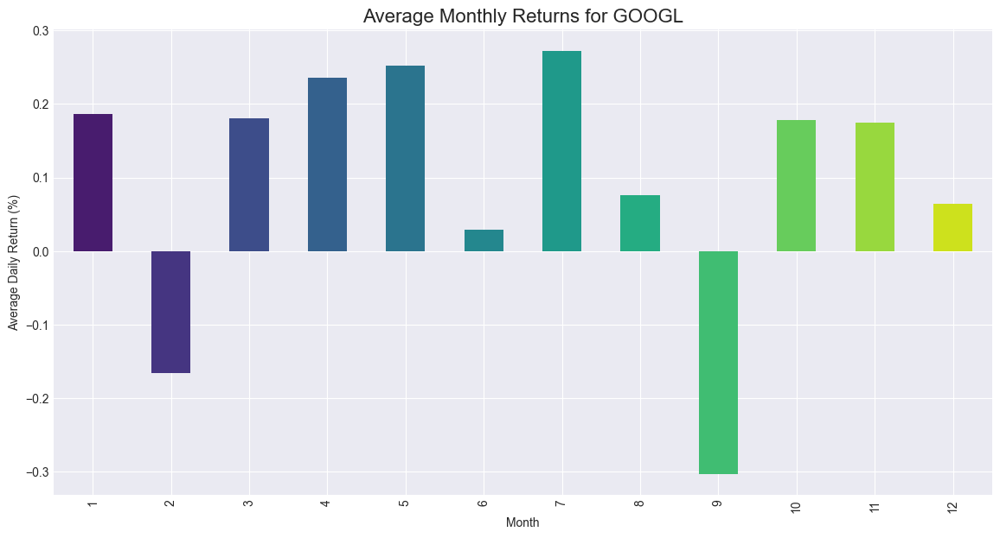

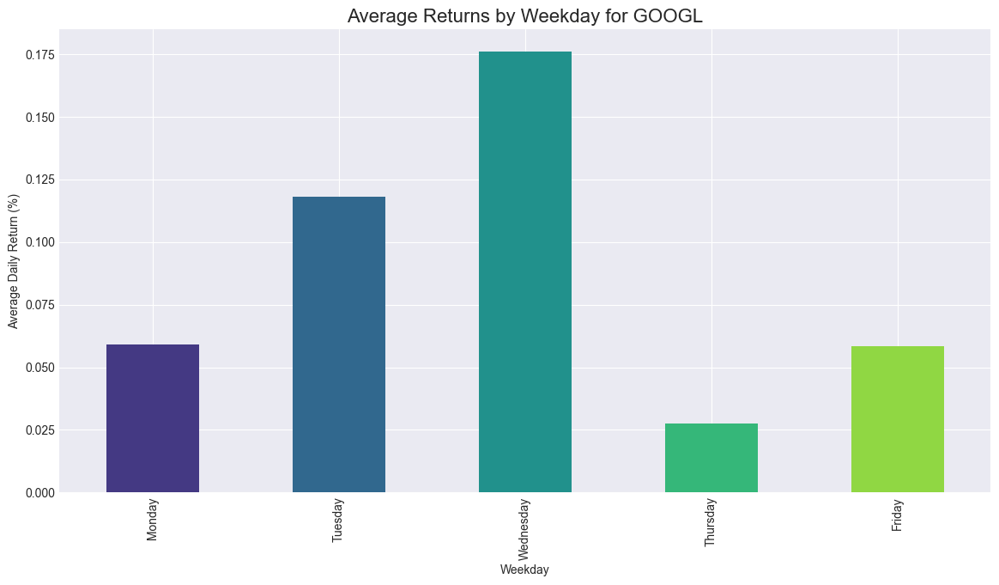

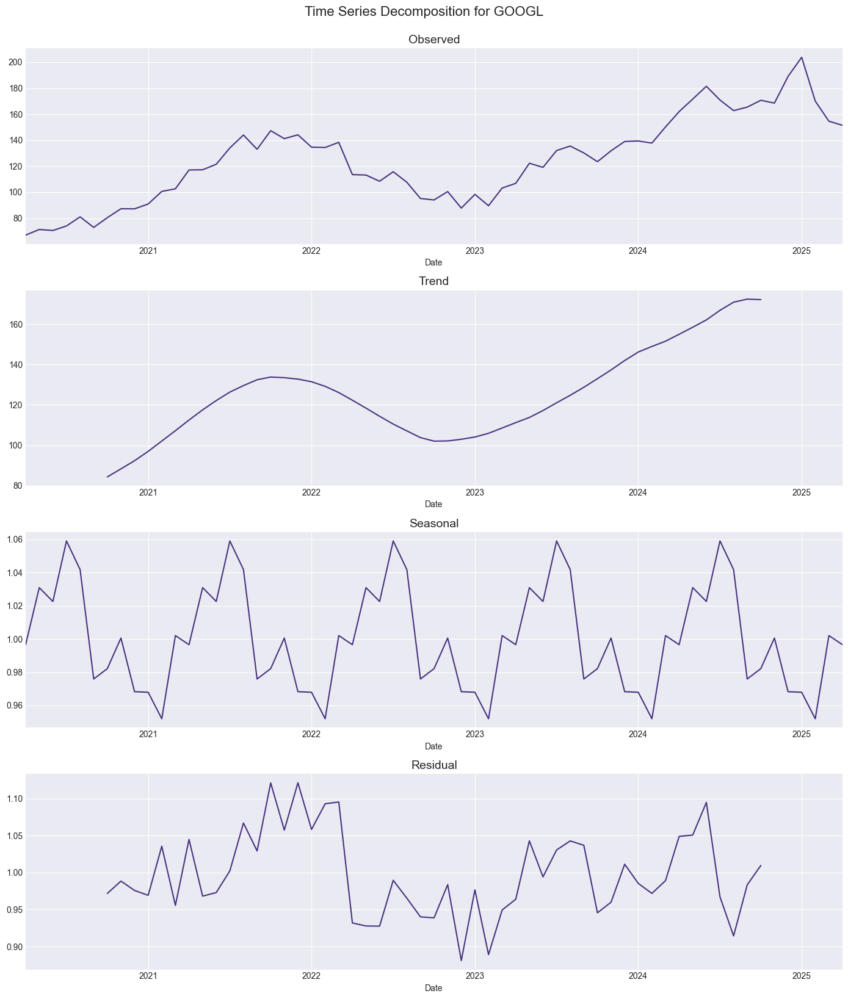

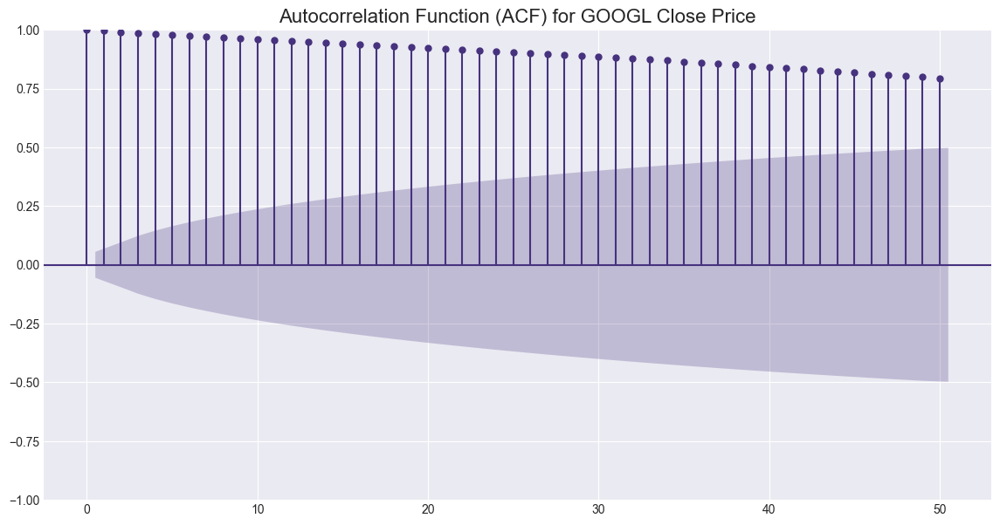

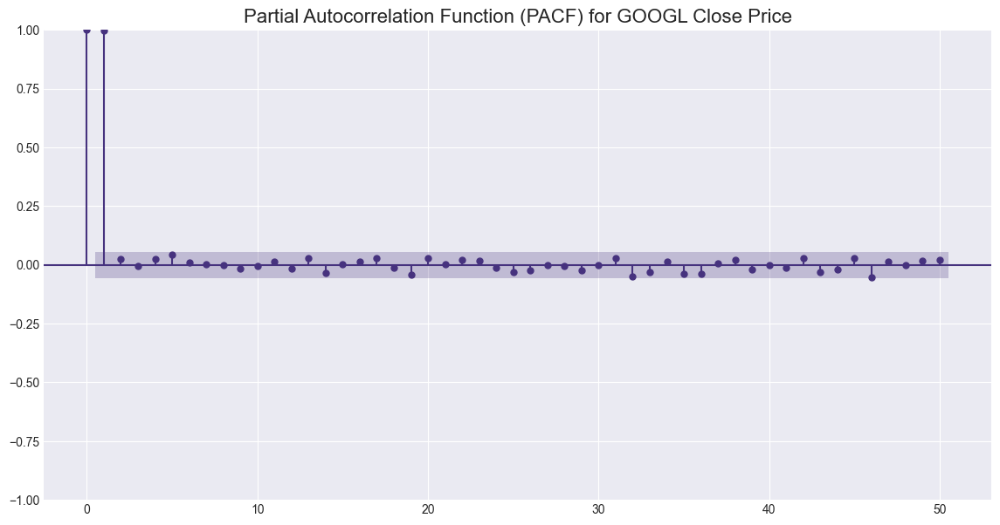


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.42      0.42      0.42        93
           1       0.55      0.55      0.55       119

    accuracy                           0.49       212
   macro avg       0.48      0.48      0.48       212
weighted avg       0.49      0.49      0.49       212



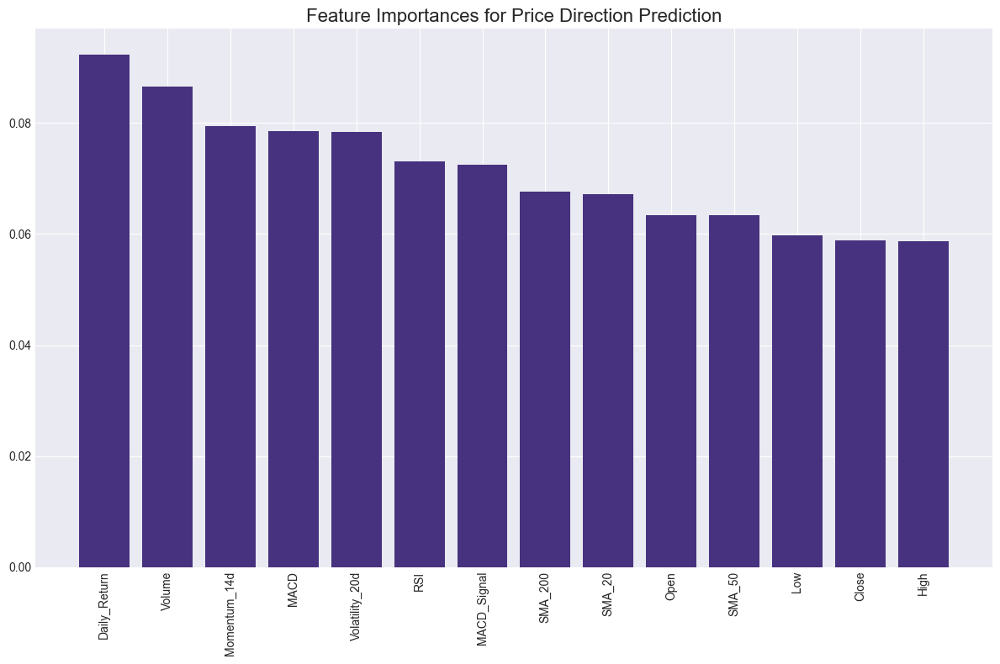


Saved processed data to GOOGL_data.csv

Analyzing AMZN
Downloaded 1256 rows of data

Company Information:
Company: Amazon.com, Inc.
Sector: Consumer Cyclical
Industry: Internet Retail
Market Cap: $1,895,957,266,432
52-Week High: $242.52
52-Week Low: $151.61
Beta: 1.393
P/E Ratio: 31.259926

Price Statistics (Last 5 years):
Mean Close Price: $153.39
Standard Deviation: $33.15
Min Close Price: $81.82
Max Close Price: $242.06
Current Close Price: $173.18

Return Statistics:
Mean Daily Return: 0.0545%
Daily Return Std Dev: 2.2491%
Min Daily Return: -14.0494%
Max Daily Return: 13.5359%
Annualized Return: 14.72%
Annualized Volatility: 35.70%
Sharpe Ratio (Risk-free rate = 0%): 0.4123


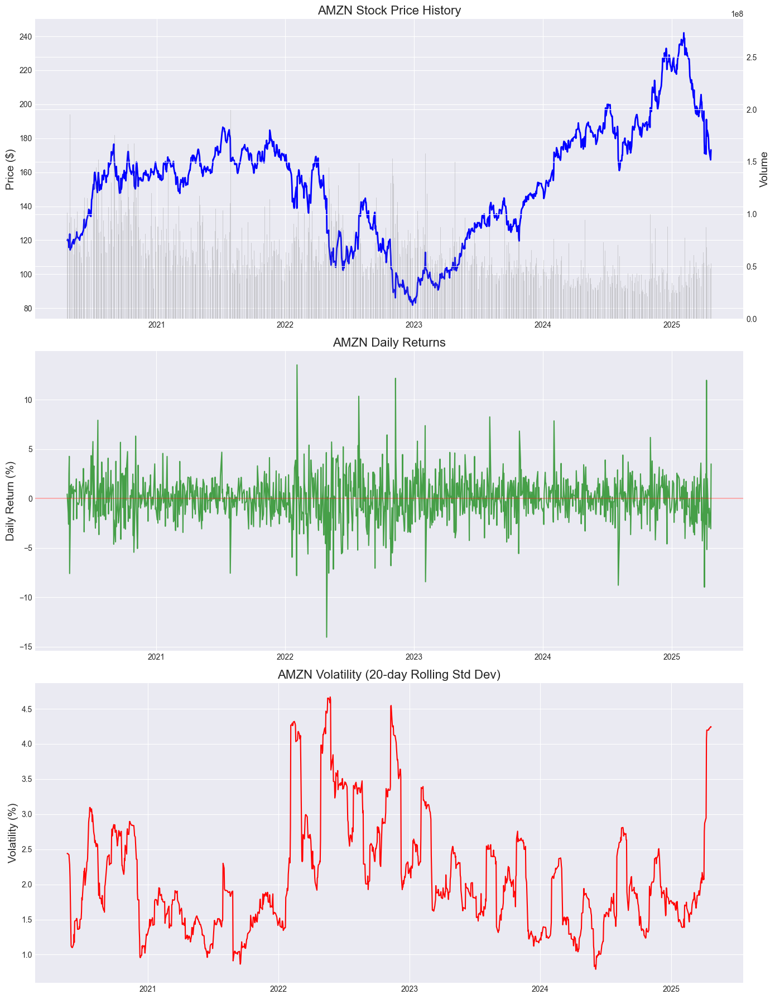

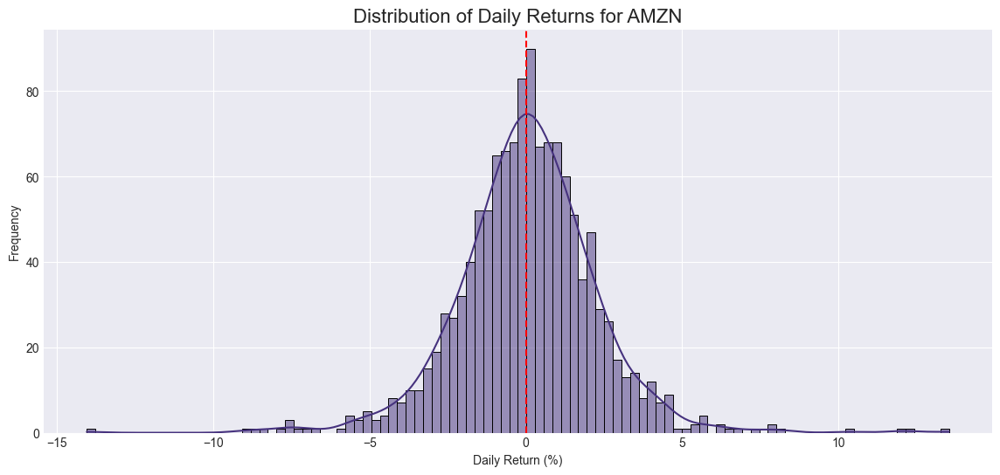

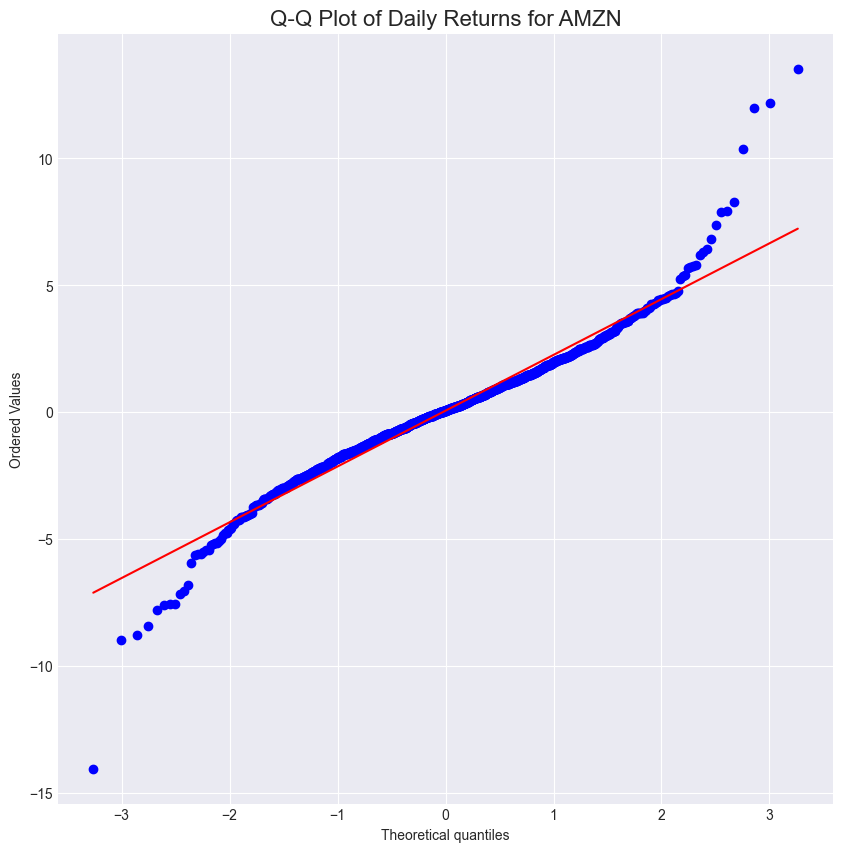

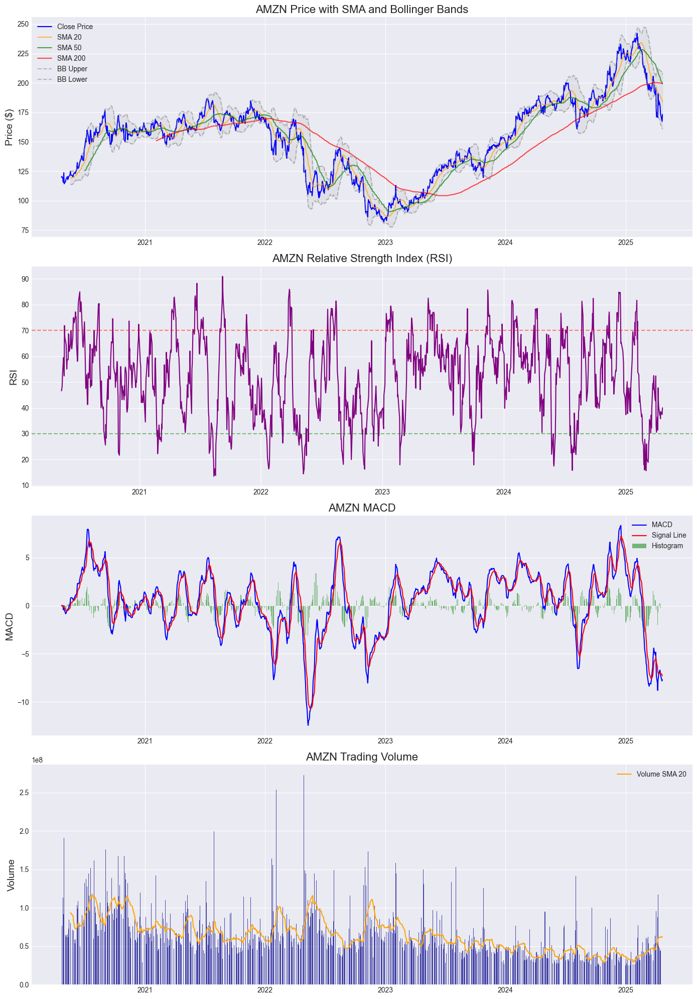

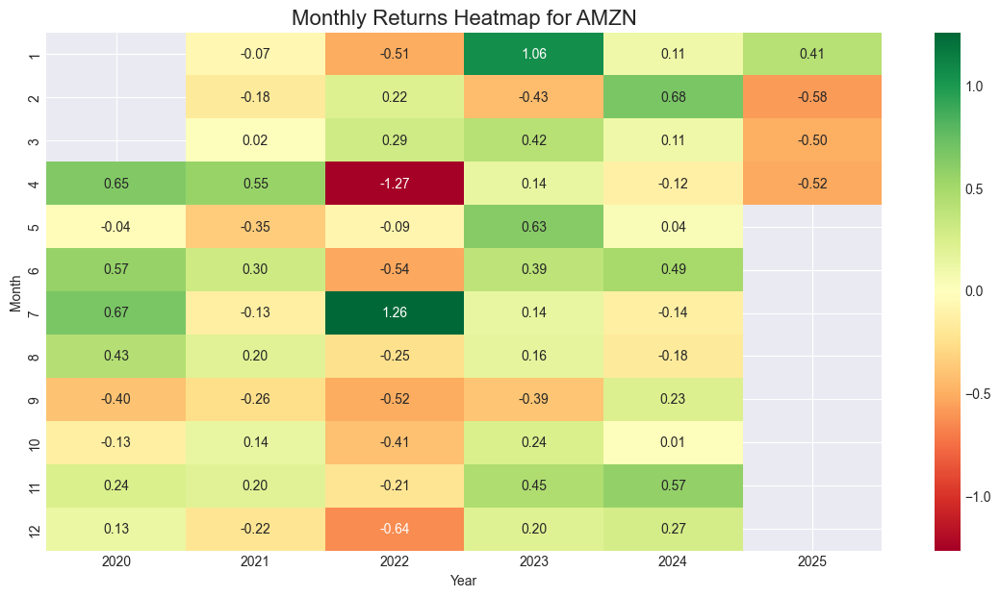

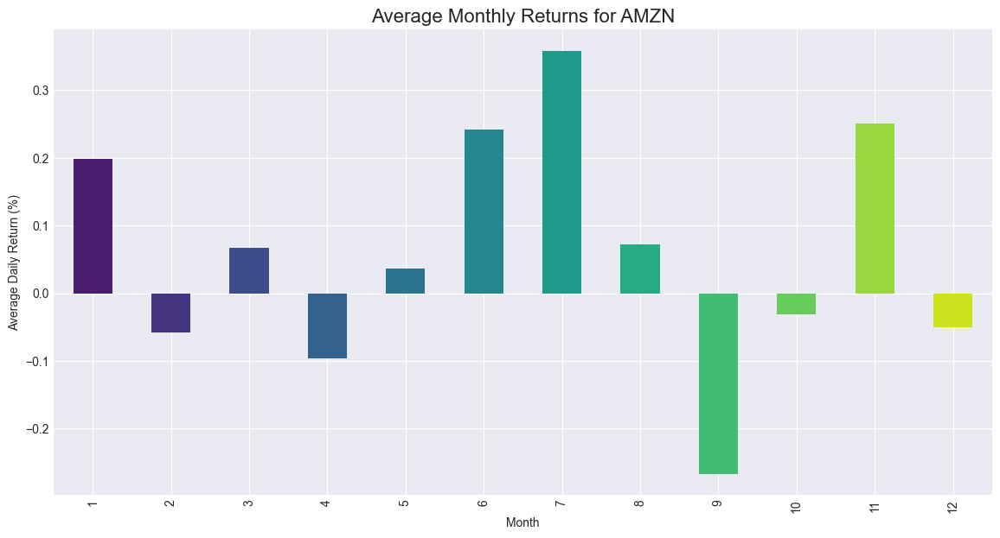

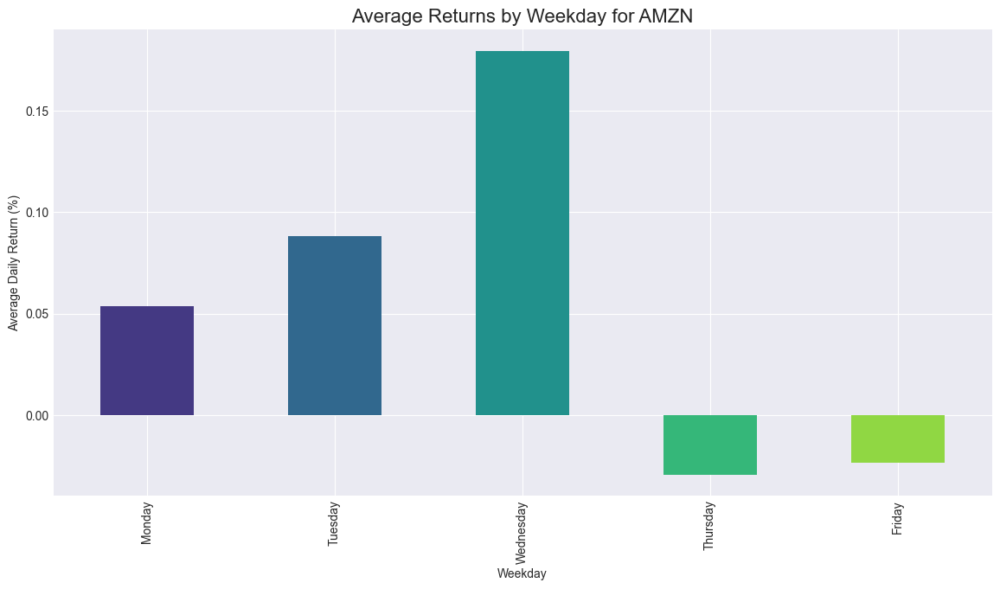

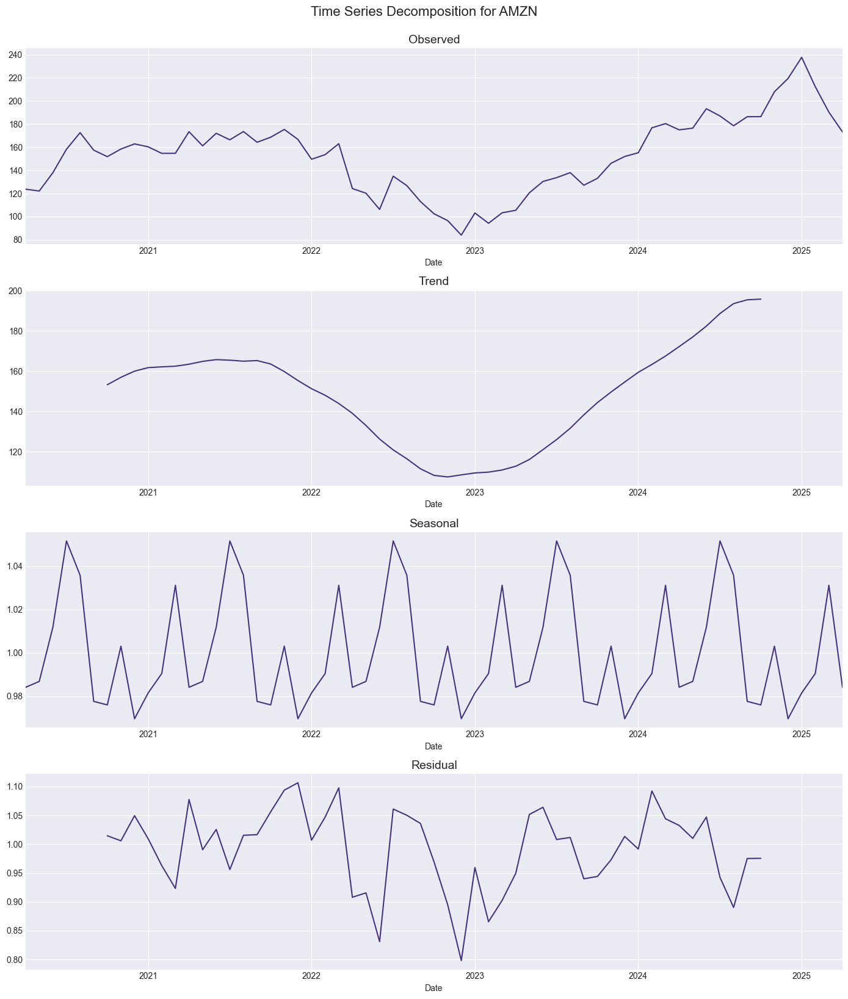

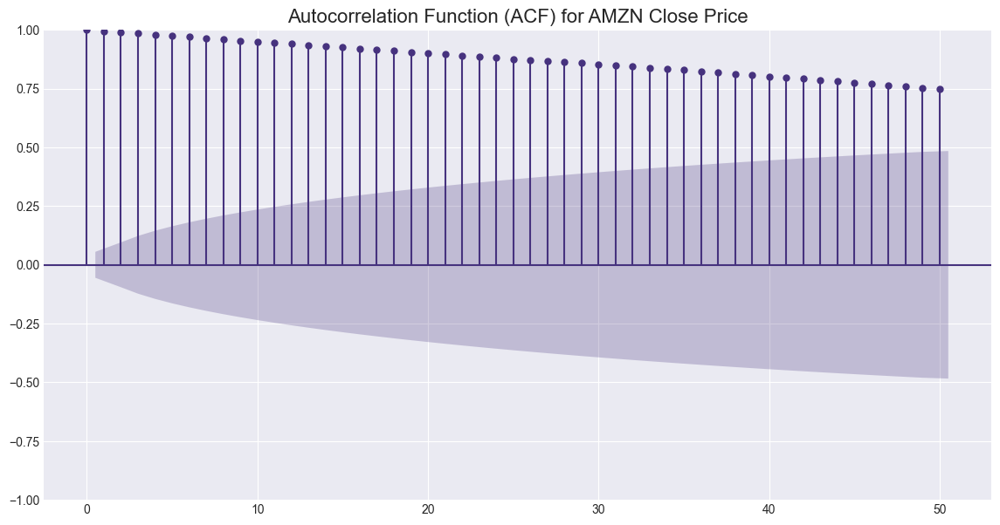

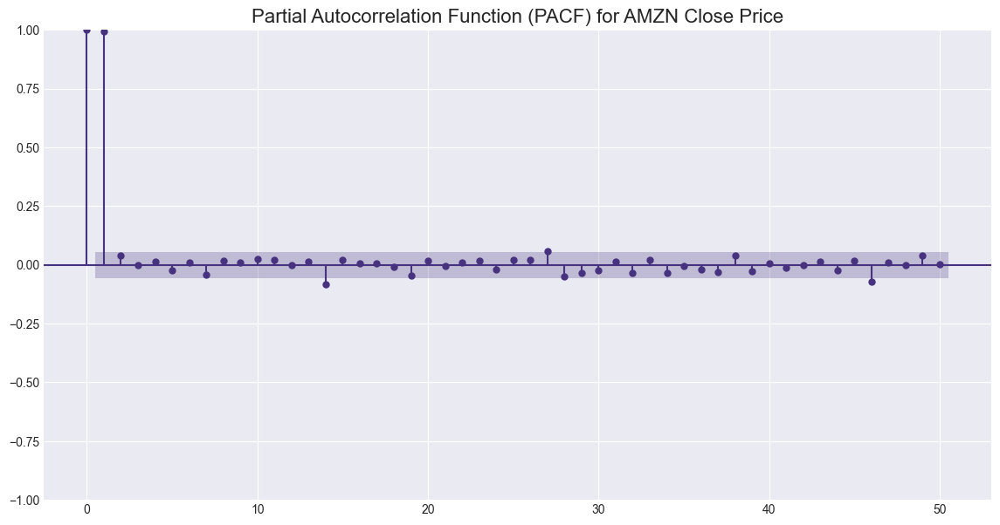


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.51      0.44      0.47       107
           1       0.50      0.57      0.53       105

    accuracy                           0.50       212
   macro avg       0.51      0.51      0.50       212
weighted avg       0.51      0.50      0.50       212



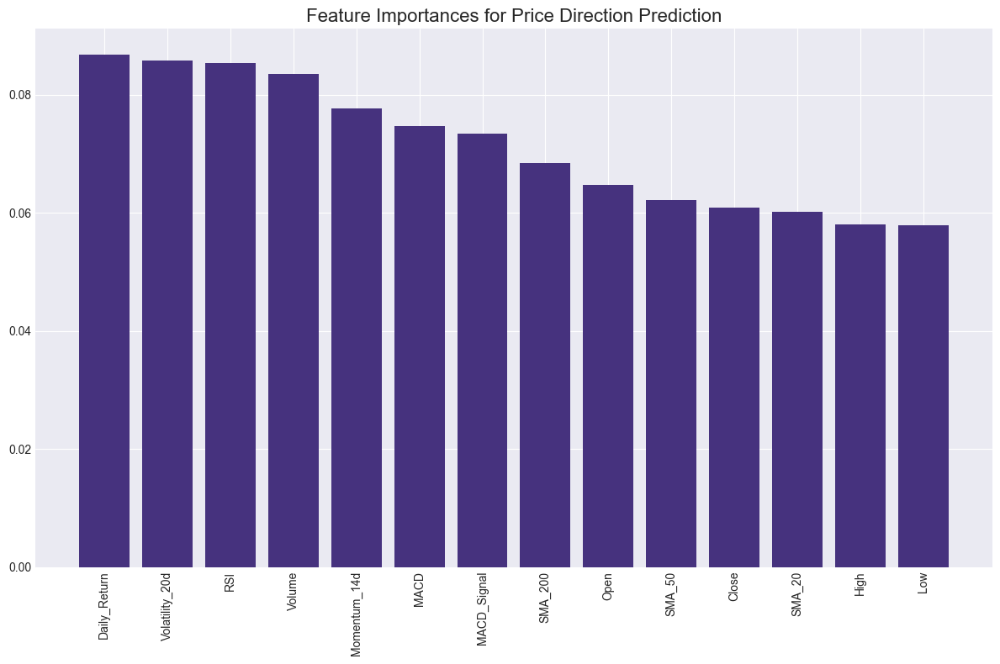


Saved processed data to AMZN_data.csv

Analyzing ABBV
Downloaded 1256 rows of data

Company Information:
Company: AbbVie Inc.
Sector: Healthcare
Industry: Drug Manufacturers - General
Market Cap: $312,525,946,880
52-Week High: $218.66
52-Week Low: $153.58
Beta: 0.538
P/E Ratio: 73.0168

Price Statistics (Last 5 years):
Mean Close Price: $130.25
Standard Deviation: $35.57
Min Close Price: $66.70
Max Close Price: $214.68
Current Close Price: $173.78

Return Statistics:
Mean Daily Return: 0.0864%
Daily Return Std Dev: 1.4244%
Min Daily Return: -12.5664%
Max Daily Return: 7.4352%
Annualized Return: 24.31%
Annualized Volatility: 22.61%
Sharpe Ratio (Risk-free rate = 0%): 1.0751


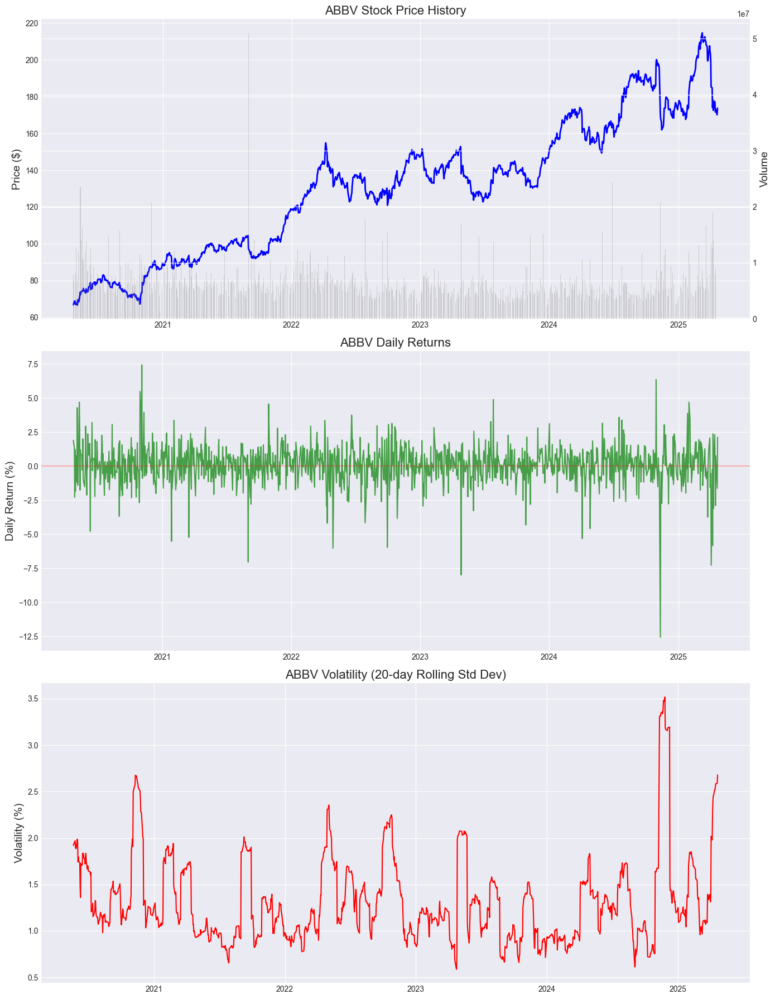

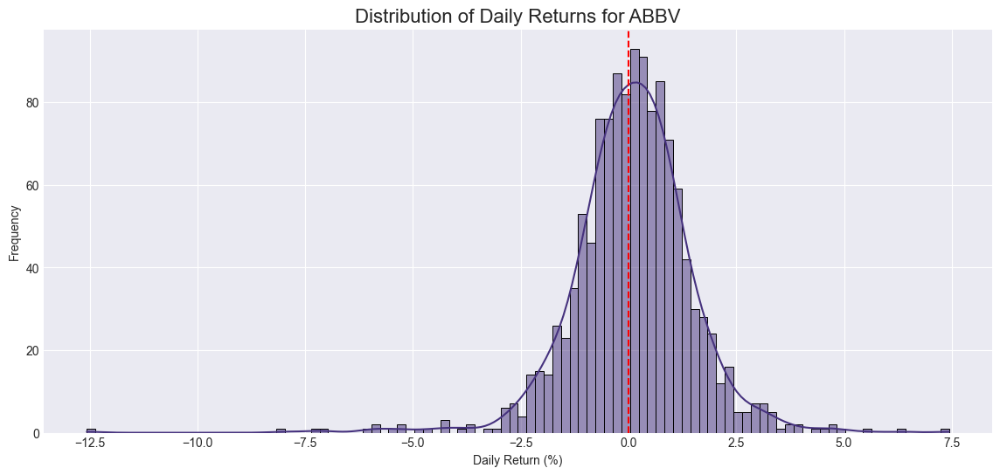

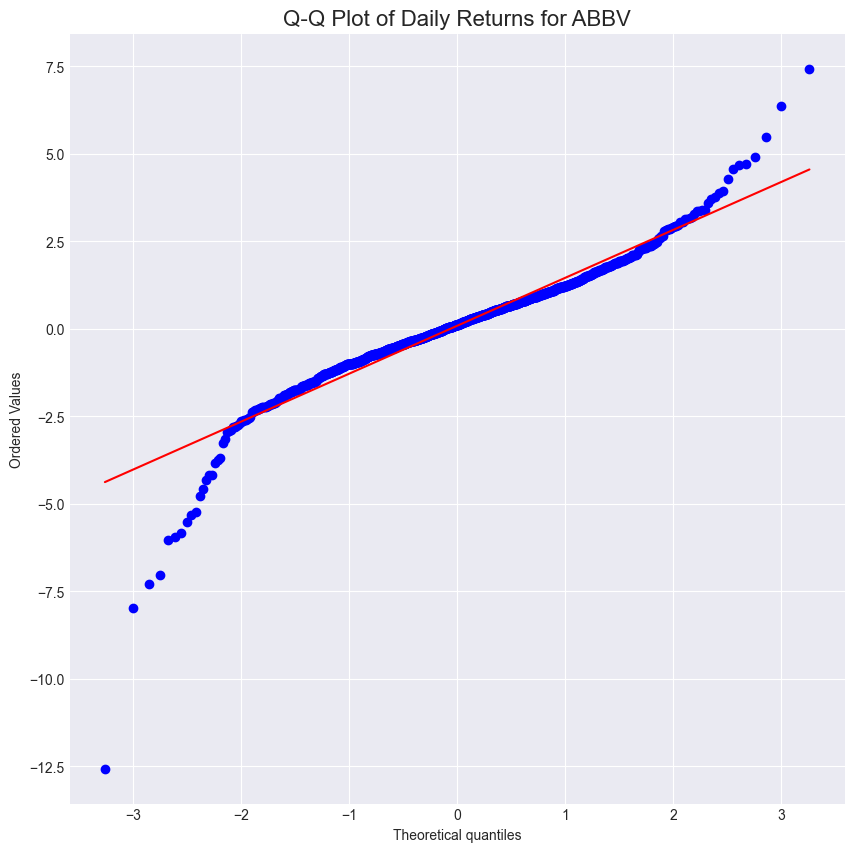

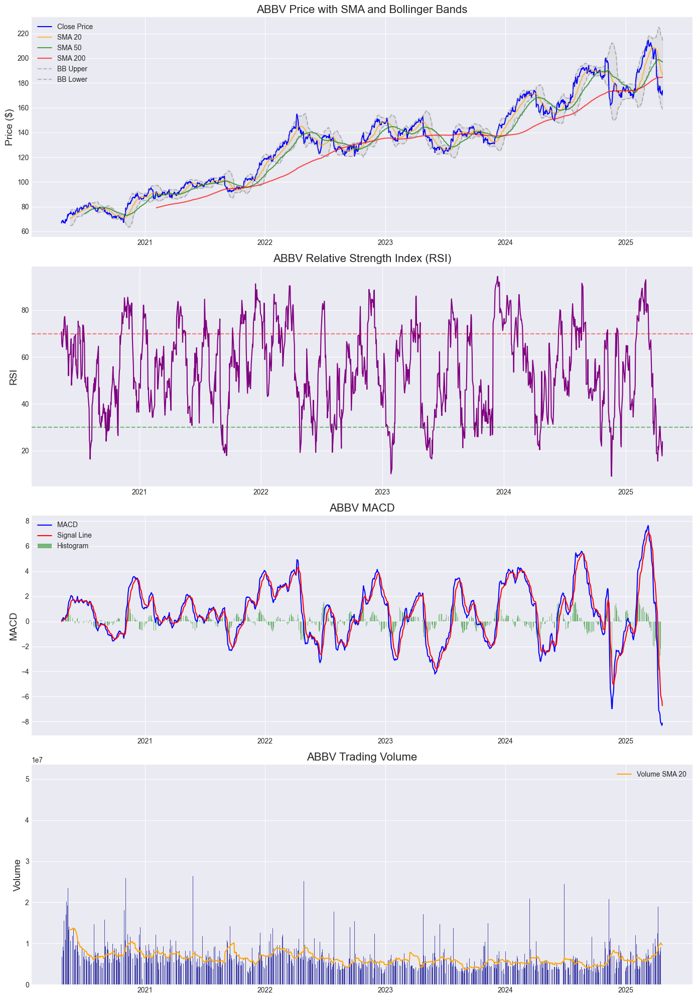

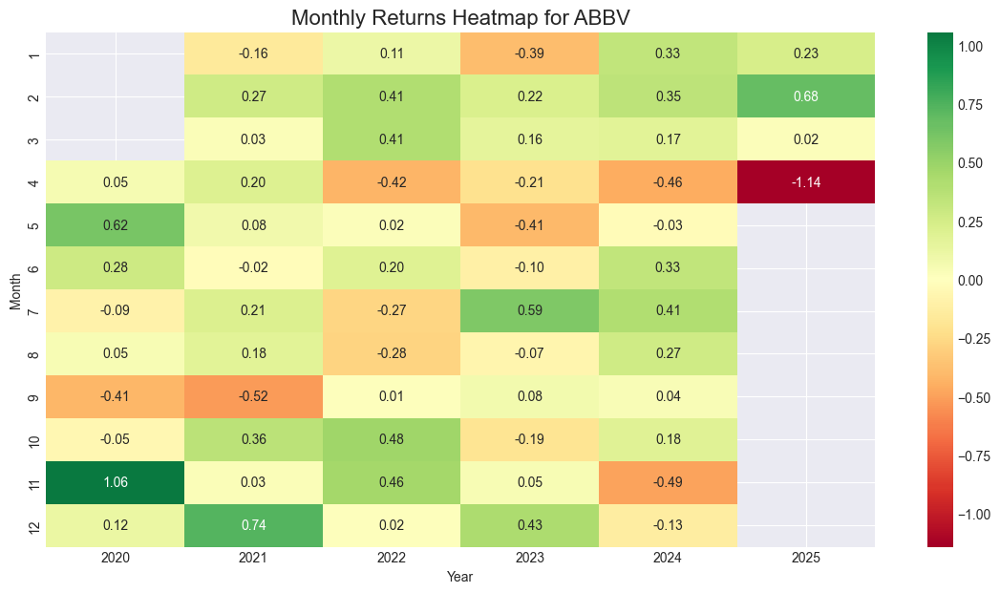

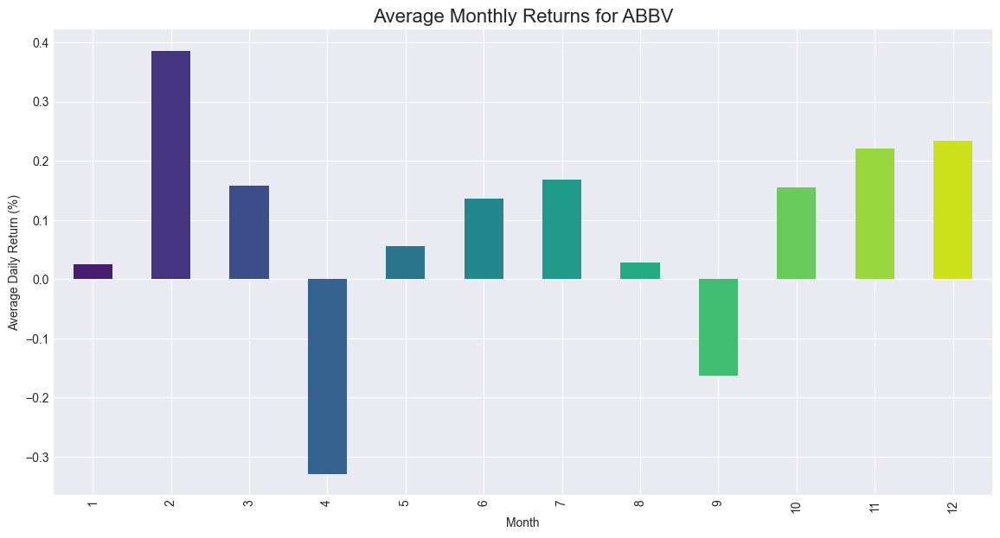

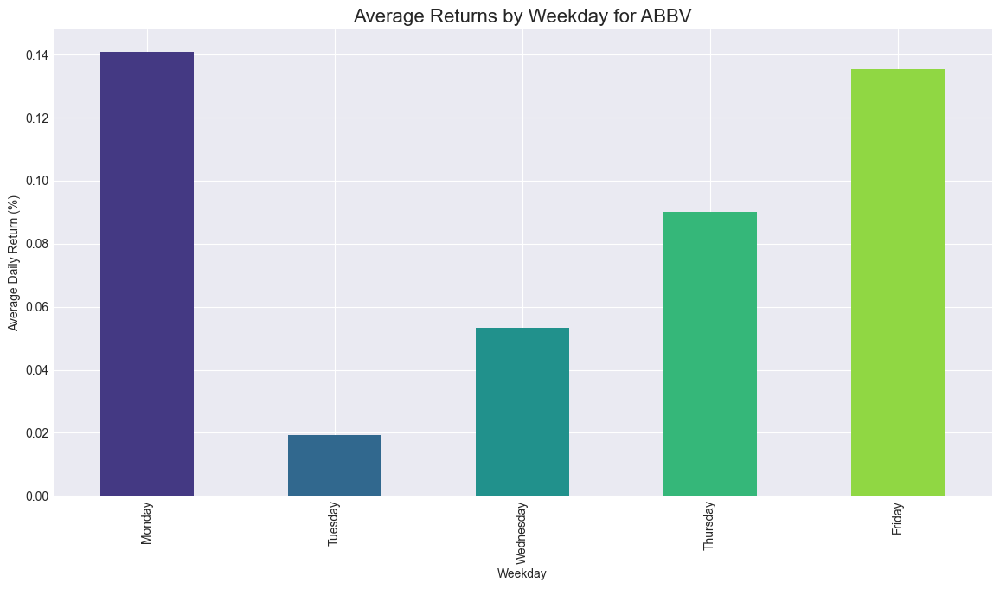

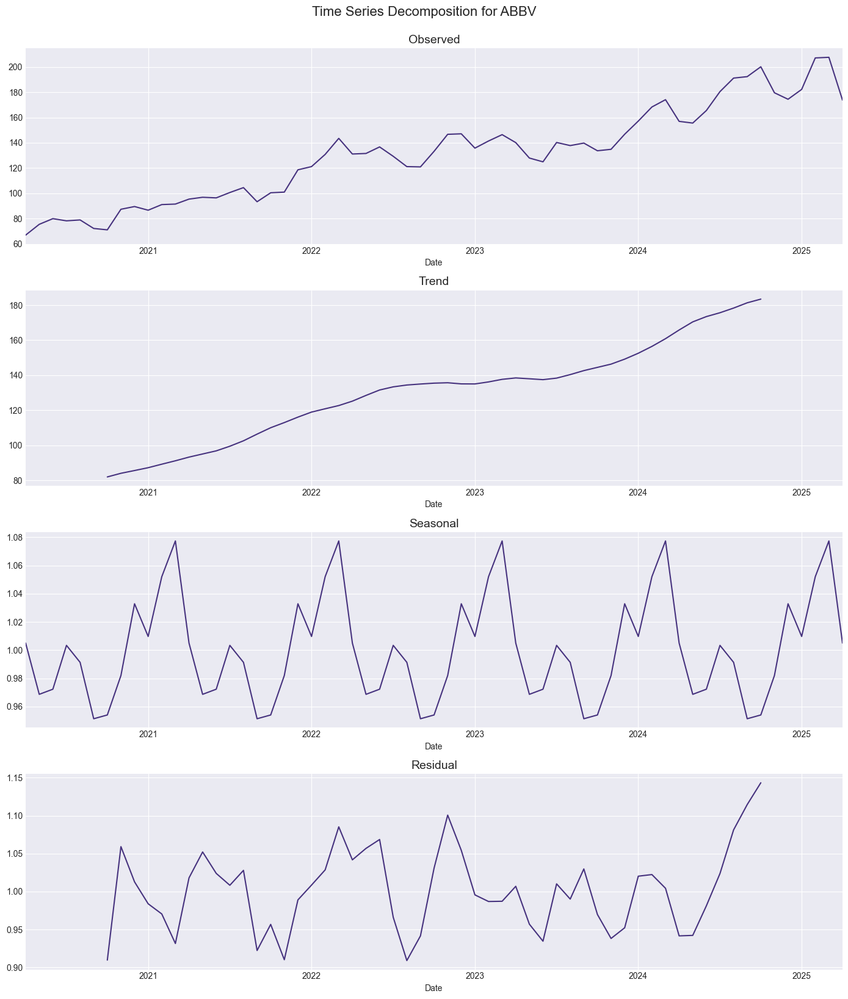

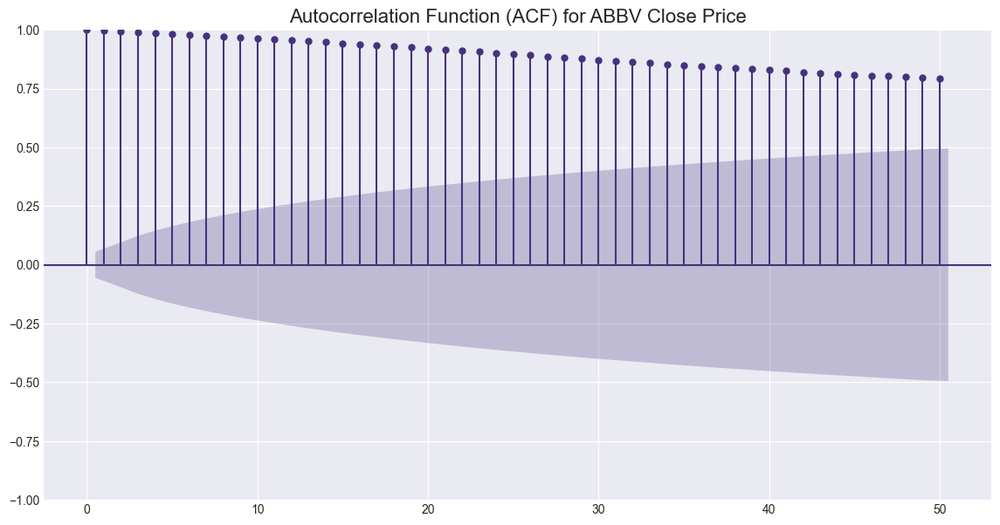

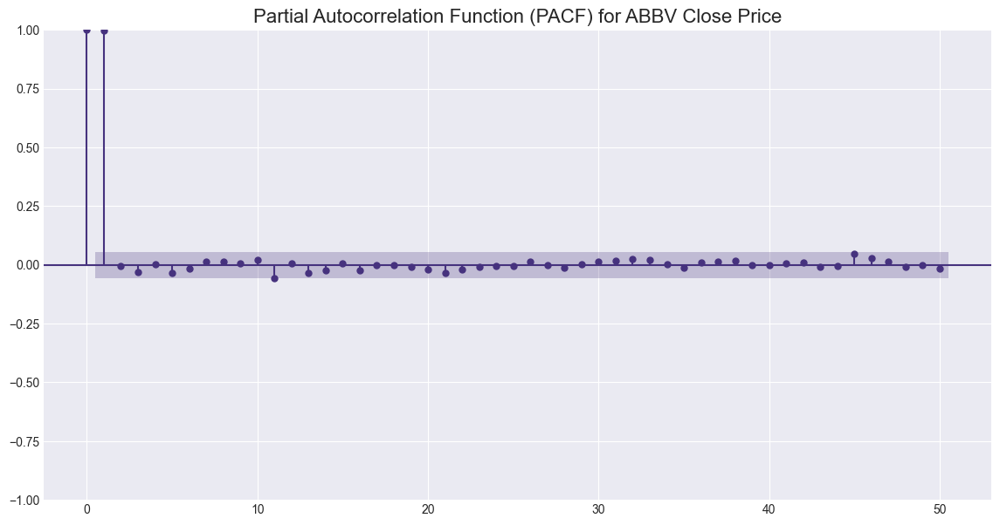


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.41      0.42      0.41        89
           1       0.57      0.57      0.57       123

    accuracy                           0.50       212
   macro avg       0.49      0.49      0.49       212
weighted avg       0.51      0.50      0.51       212



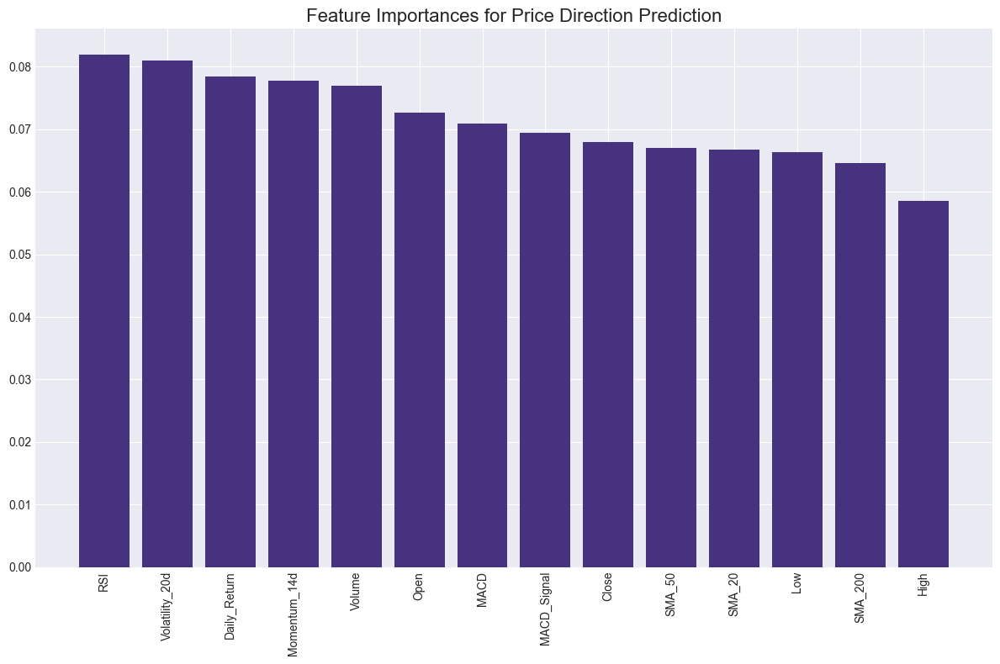


Saved processed data to ABBV_data.csv

Analyzing ADBE
Downloaded 1256 rows of data

Company Information:
Company: Adobe Inc.
Sector: Technology
Industry: Software - Application
Market Cap: $151,556,161,536
52-Week High: $587.75
52-Week Low: $332.01
Beta: 1.492
P/E Ratio: 23.111624

Price Statistics (Last 5 years):
Mean Close Price: $477.38
Standard Deviation: $90.93
Min Close Price: $275.20
Max Close Price: $688.37
Current Close Price: $349.91

Return Statistics:
Mean Daily Return: 0.0299%
Daily Return Std Dev: 2.2878%
Min Daily Return: -16.7932%
Max Daily Return: 14.5115%
Annualized Return: 7.83%
Annualized Volatility: 36.32%
Sharpe Ratio (Risk-free rate = 0%): 0.2156


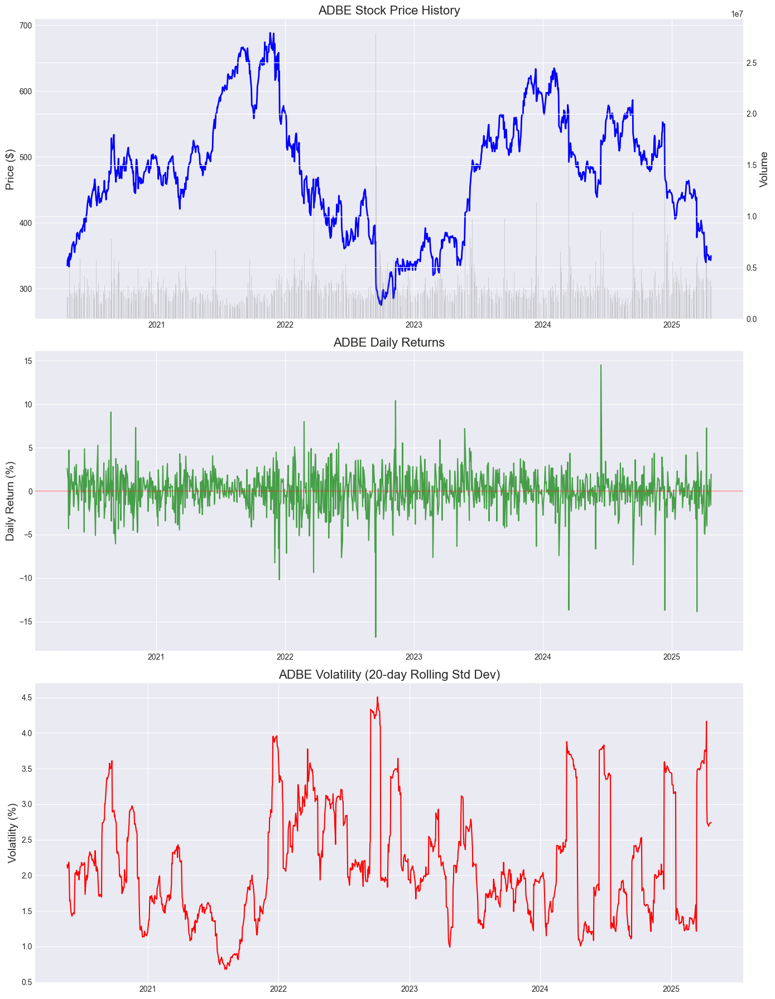

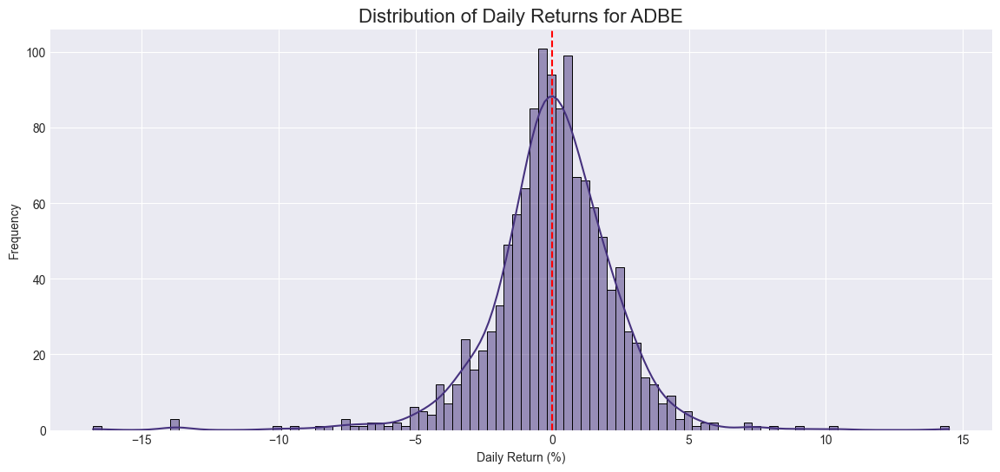

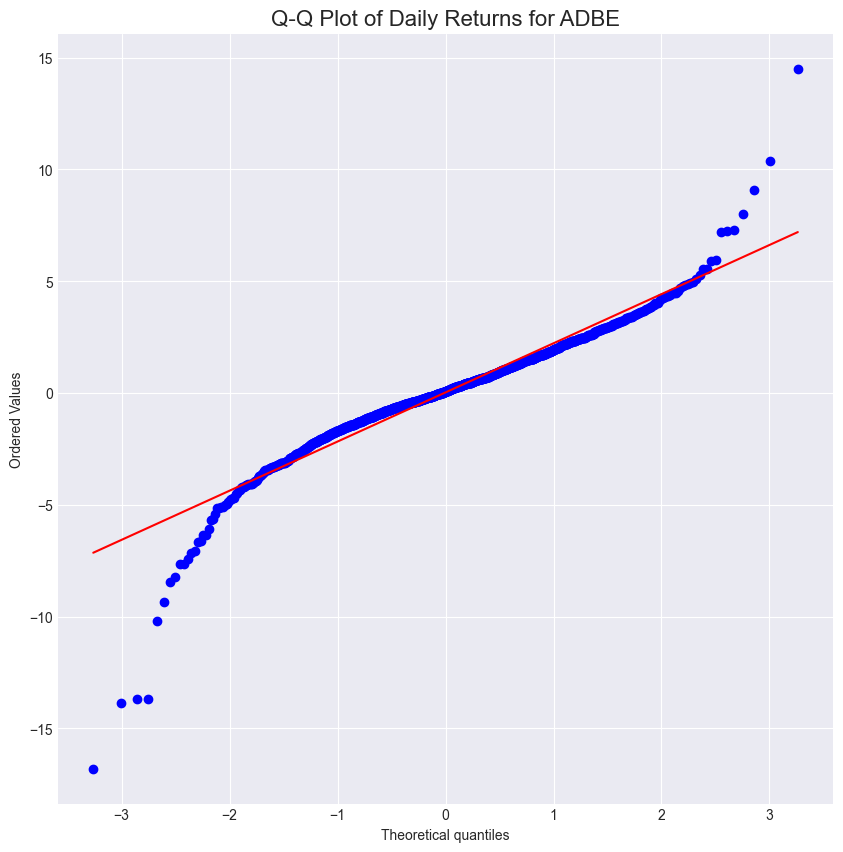

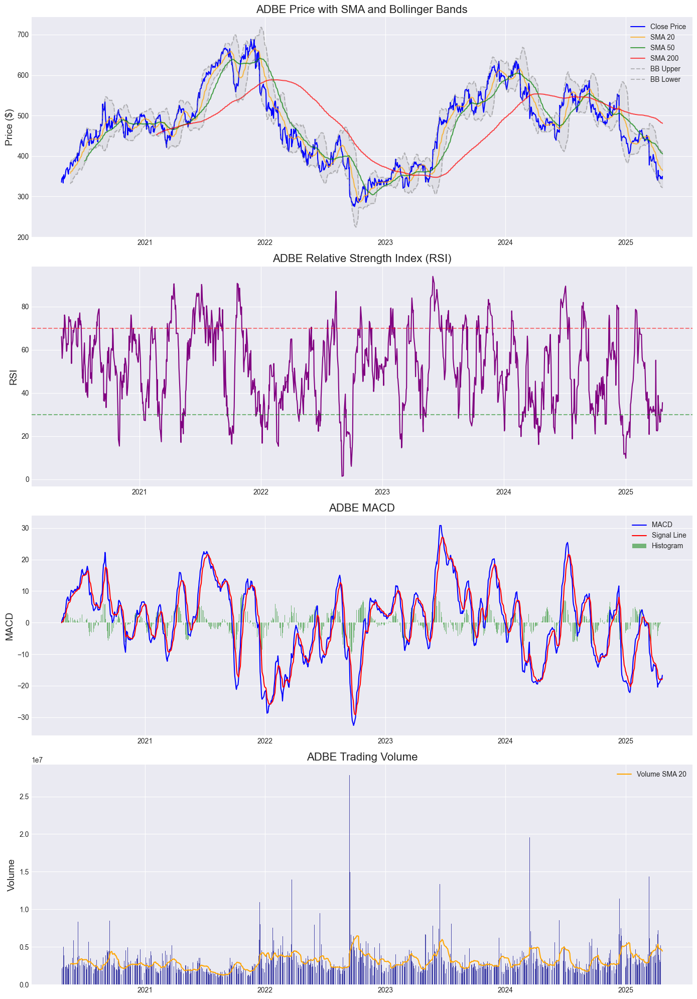

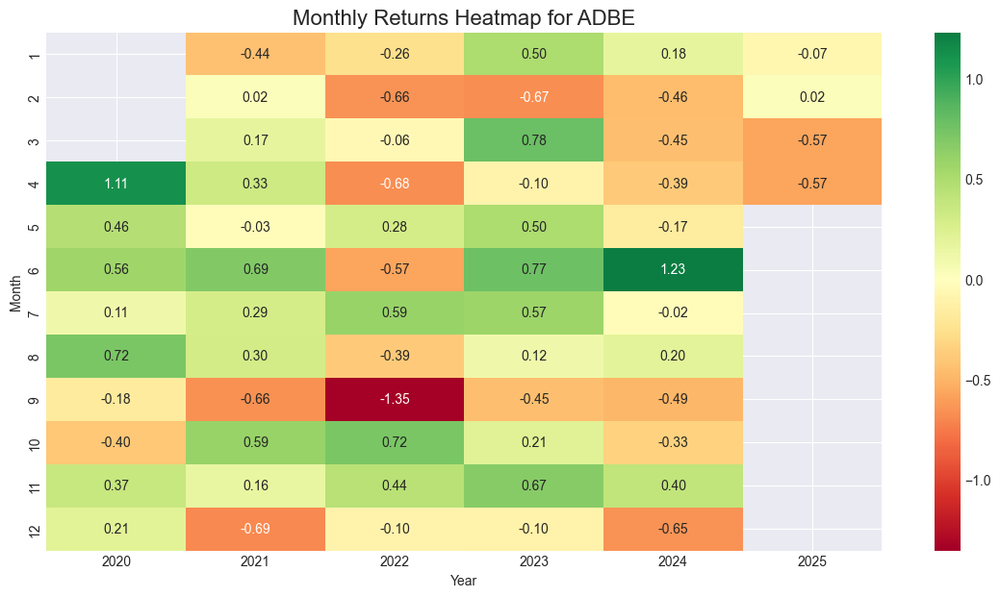

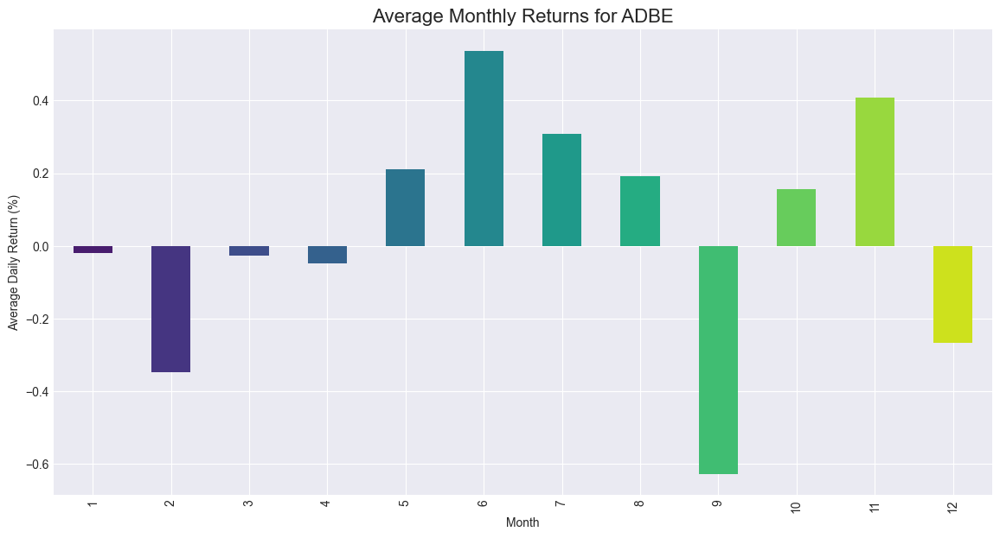

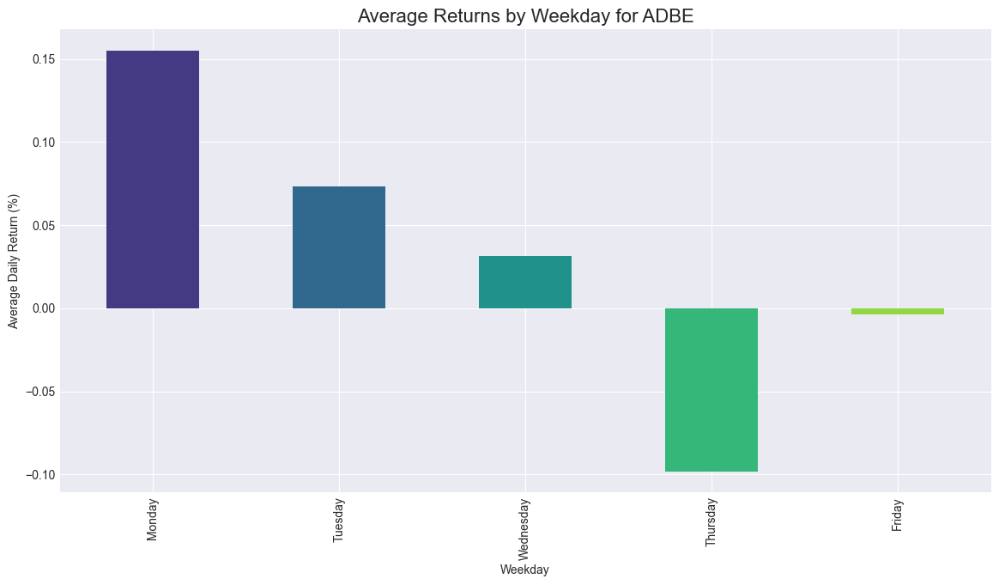

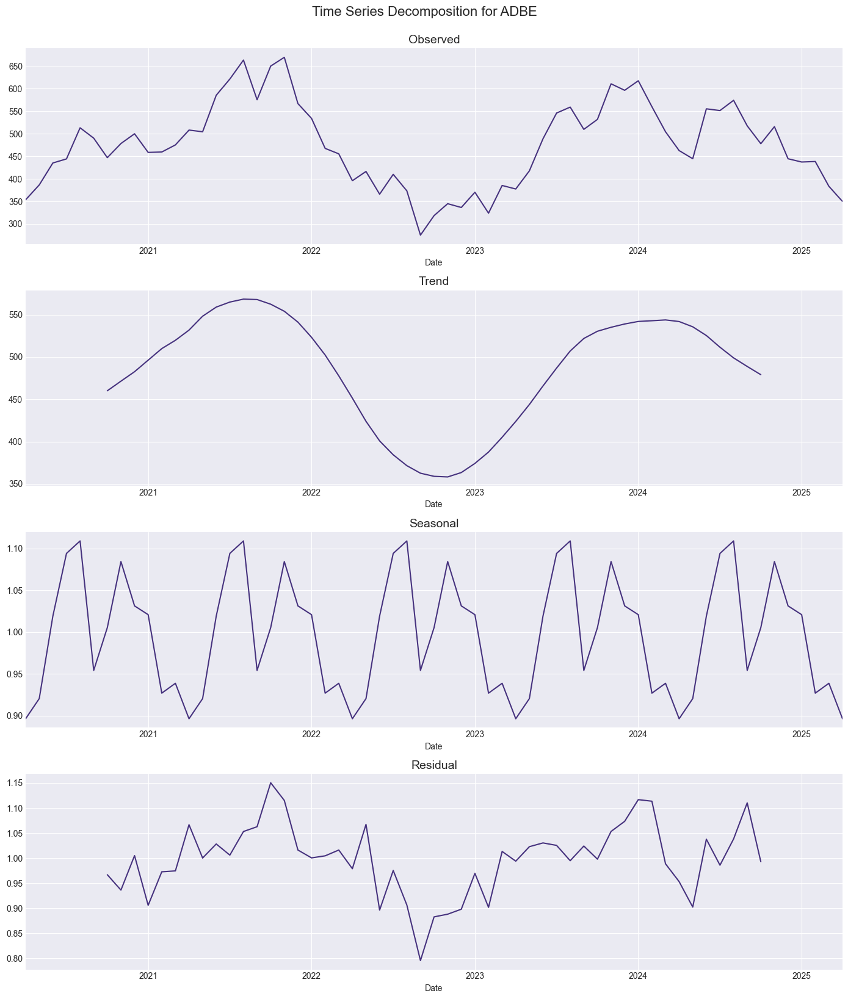

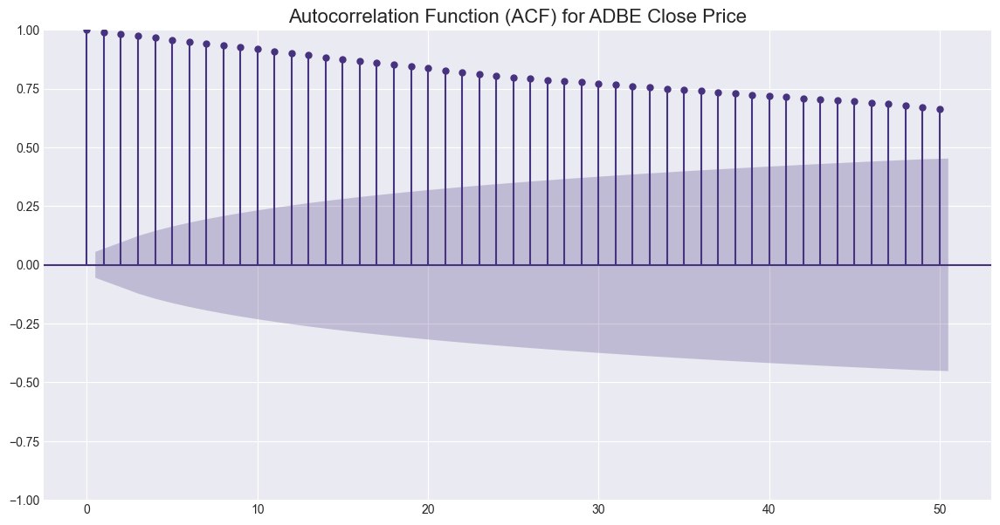

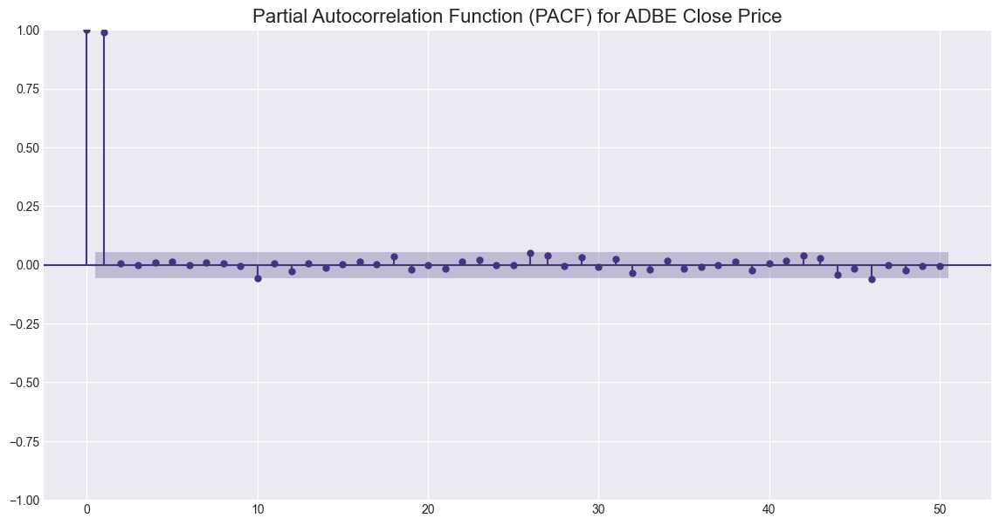


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.50      0.50      0.50       104
           1       0.52      0.52      0.52       108

    accuracy                           0.51       212
   macro avg       0.51      0.51      0.51       212
weighted avg       0.51      0.51      0.51       212



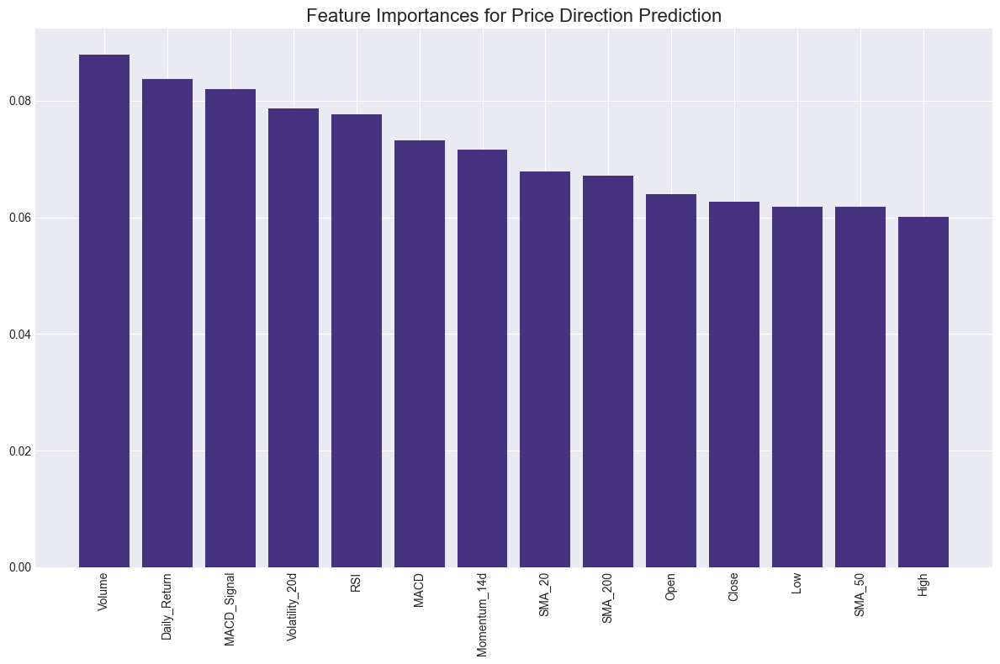


Saved processed data to ADBE_data.csv

Analyzing ADI
Downloaded 1256 rows of data

Company Information:
Company: Analog Devices, Inc.
Sector: Technology
Industry: Semiconductors
Market Cap: $89,179,316,224
52-Week High: $247.1
52-Week Low: $158.65
Beta: 1.059
P/E Ratio: 57.02875

Price Statistics (Last 5 years):
Mean Close Price: $166.53
Standard Deviation: $33.97
Min Close Price: $93.01
Max Close Price: $242.76
Current Close Price: $178.50

Return Statistics:
Mean Daily Return: 0.0735%
Daily Return Std Dev: 2.0810%
Min Daily Return: -9.3742%
Max Daily Return: 18.3876%
Annualized Return: 20.33%
Annualized Volatility: 33.03%
Sharpe Ratio (Risk-free rate = 0%): 0.6154


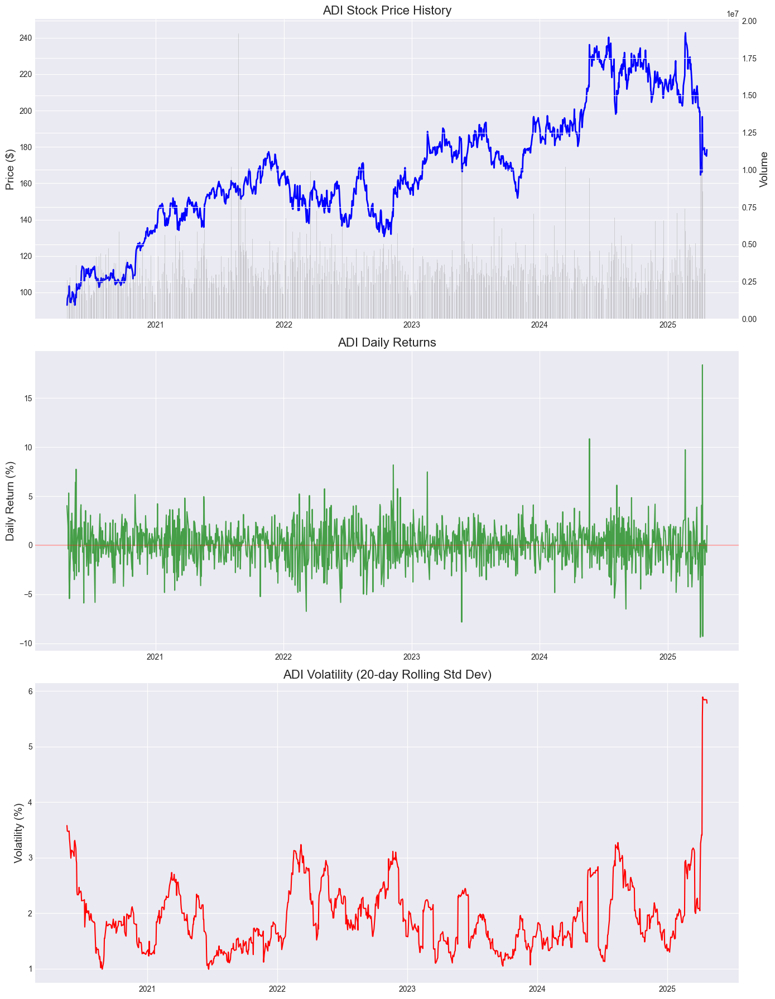

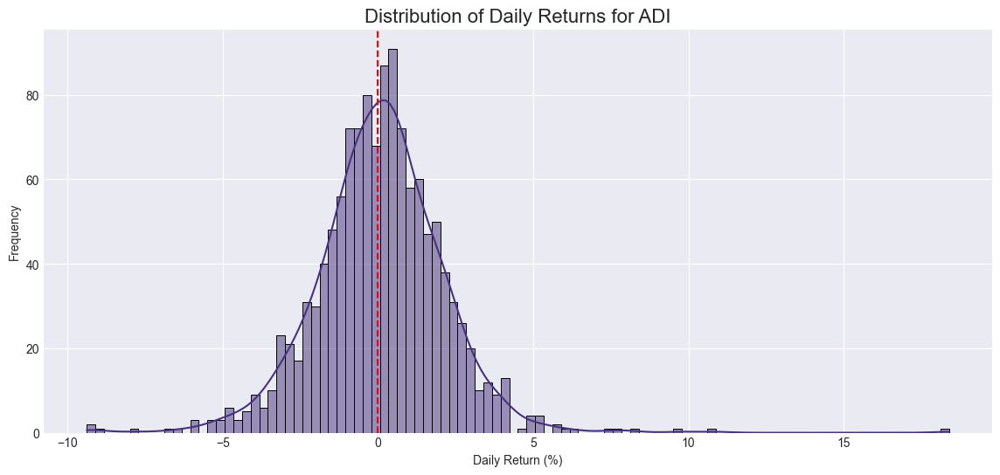

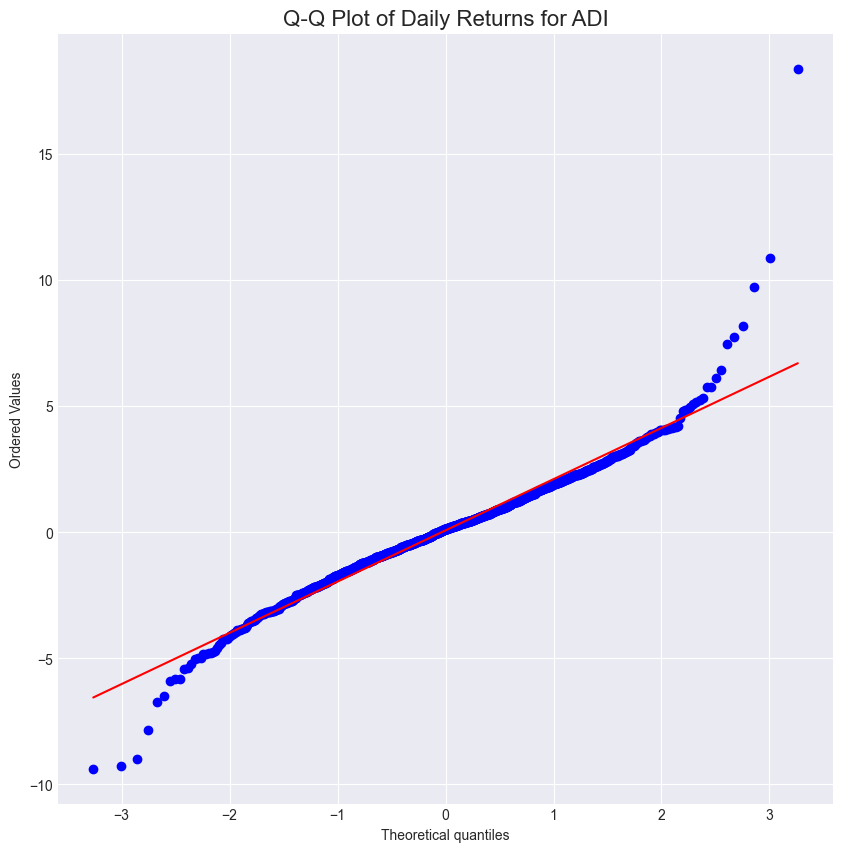

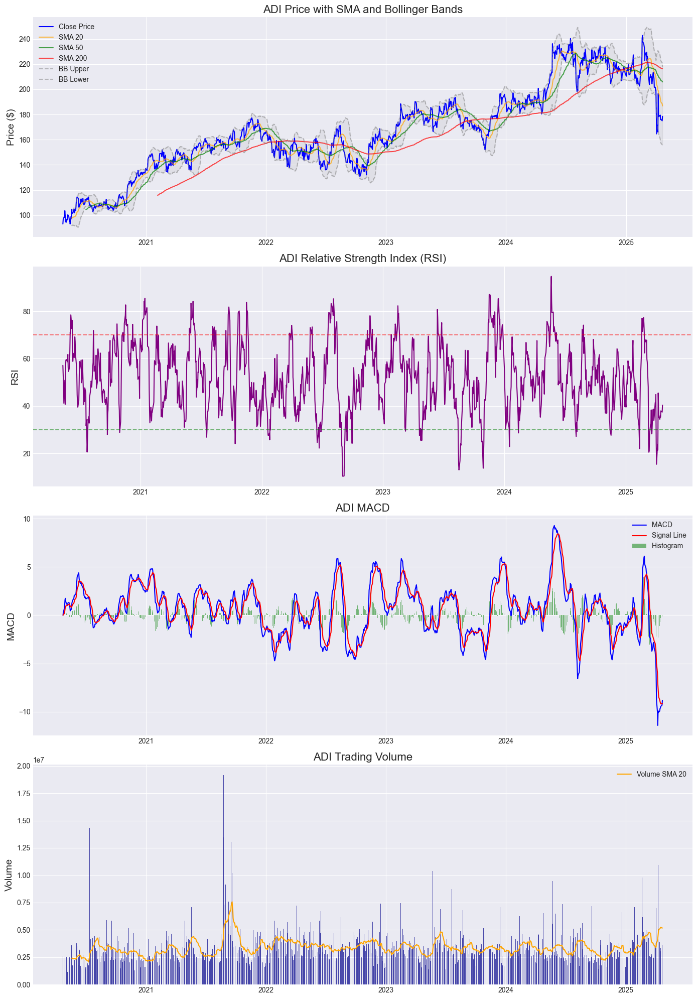

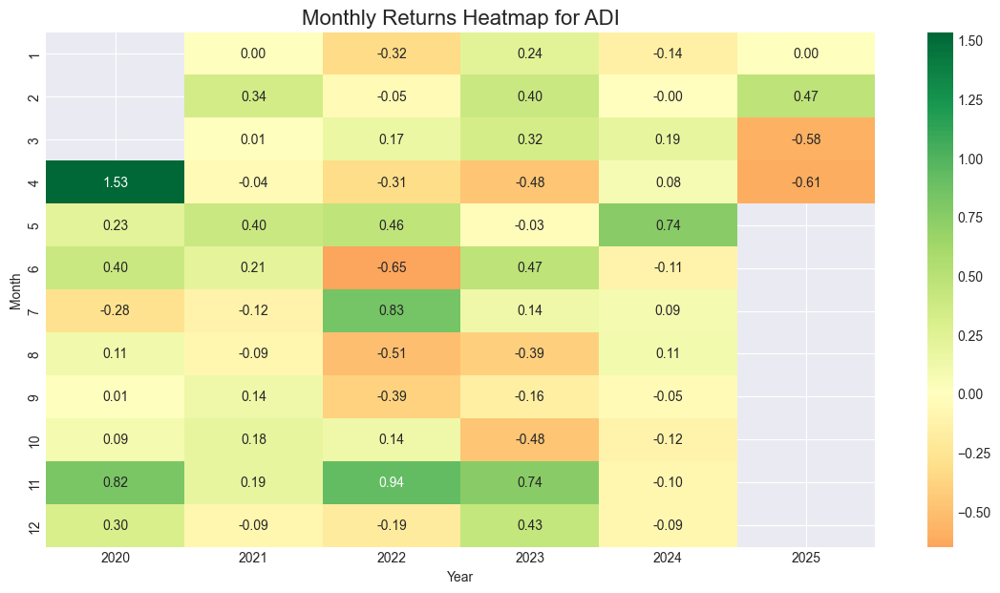

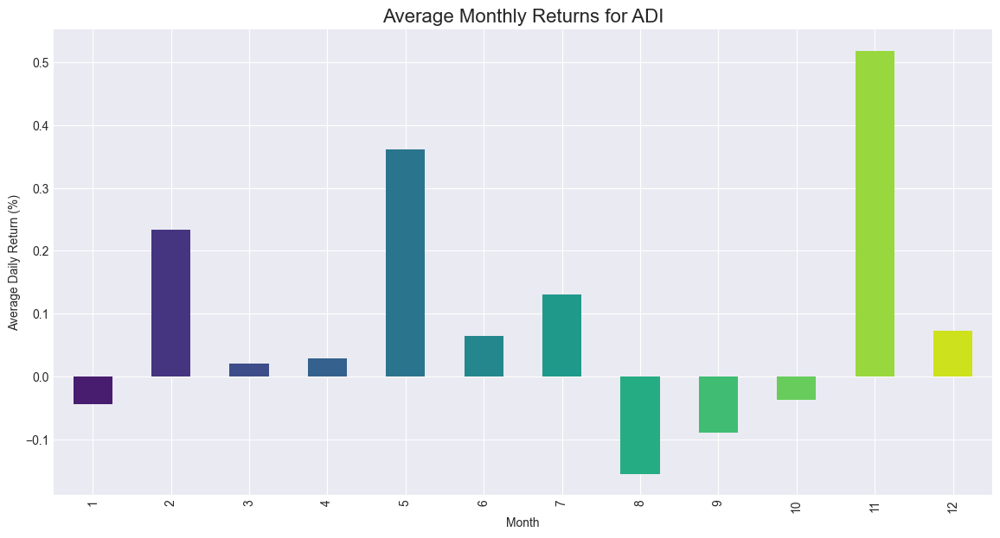

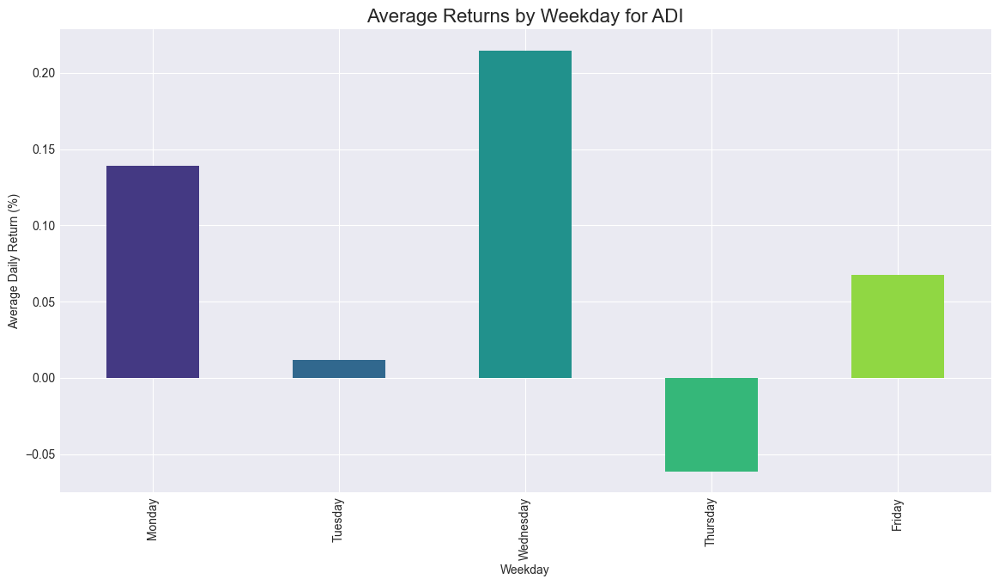

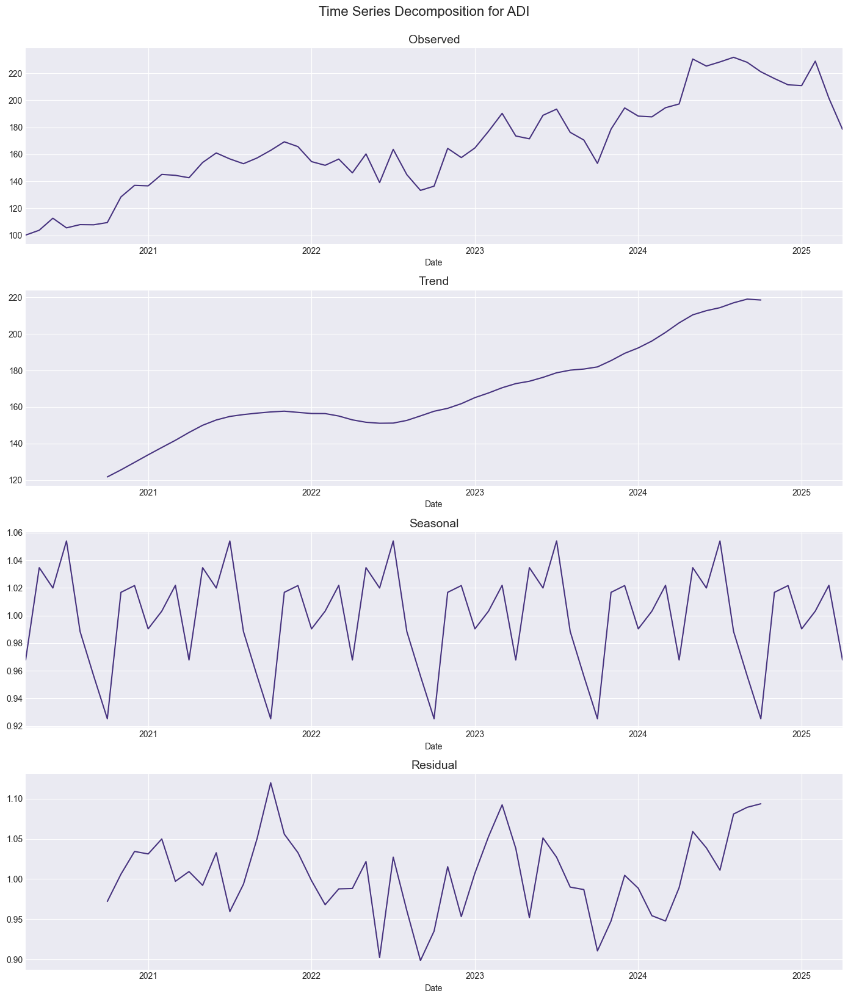

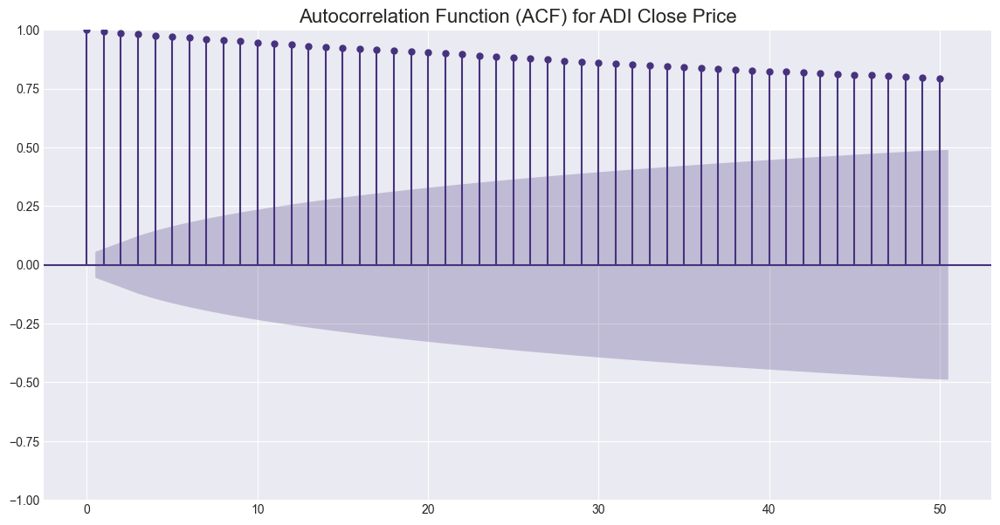

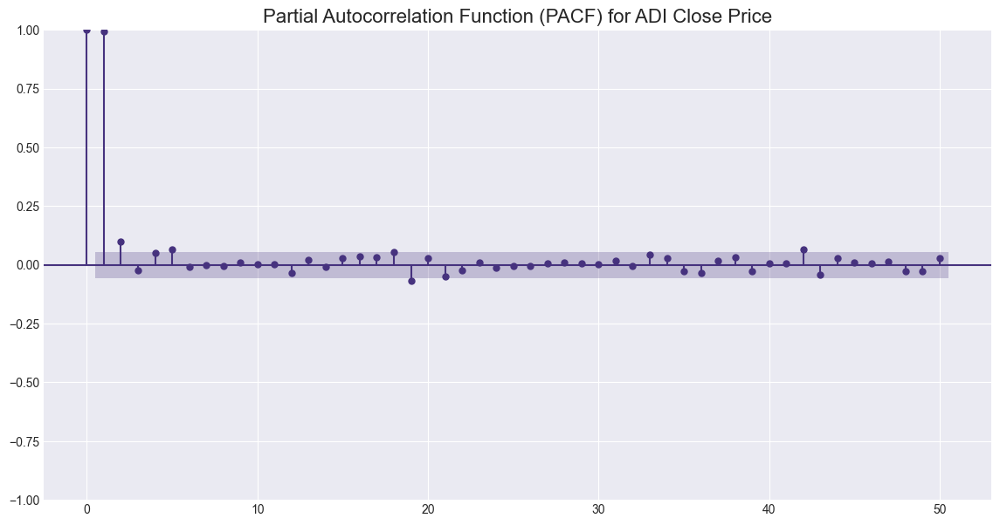


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.46      0.48      0.47        96
           1       0.56      0.54      0.55       116

    accuracy                           0.51       212
   macro avg       0.51      0.51      0.51       212
weighted avg       0.52      0.51      0.51       212



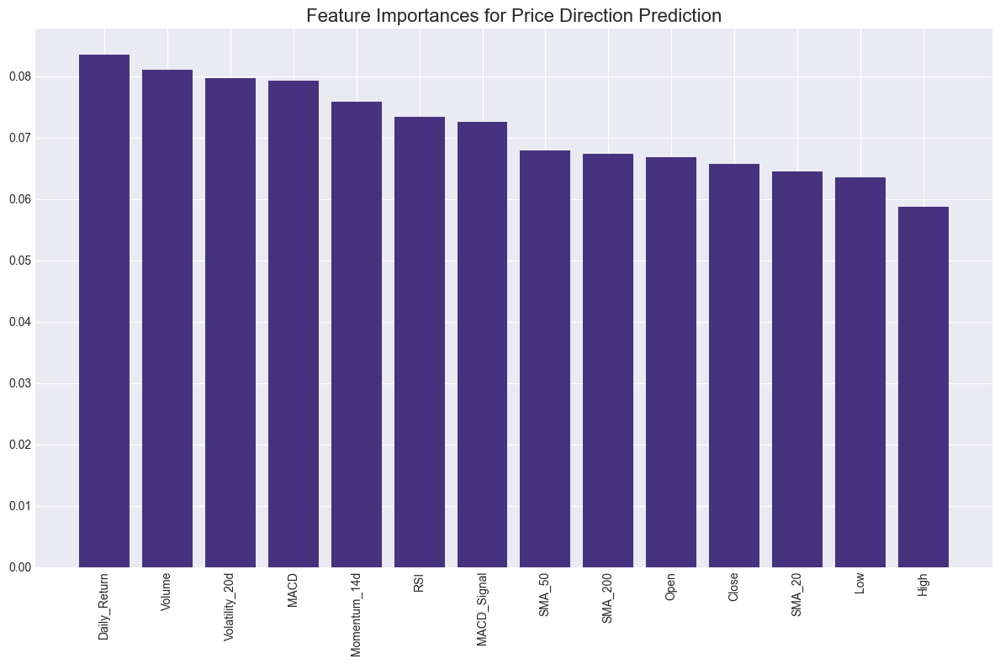


Saved processed data to ADI_data.csv

Analyzing ABNB
Downloaded 1095 rows of data

Company Information:
Company: Airbnb, Inc.
Sector: Consumer Cyclical
Industry: Travel Services
Market Cap: $72,095,457,280
52-Week High: $166.745
52-Week Low: $99.88
Beta: 1.152
P/E Ratio: 27.958637

Price Statistics (Last 5 years):
Mean Close Price: $139.29
Standard Deviation: $25.45
Min Close Price: $82.49
Max Close Price: $216.84
Current Close Price: $114.91

Return Statistics:
Mean Daily Return: 0.0271%
Daily Return Std Dev: 3.1109%
Min Daily Return: -13.4250%
Max Daily Return: 14.7885%
Annualized Return: 7.07%
Annualized Volatility: 49.38%
Sharpe Ratio (Risk-free rate = 0%): 0.1432


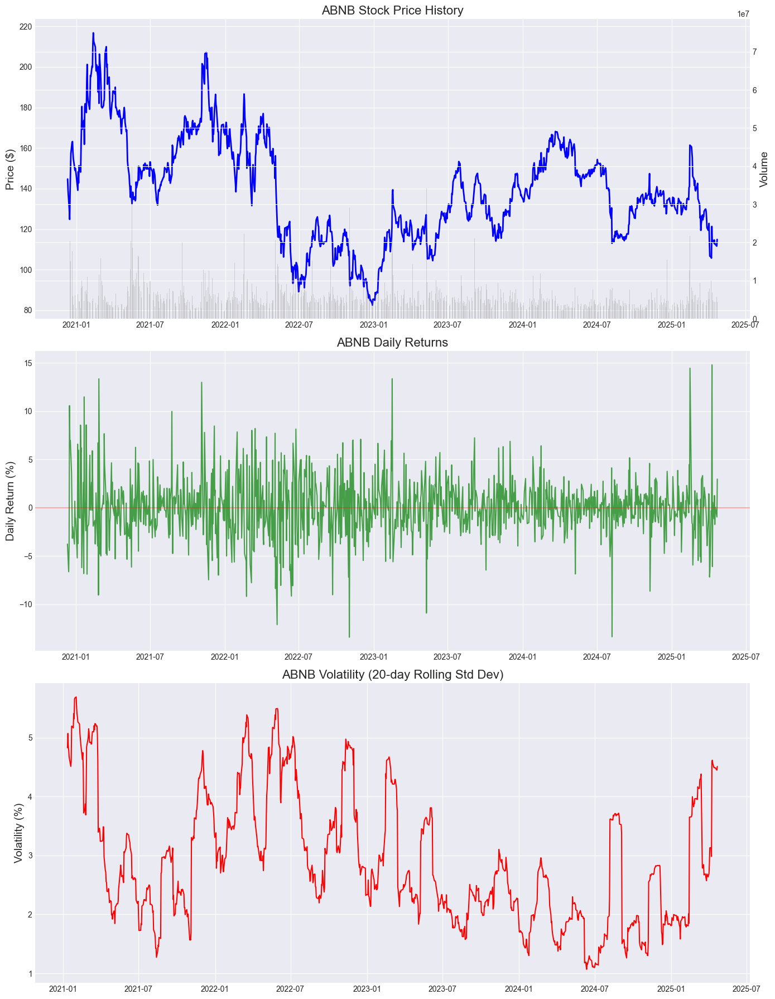

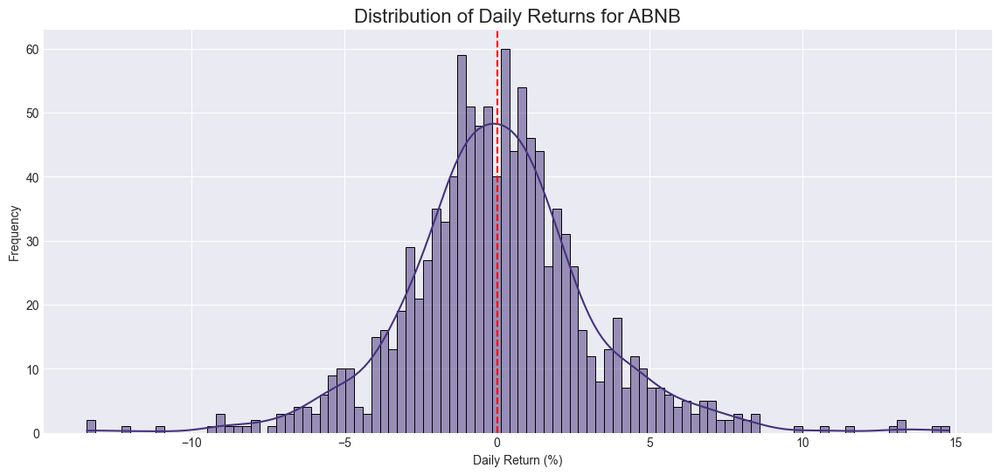

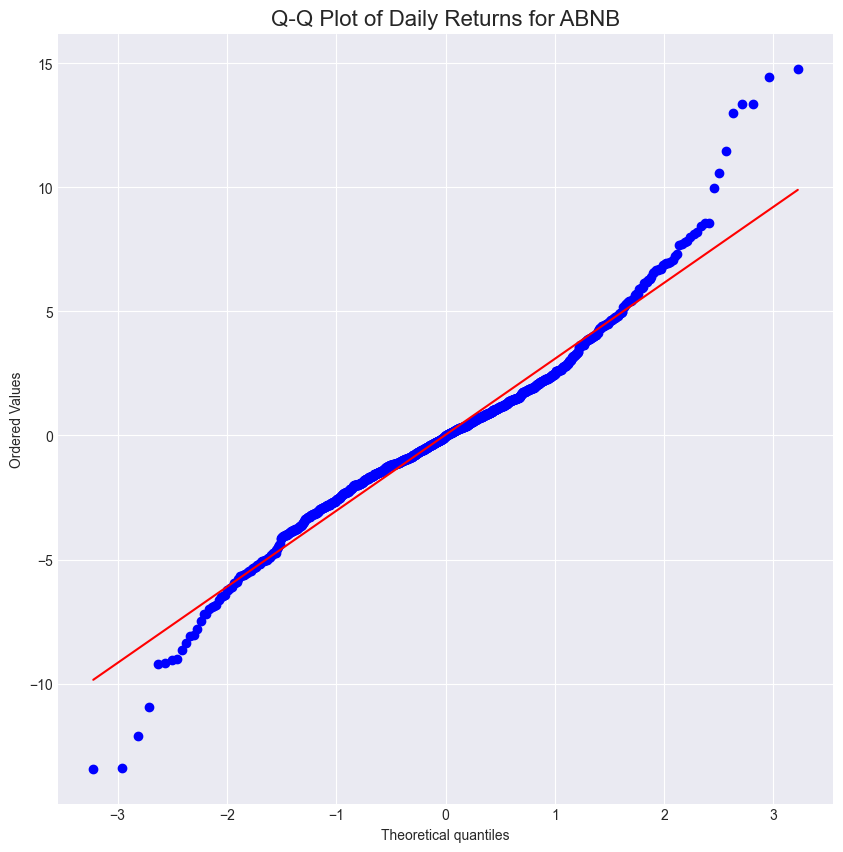

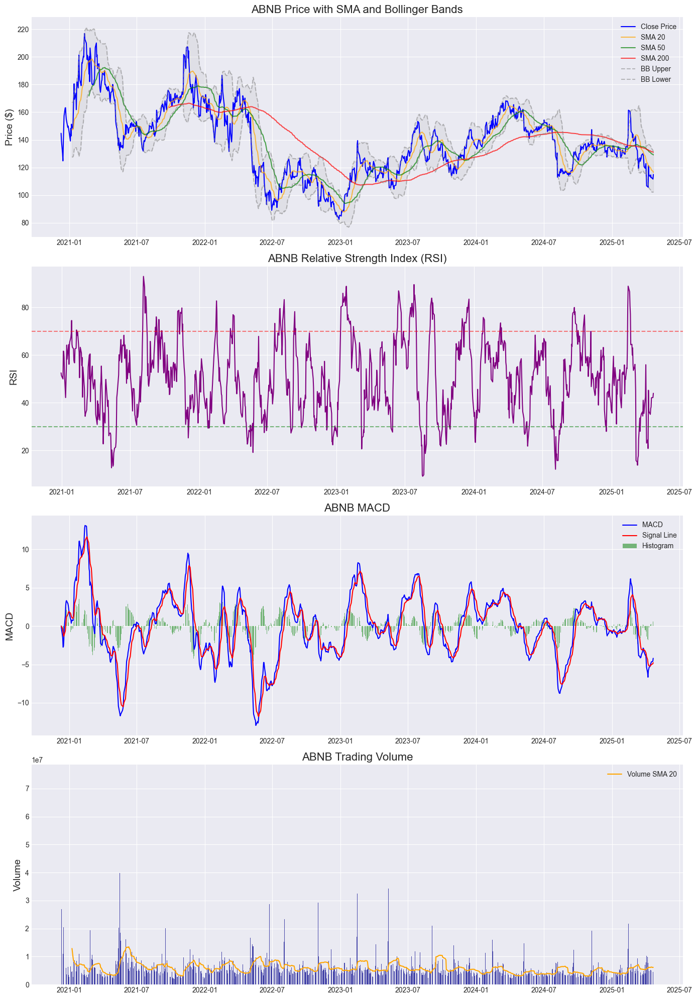

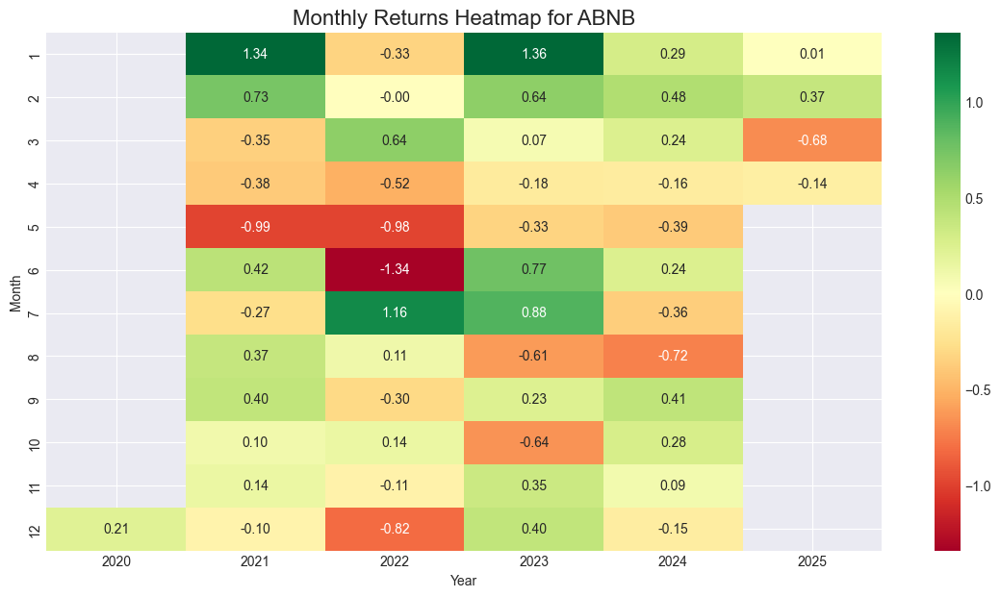

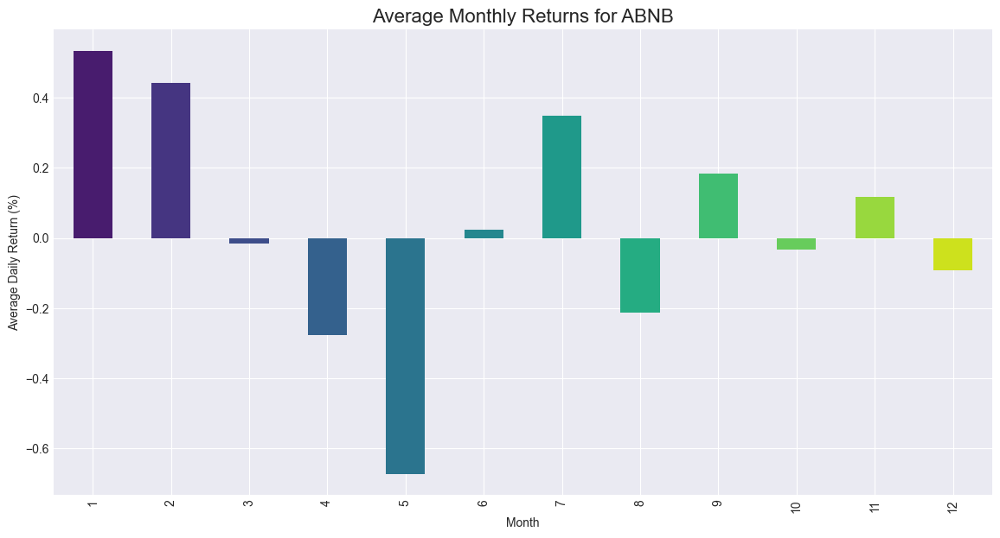

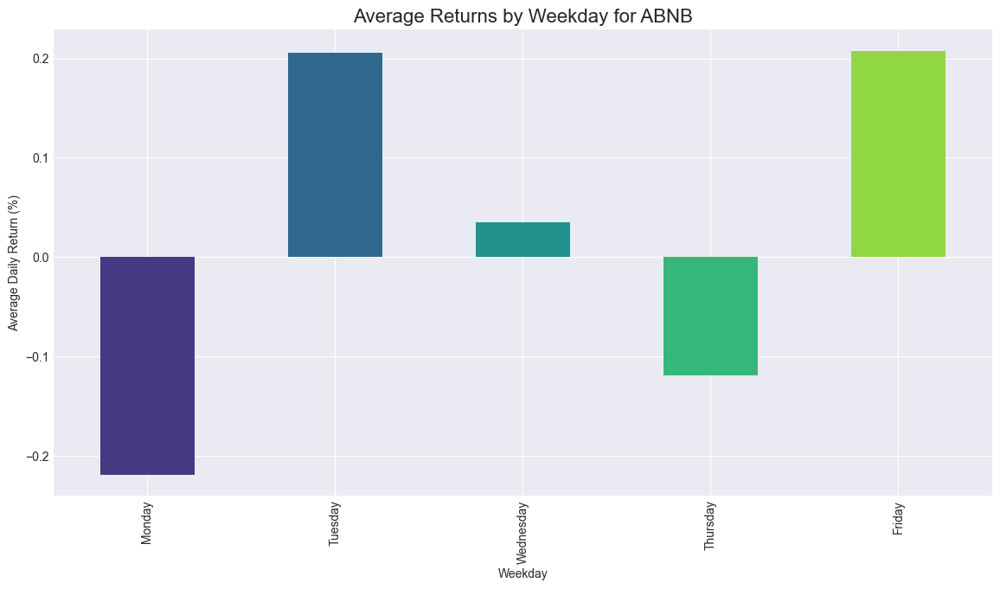

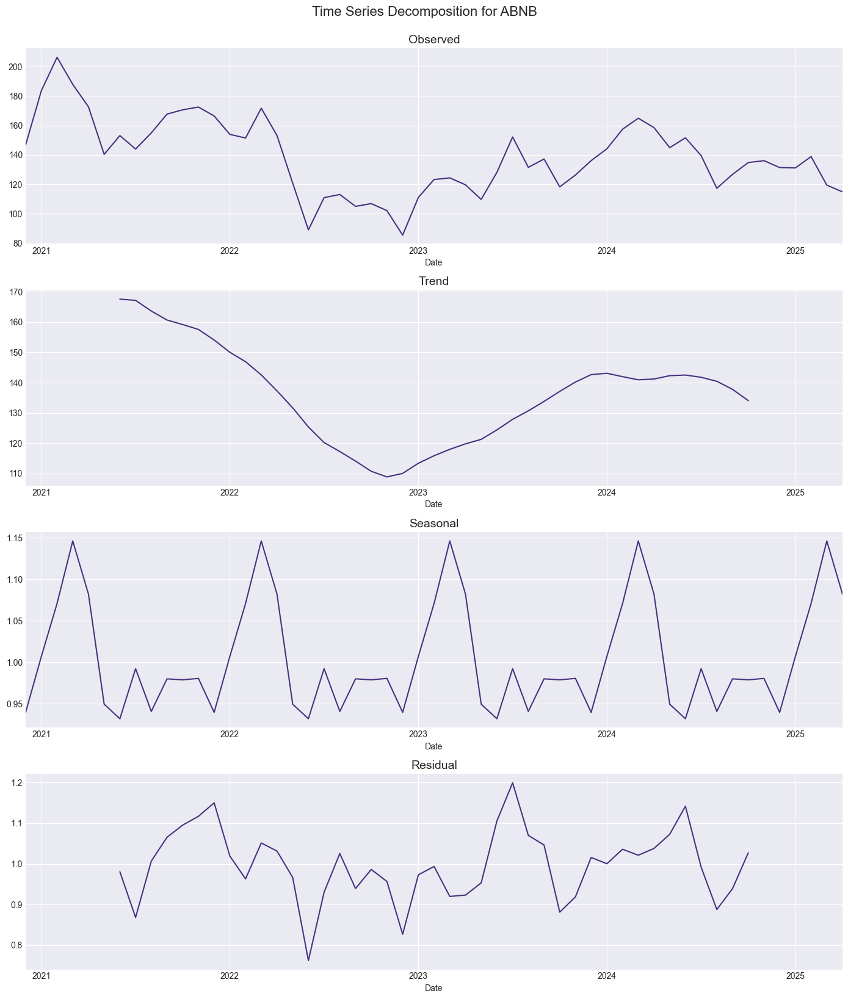

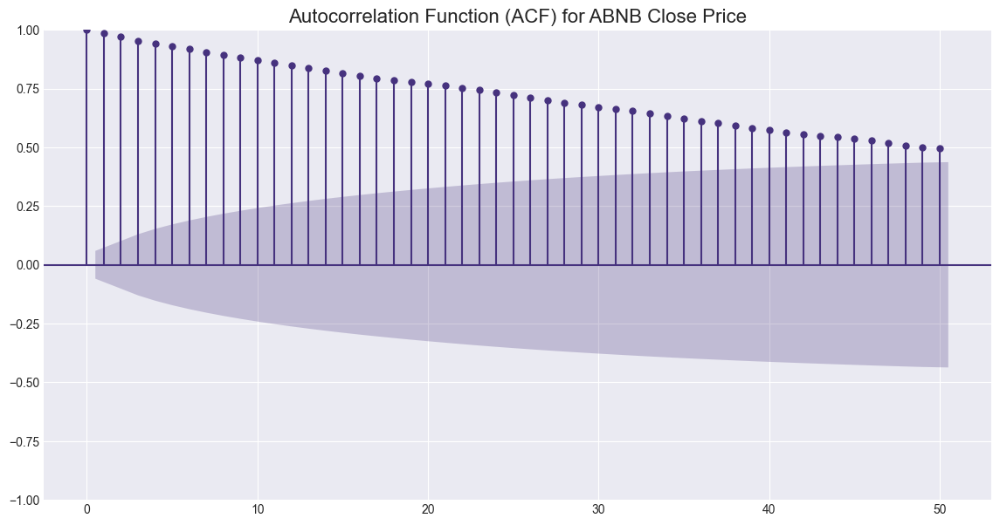

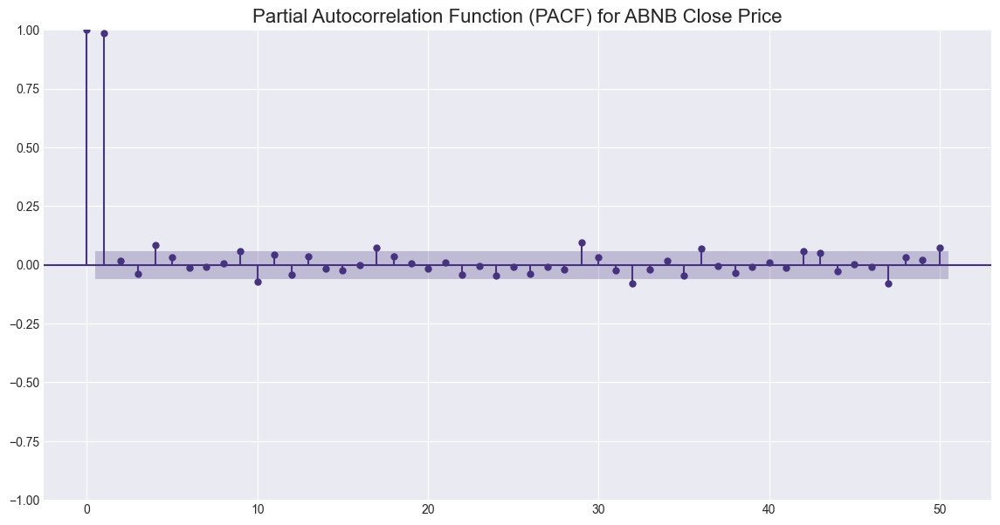


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.54      0.47      0.51        95
           1       0.48      0.55      0.52        85

    accuracy                           0.51       180
   macro avg       0.51      0.51      0.51       180
weighted avg       0.51      0.51      0.51       180



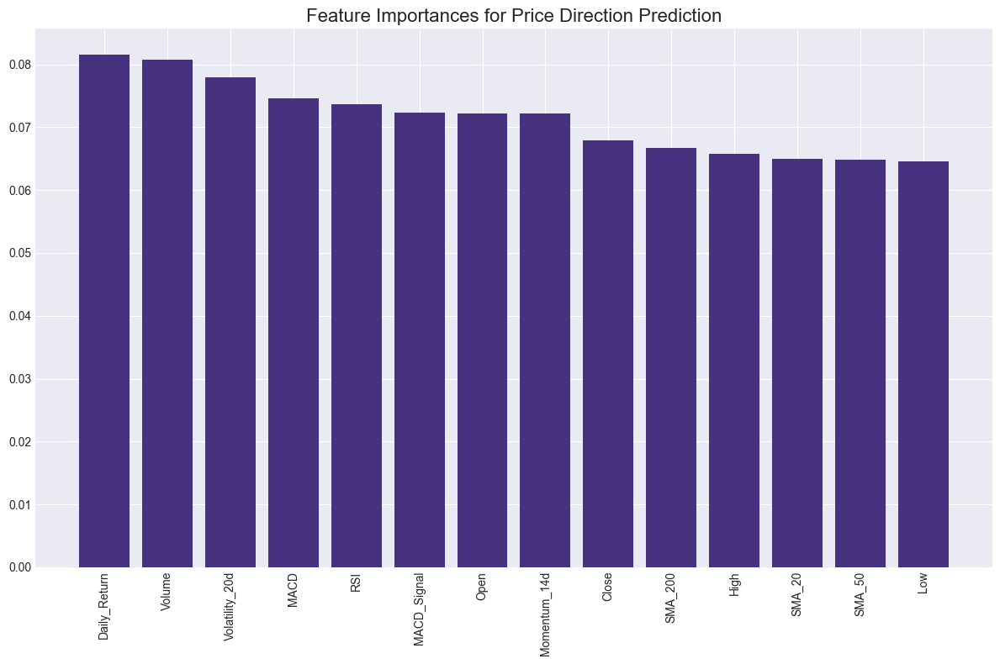


Saved processed data to ABNB_data.csv

Analyzing ZTS
Downloaded 1256 rows of data

Company Information:
Company: Zoetis Inc.
Sector: Healthcare
Industry: Drug Manufacturers - Specialty & Generic
Market Cap: $67,733,835,776
52-Week High: $200.33
52-Week Low: $139.7
Beta: 0.925
P/E Ratio: 27.470697

Price Statistics (Last 5 years):
Mean Close Price: $169.39
Standard Deviation: $20.07
Min Close Price: $118.08
Max Close Price: $239.10
Current Close Price: $149.99

Return Statistics:
Mean Daily Return: 0.0322%
Daily Return Std Dev: 1.6454%
Min Daily Return: -11.0070%
Max Daily Return: 7.0887%
Annualized Return: 8.46%
Annualized Volatility: 26.12%
Sharpe Ratio (Risk-free rate = 0%): 0.3237


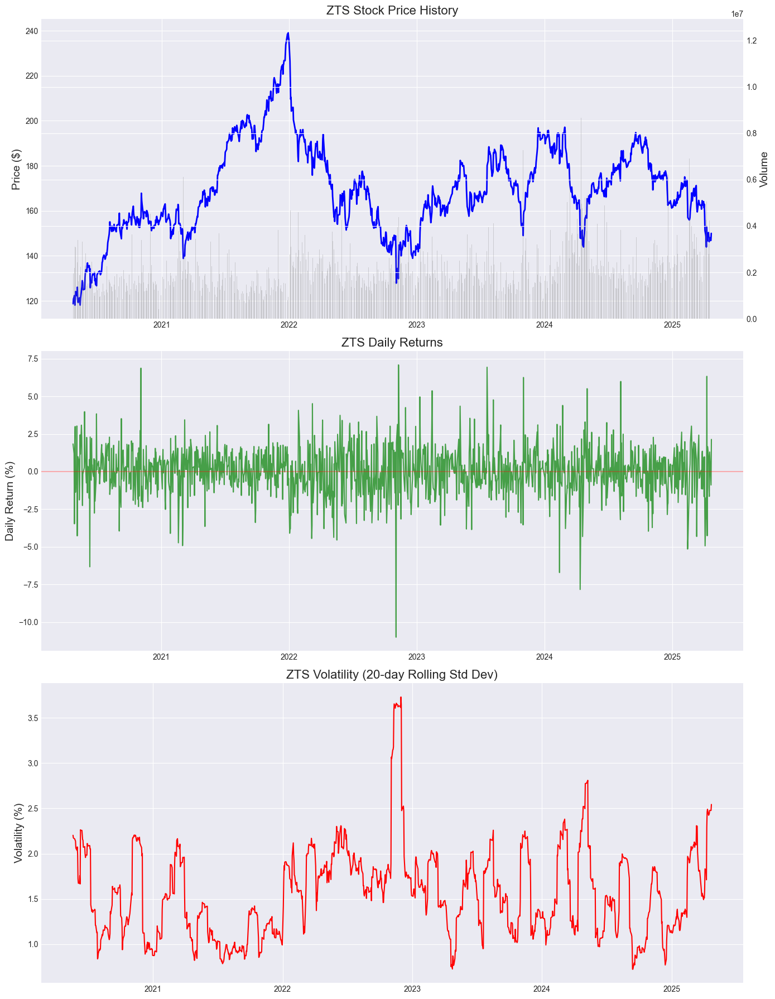

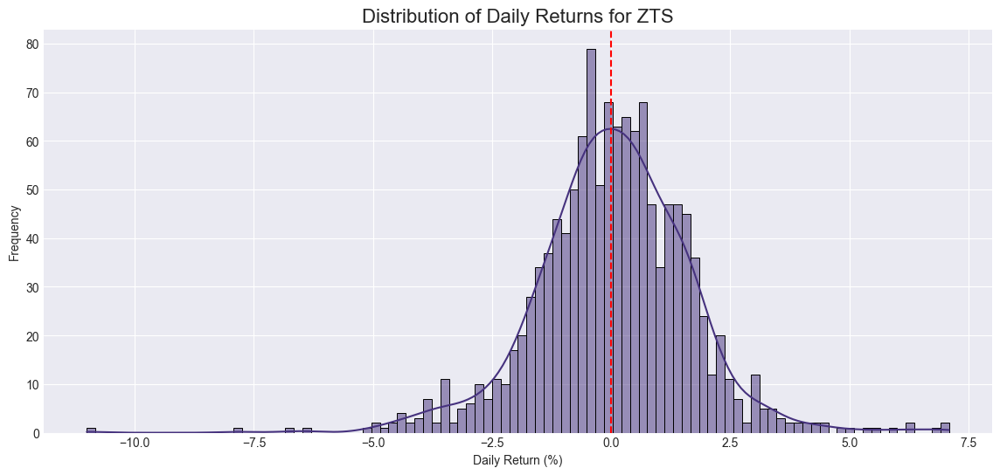

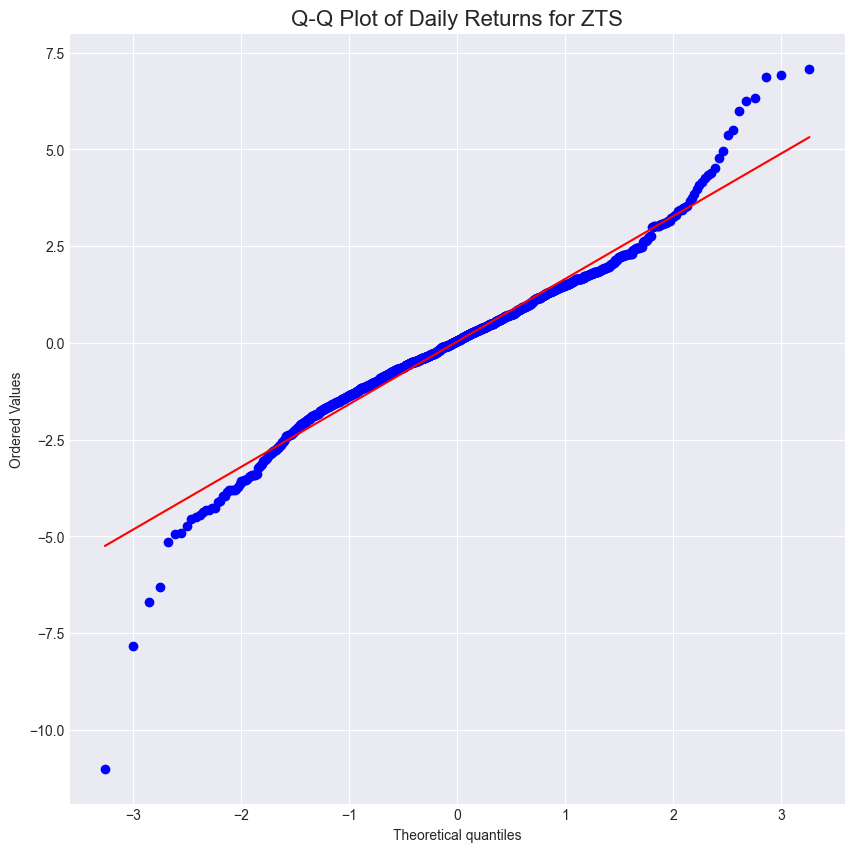

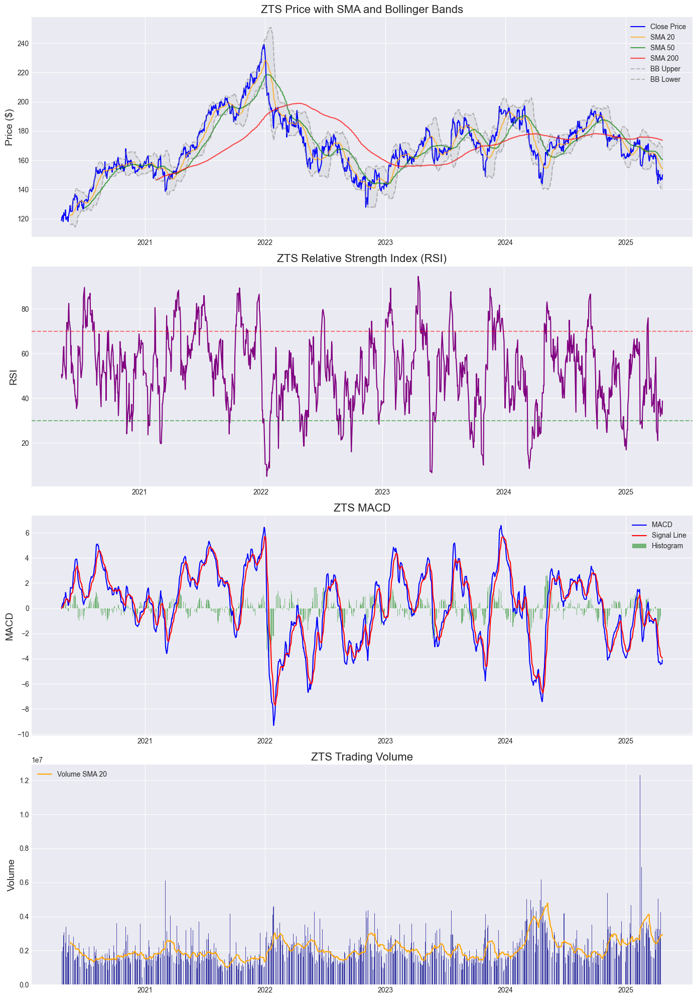

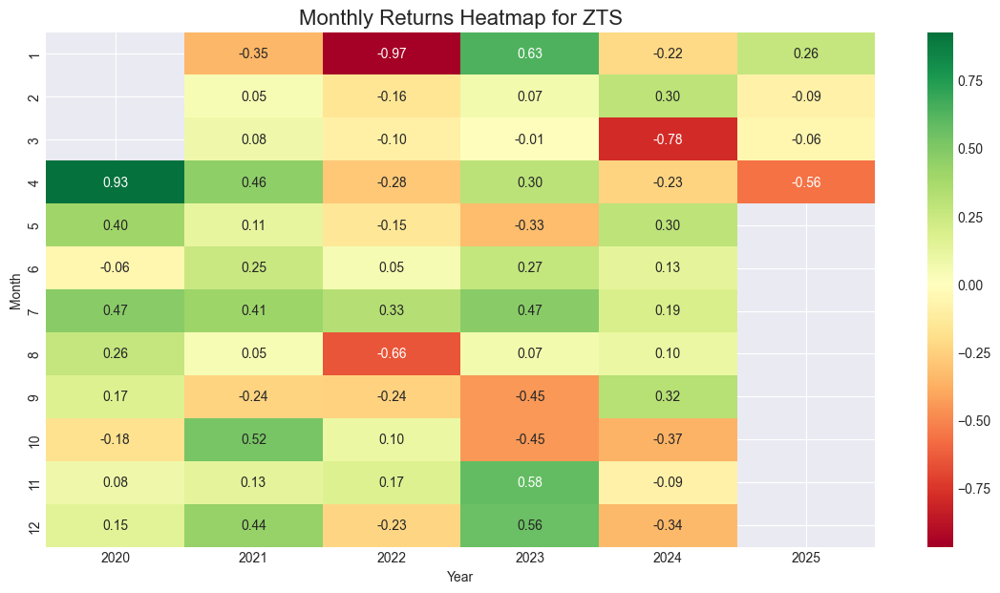

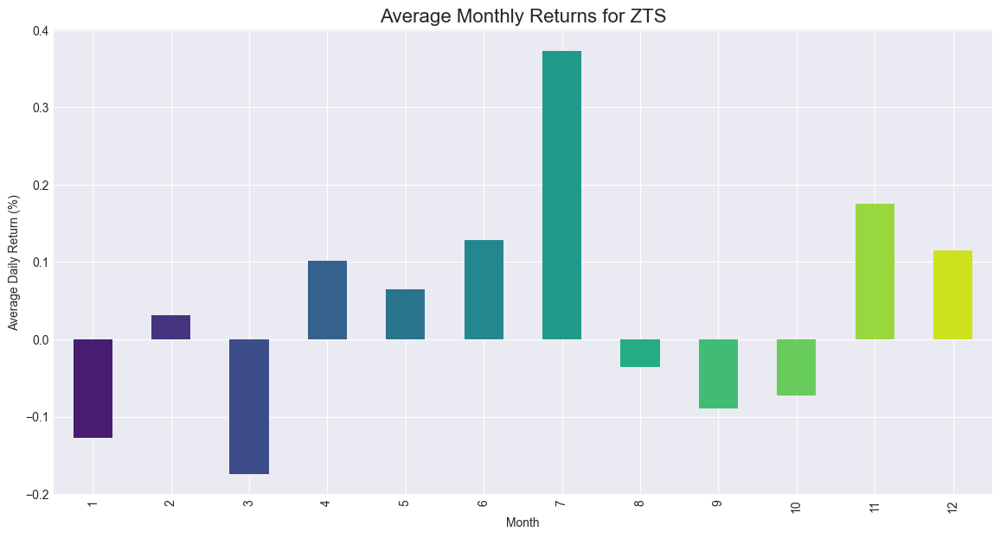

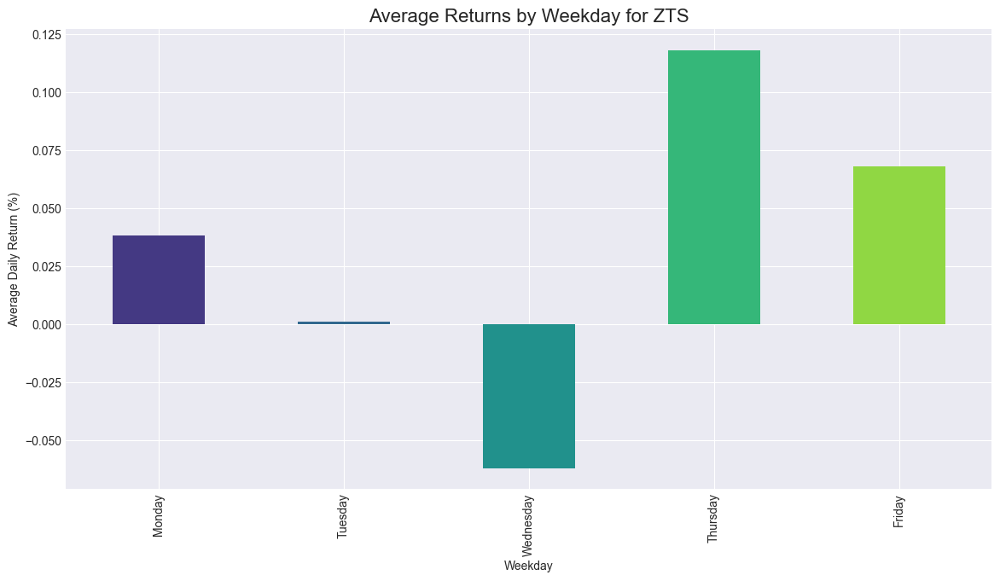

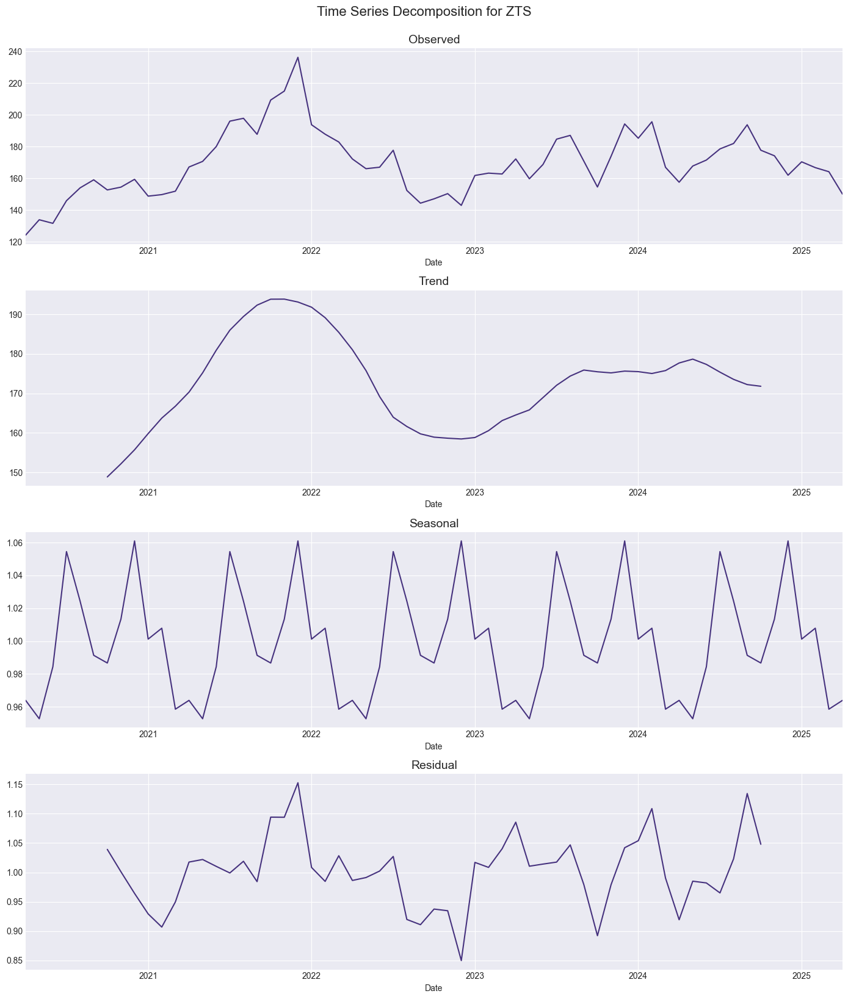

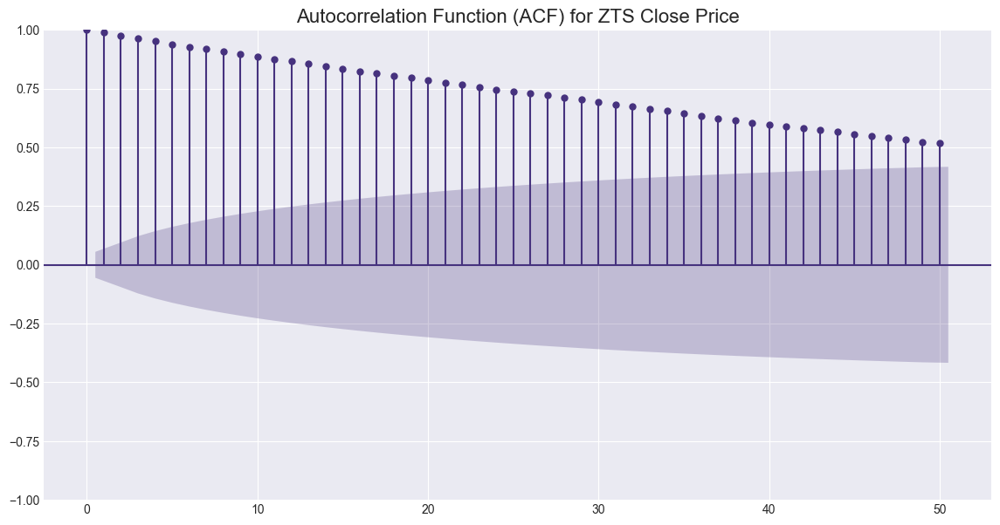

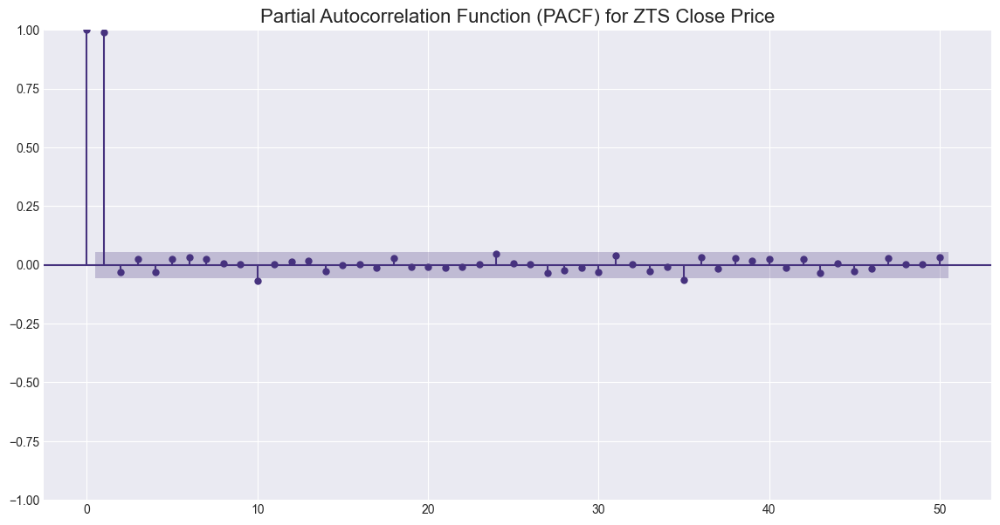


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.50      0.59      0.54        97
           1       0.59      0.50      0.54       115

    accuracy                           0.54       212
   macro avg       0.54      0.54      0.54       212
weighted avg       0.55      0.54      0.54       212



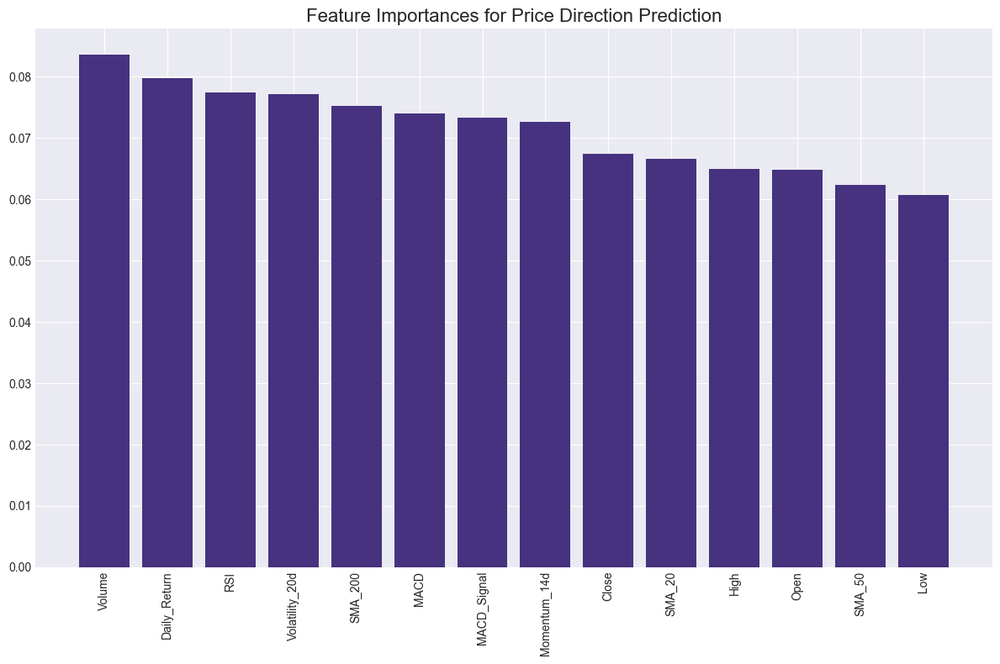


Saved processed data to ZTS_data.csv

Analyzing XOM
Downloaded 1256 rows of data

Company Information:
Company: Exxon Mobil Corporation
Sector: Energy
Industry: Oil & Gas Integrated
Market Cap: $475,409,907,712
52-Week High: $126.34
52-Week Low: $97.8
Beta: 0.579
P/E Ratio: 13.813776

Price Statistics (Last 5 years):
Mean Close Price: $80.61
Standard Deviation: $29.52
Min Close Price: $25.89
Max Close Price: $123.25
Current Close Price: $108.30

Return Statistics:
Mean Daily Return: 0.1107%
Daily Return Std Dev: 1.9510%
Min Daily Return: -8.8253%
Max Daily Return: 12.6602%
Annualized Return: 32.15%
Annualized Volatility: 30.97%
Sharpe Ratio (Risk-free rate = 0%): 1.0381


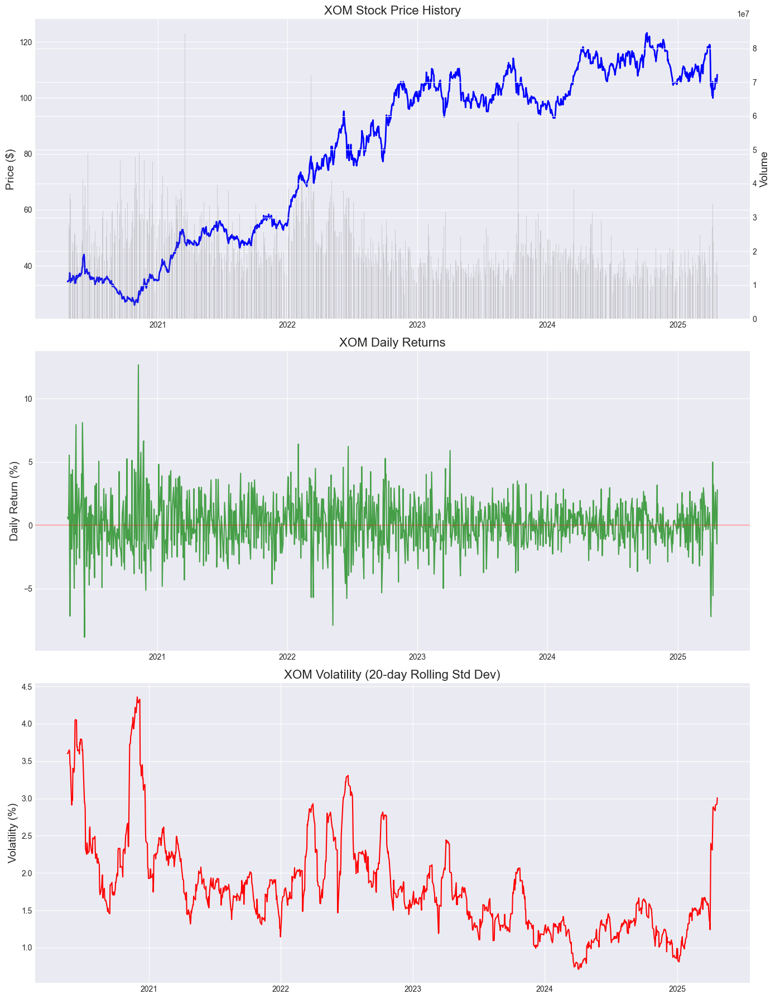

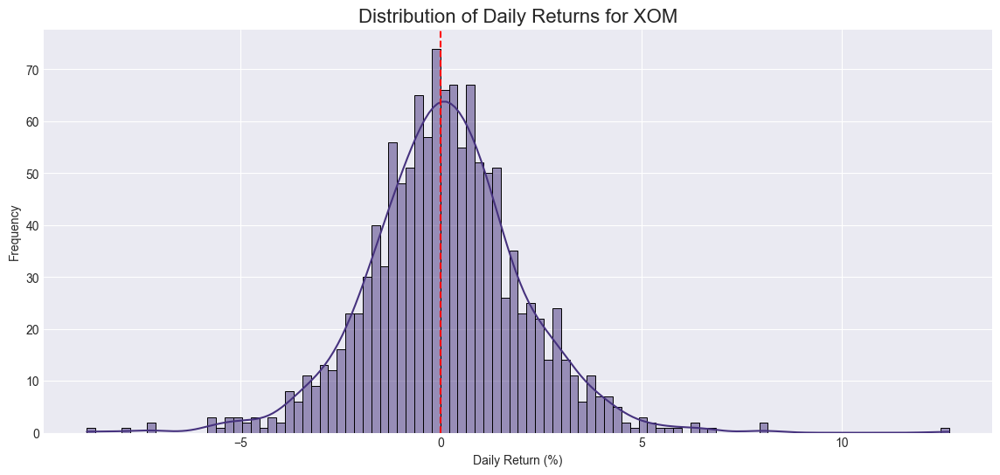

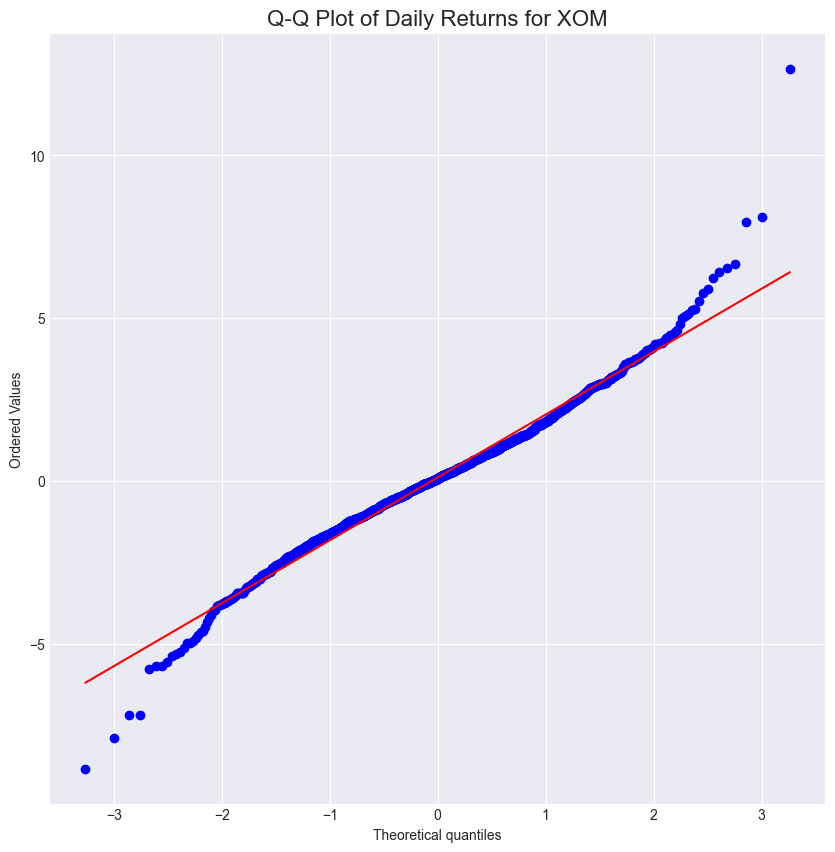

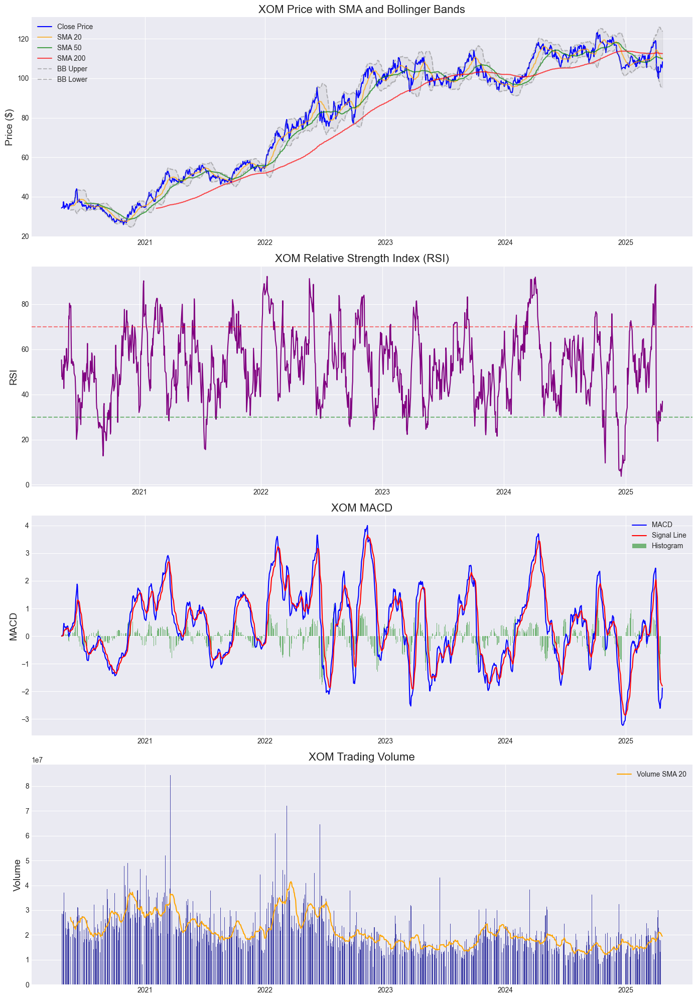

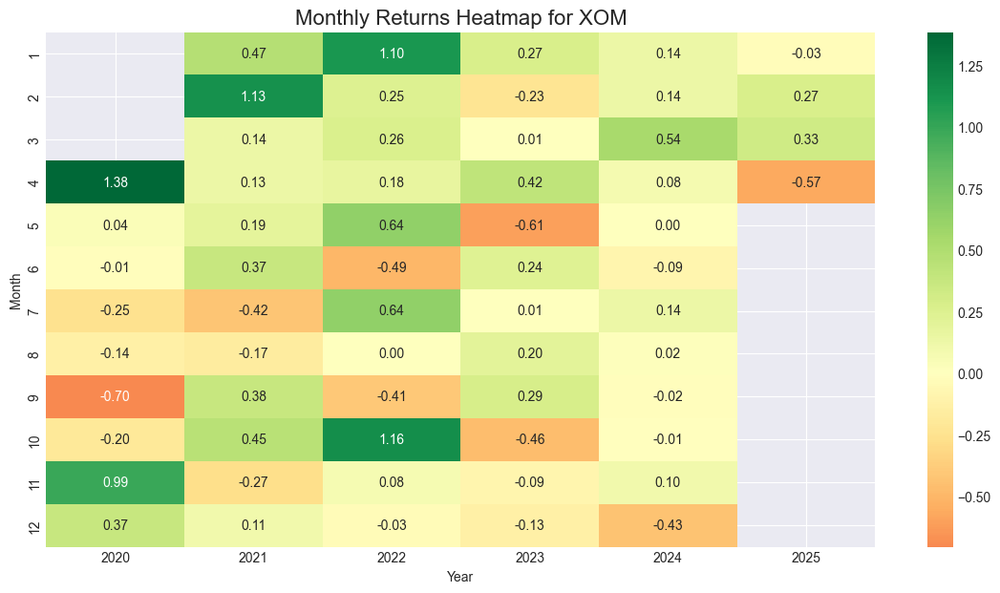

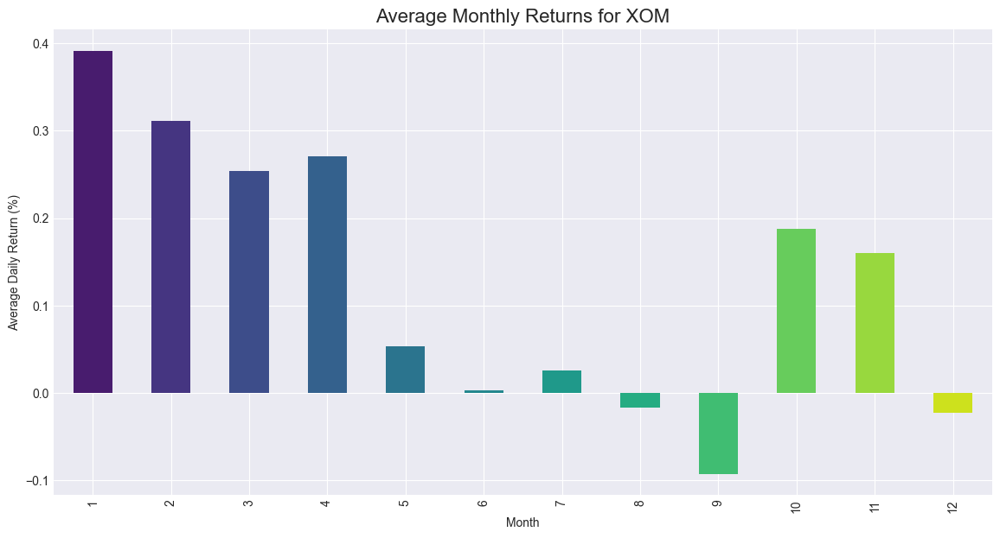

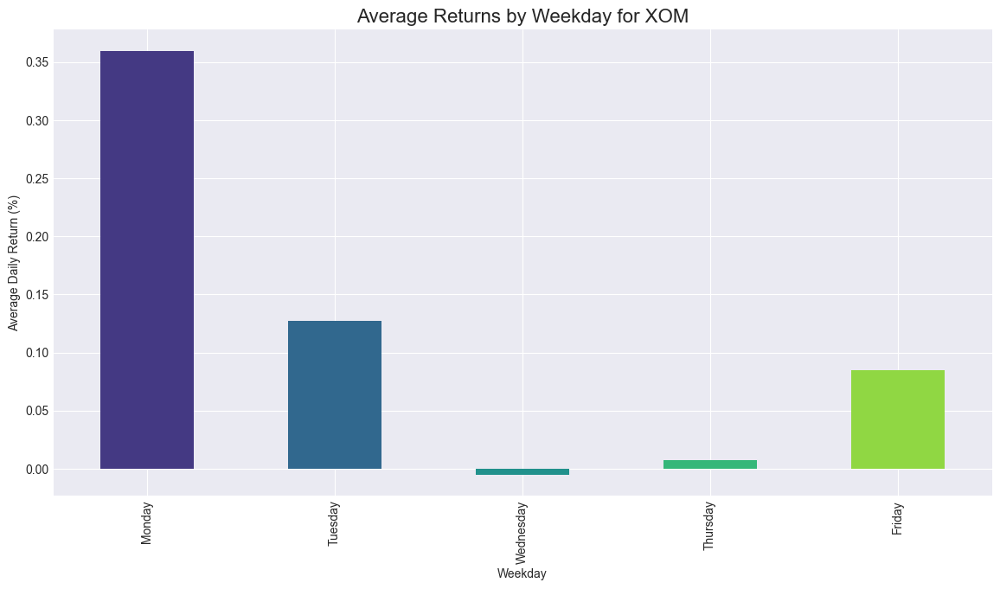

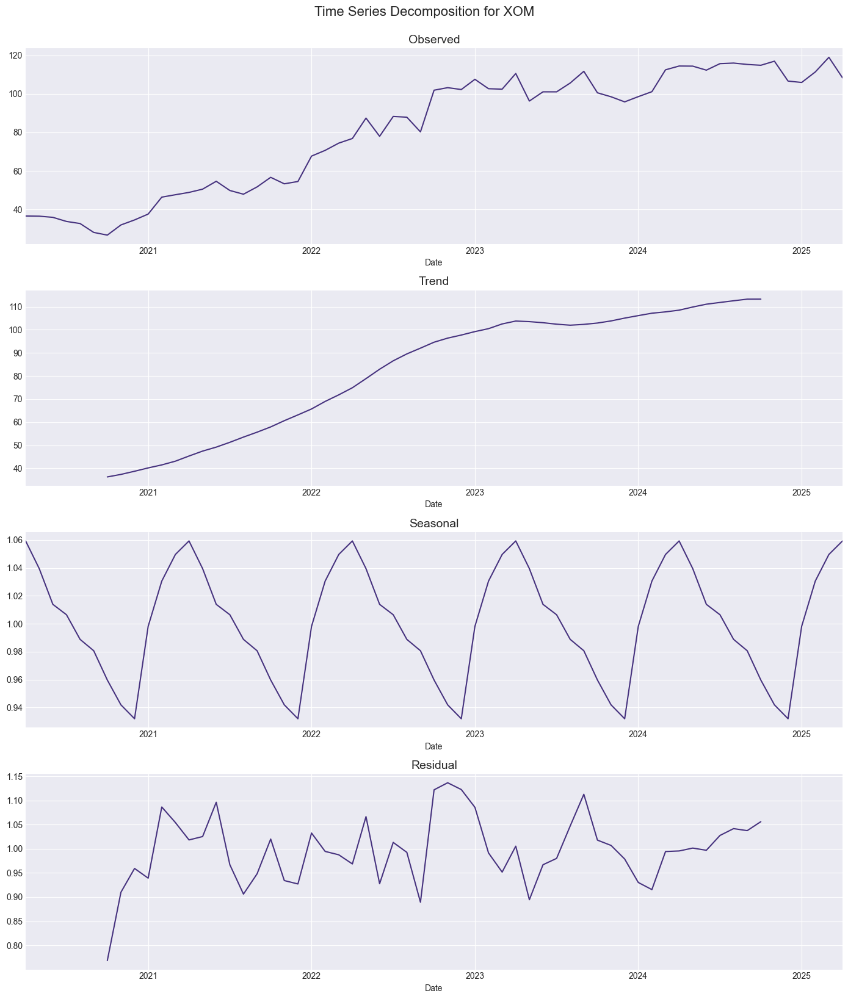

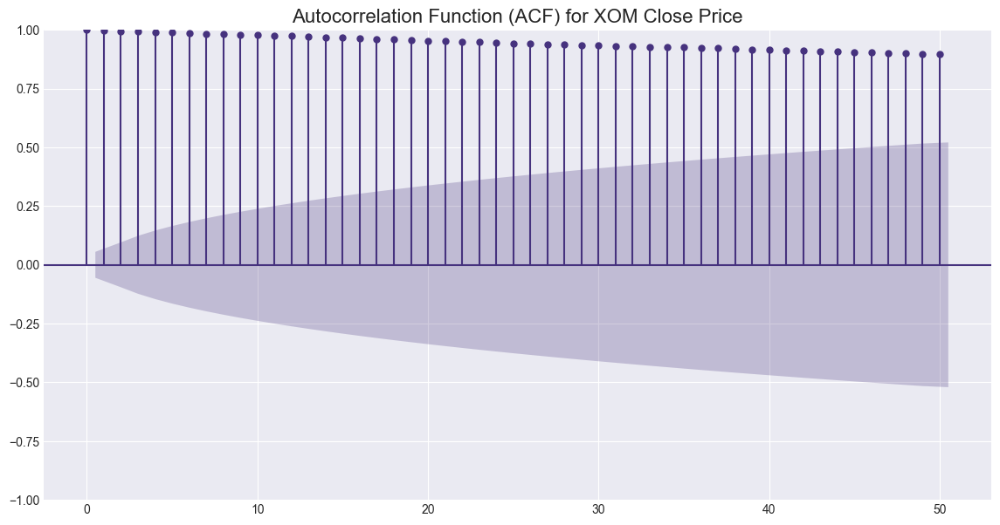

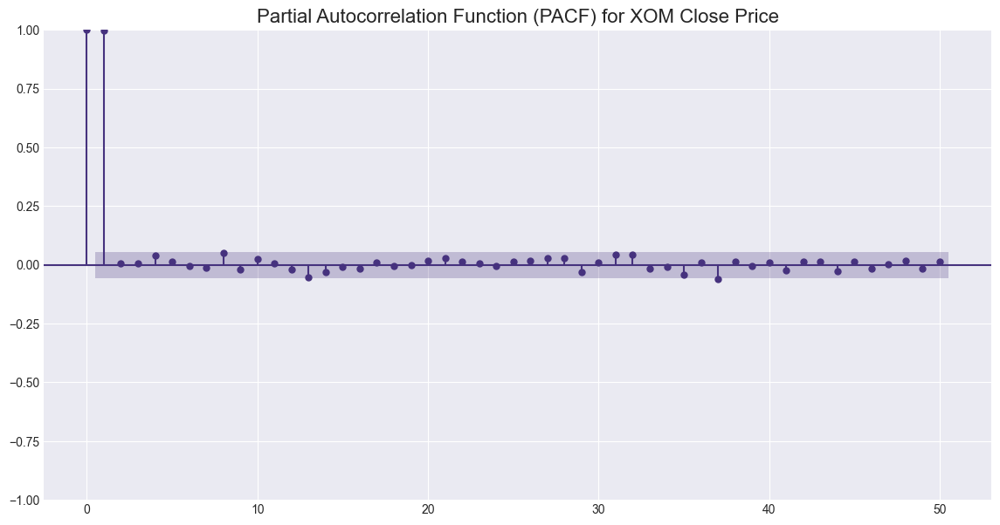


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.53      0.45      0.48       101
           1       0.56      0.64      0.60       111

    accuracy                           0.55       212
   macro avg       0.54      0.54      0.54       212
weighted avg       0.54      0.55      0.54       212



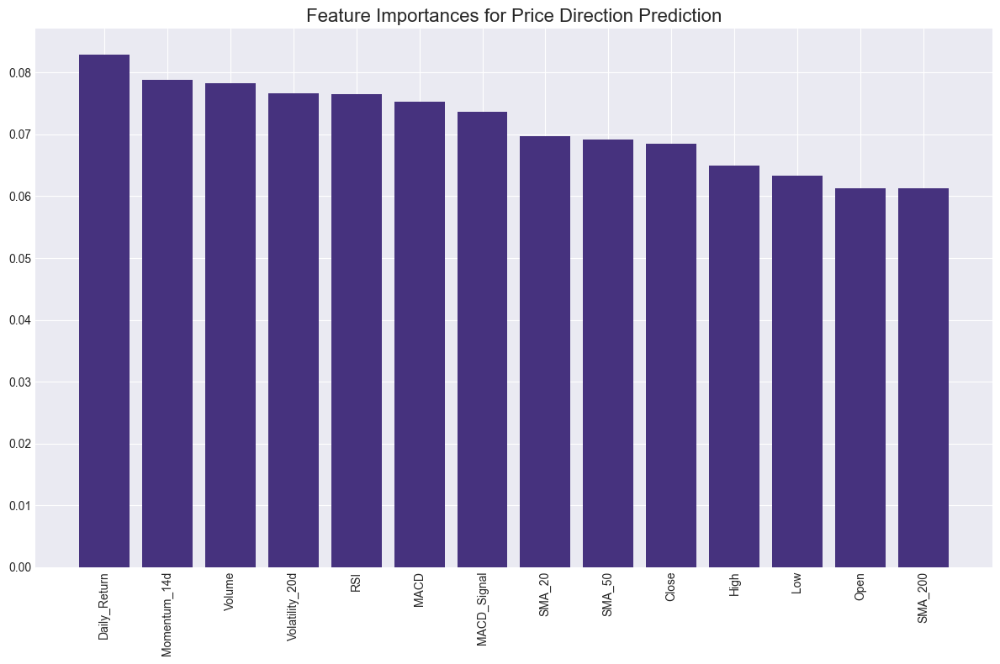


Saved processed data to XOM_data.csv

Analyzing JNJ
Downloaded 1256 rows of data

Company Information:
Company: Johnson & Johnson
Sector: Healthcare
Industry: Drug Manufacturers - General
Market Cap: $381,485,219,840
52-Week High: $169.99
52-Week Low: $140.68
Beta: 0.48
P/E Ratio: 17.547276

Price Statistics (Last 5 years):
Mean Close Price: $149.66
Standard Deviation: $10.50
Min Close Price: $120.60
Max Close Price: $170.24
Current Close Price: $157.75

Return Statistics:
Mean Daily Return: 0.0179%
Daily Return Std Dev: 1.0561%
Min Daily Return: -7.5917%
Max Daily Return: 6.0728%
Annualized Return: 4.61%
Annualized Volatility: 16.77%
Sharpe Ratio (Risk-free rate = 0%): 0.2752


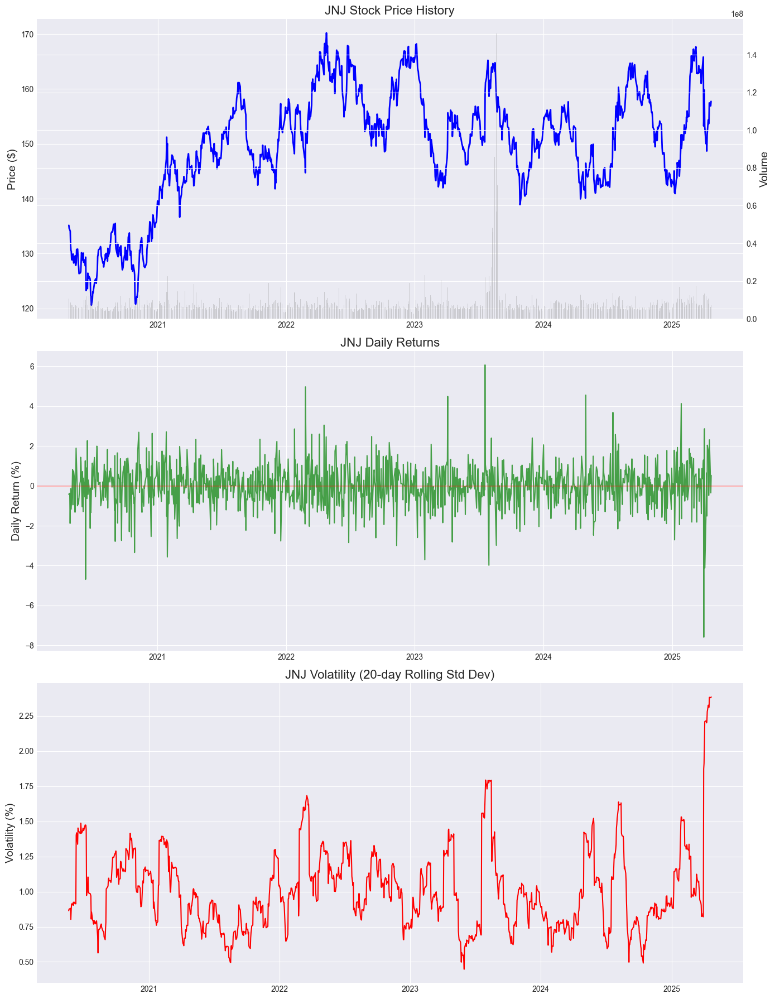

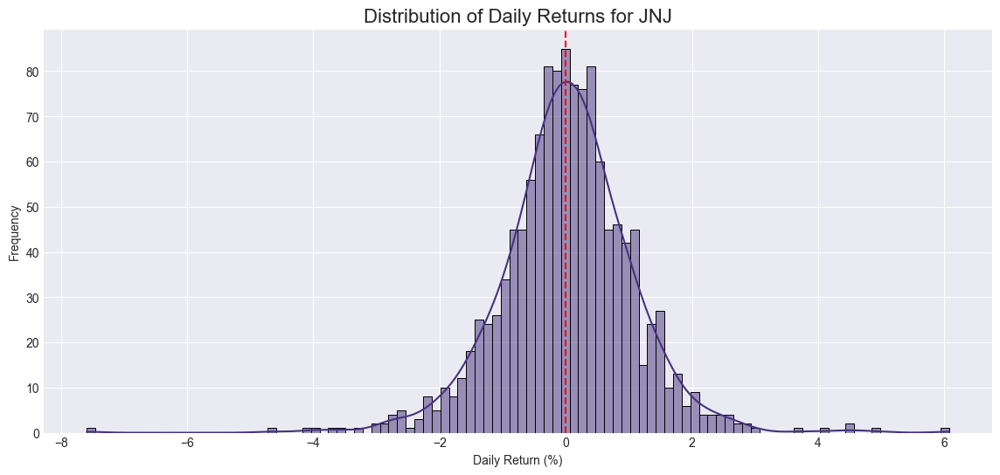

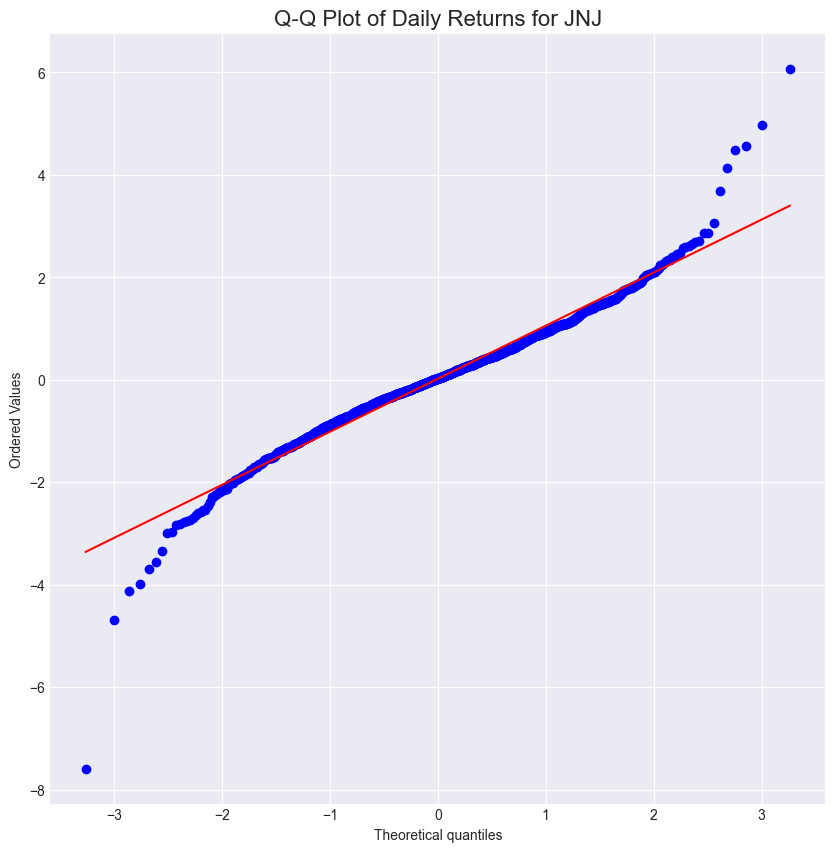

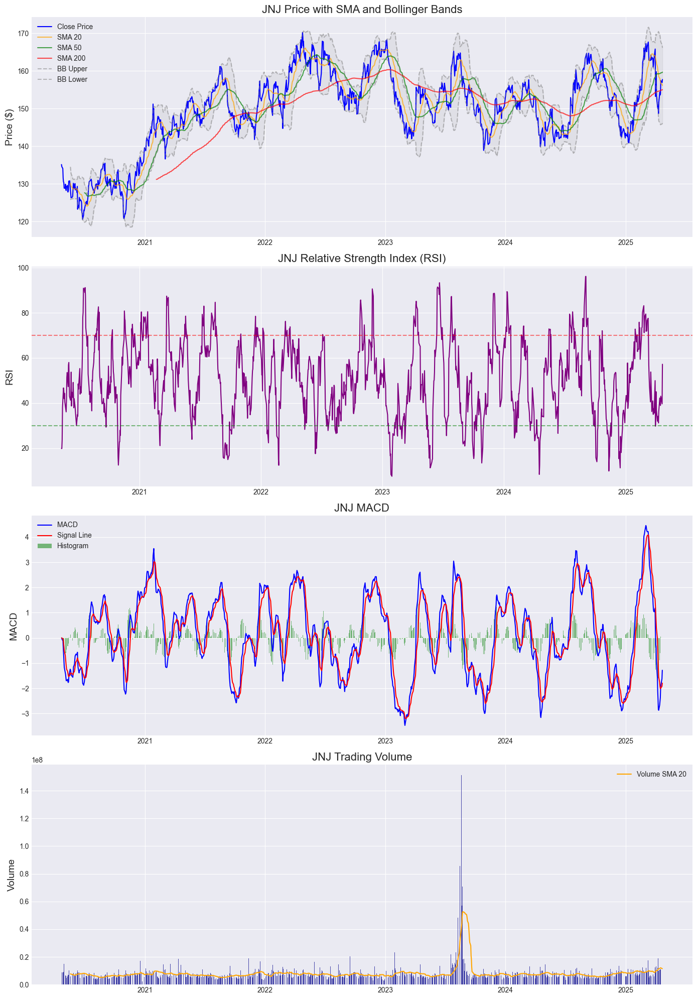

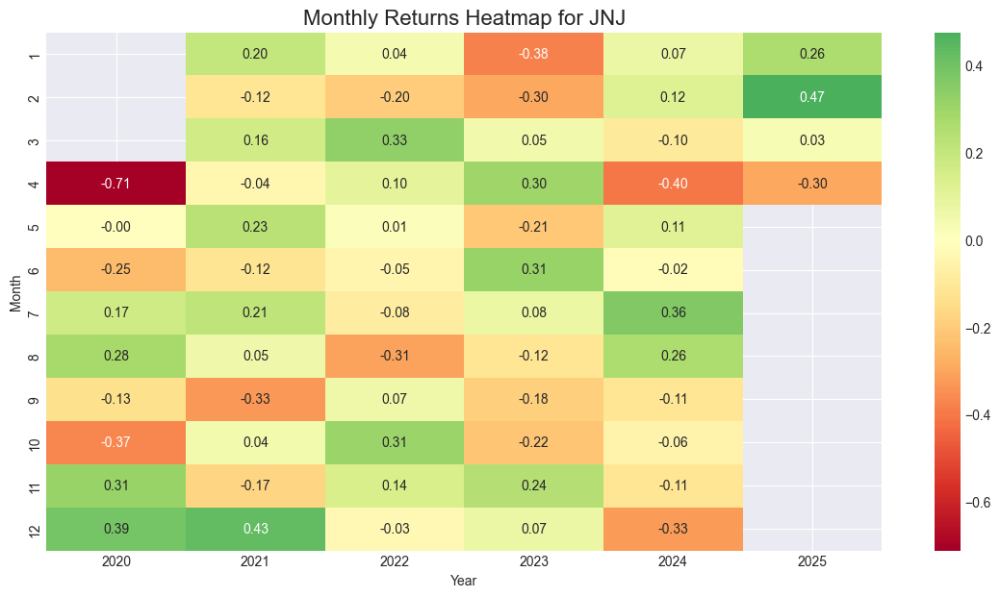

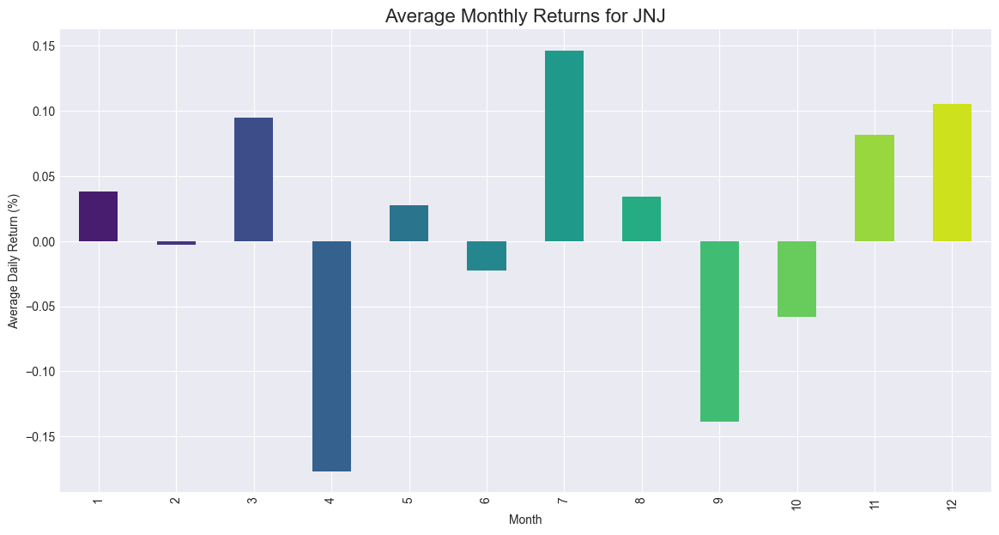

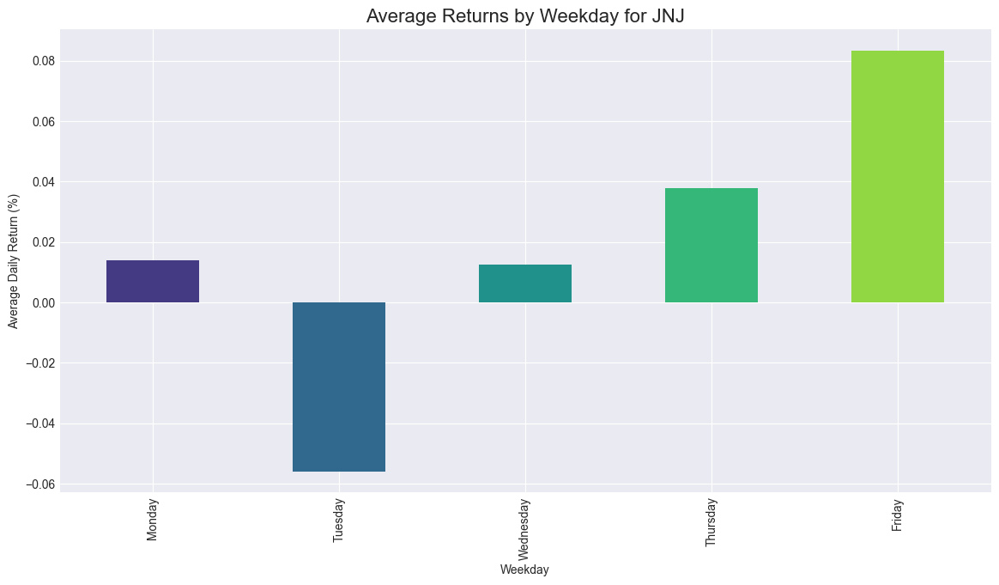

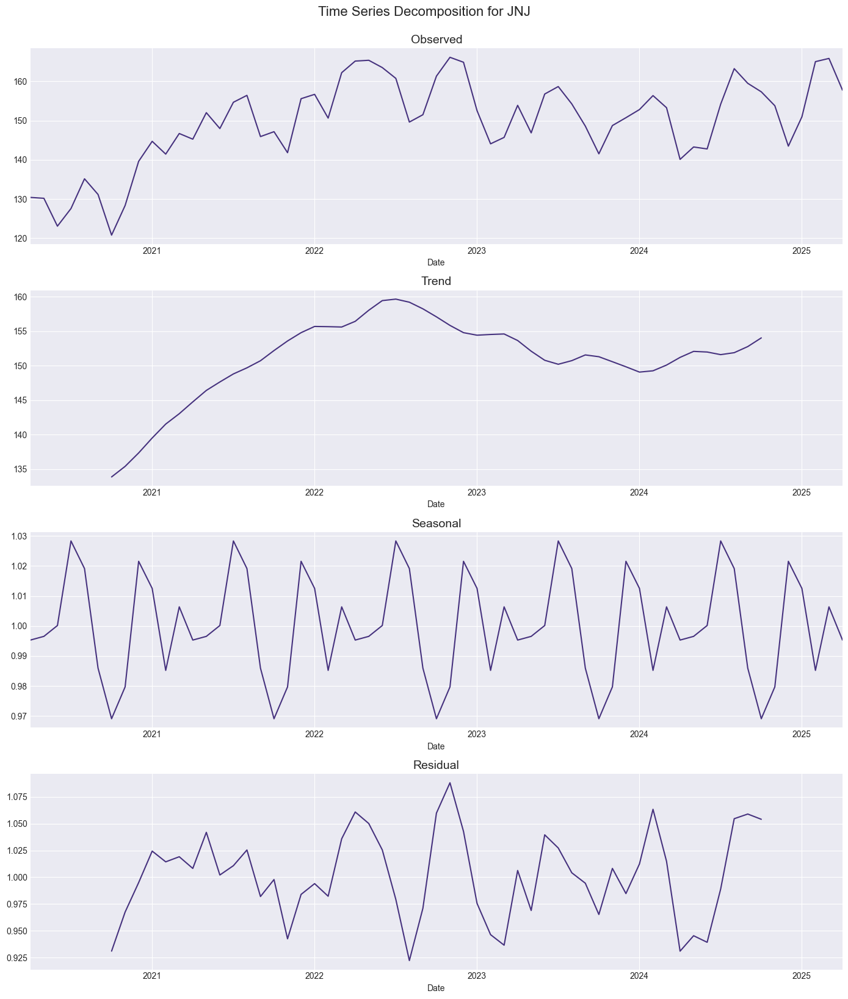

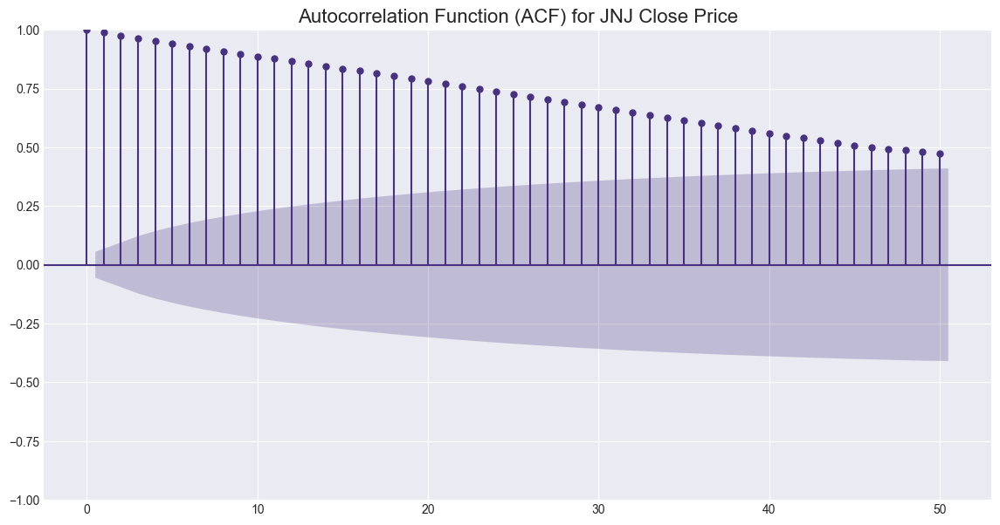

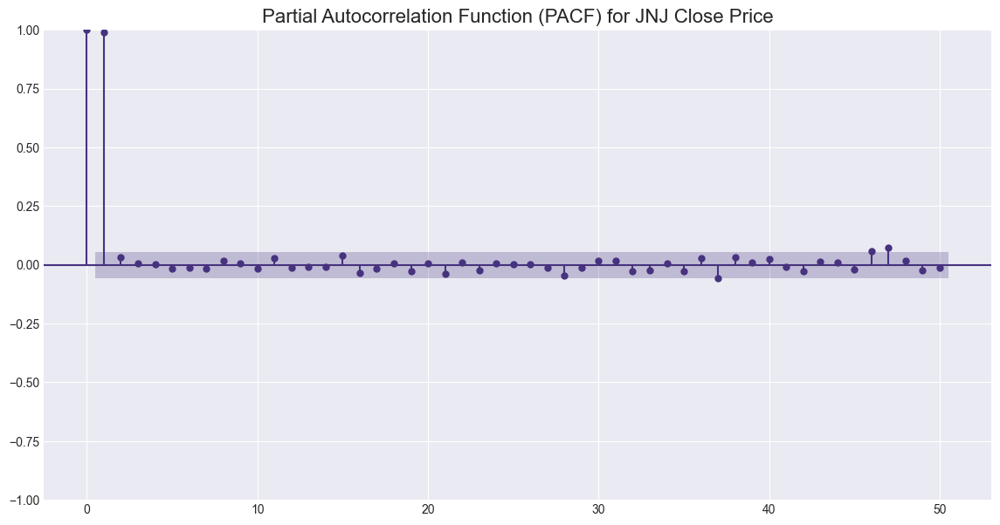


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.55      0.50      0.52       100
           1       0.59      0.63      0.61       112

    accuracy                           0.57       212
   macro avg       0.57      0.57      0.57       212
weighted avg       0.57      0.57      0.57       212



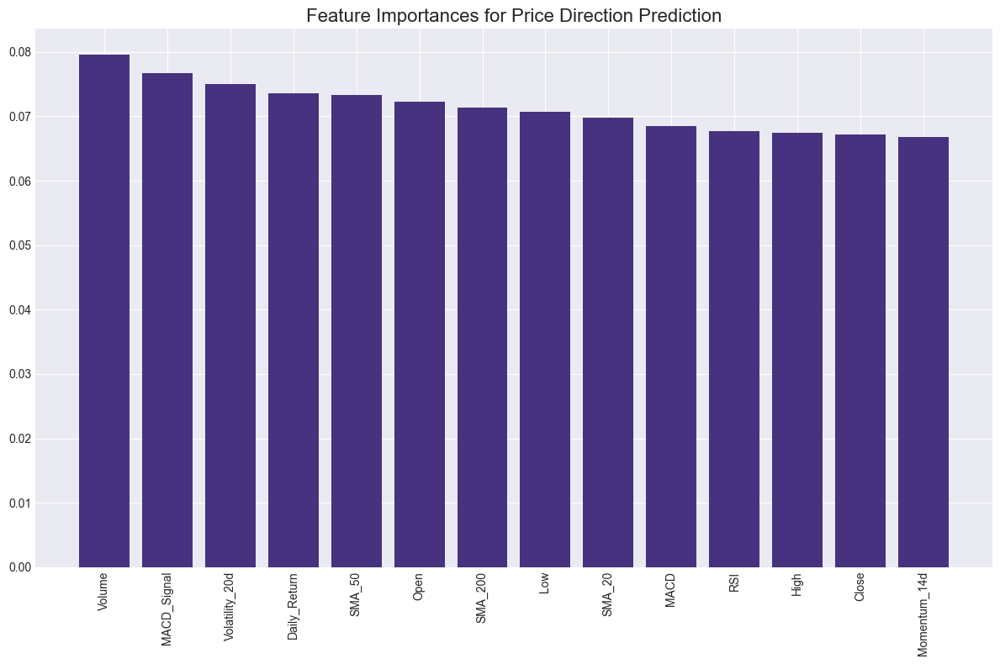


Saved processed data to JNJ_data.csv

Analyzing ACN
Downloaded 1256 rows of data

Company Information:
Company: Accenture plc
Sector: Technology
Industry: Information Technology Services
Market Cap: $179,752,632,320
52-Week High: $398.35
52-Week Low: $275.01
Beta: 1.315
P/E Ratio: 23.429043

Price Statistics (Last 5 years):
Mean Close Price: $292.94
Standard Deviation: $48.86
Min Close Price: $162.00
Max Close Price: $398.25
Current Close Price: $283.96

Return Statistics:
Mean Daily Return: 0.0585%
Daily Return Std Dev: 1.6590%
Min Daily Return: -9.3076%
Max Daily Return: 7.7241%
Annualized Return: 15.88%
Annualized Volatility: 26.34%
Sharpe Ratio (Risk-free rate = 0%): 0.6029


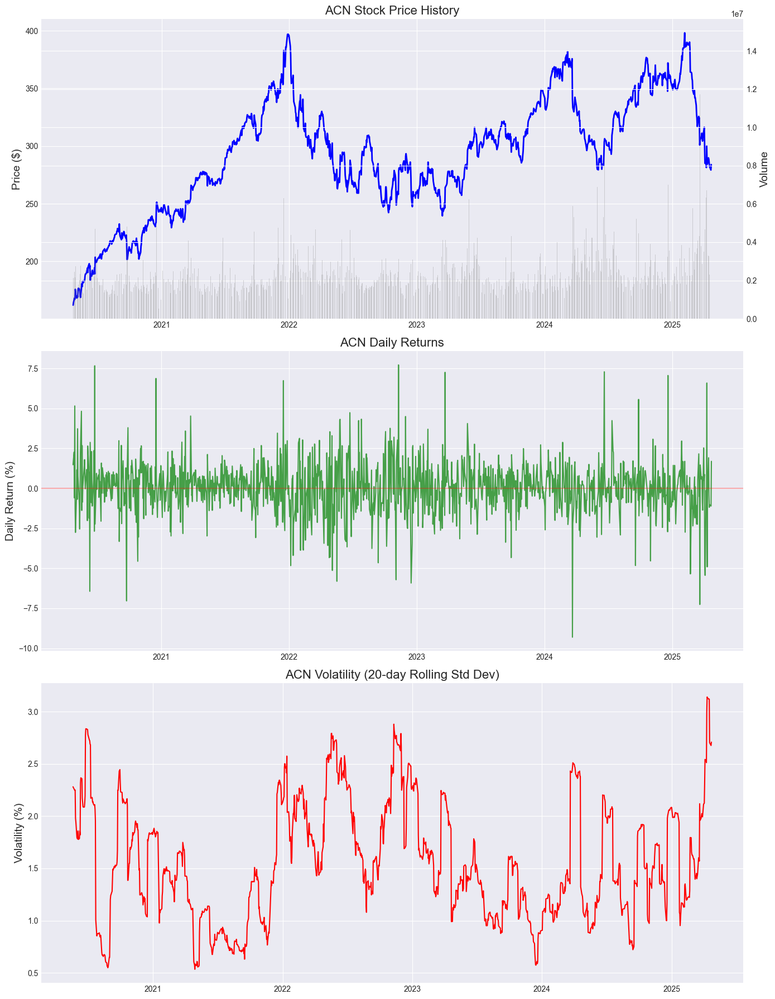

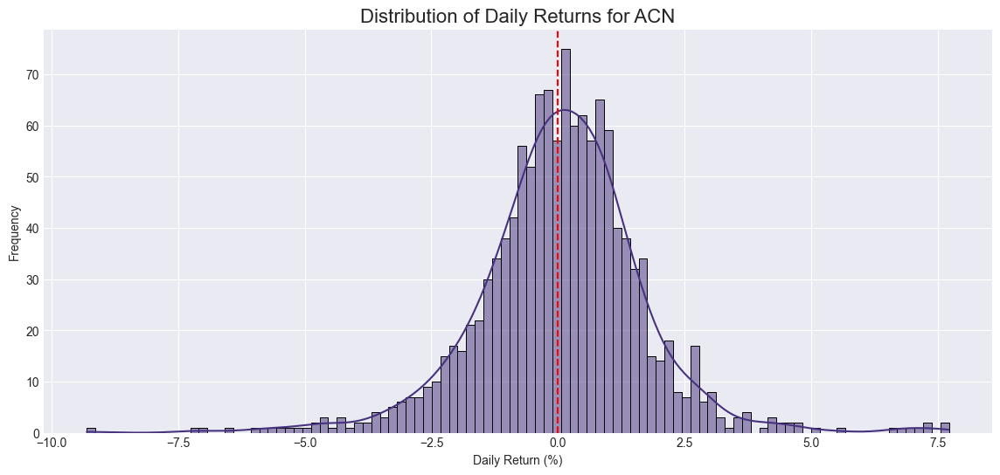

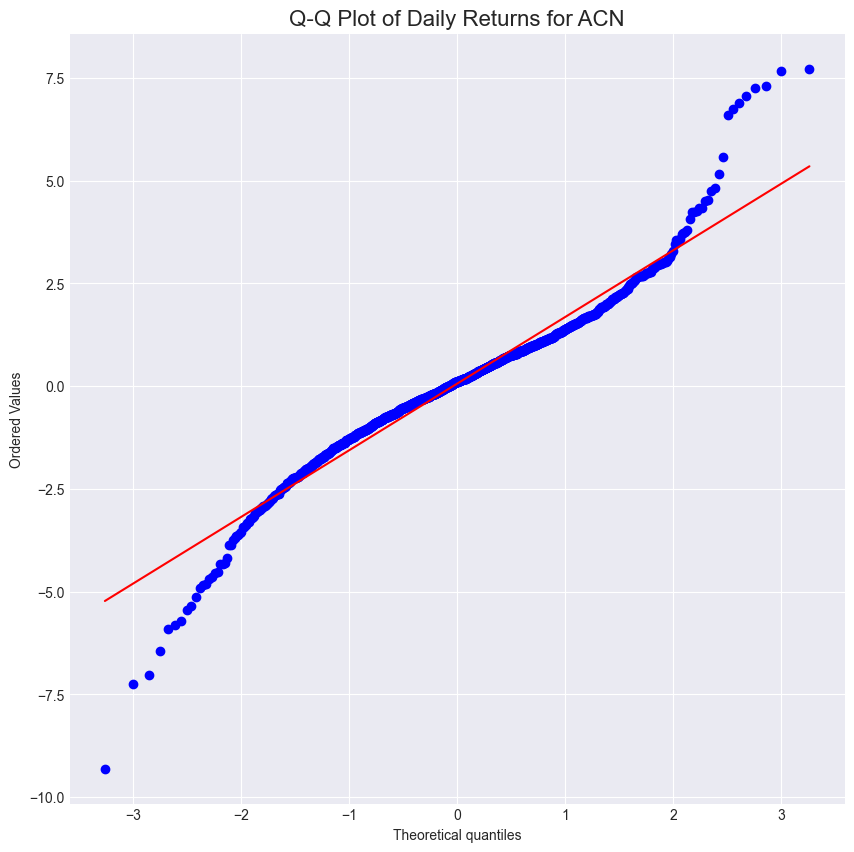

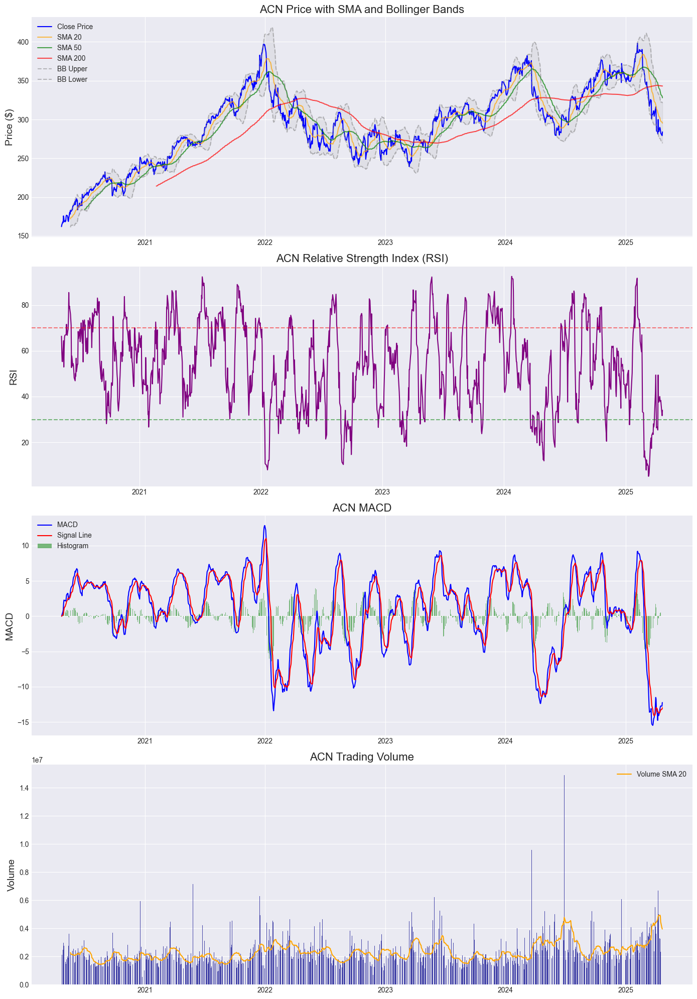

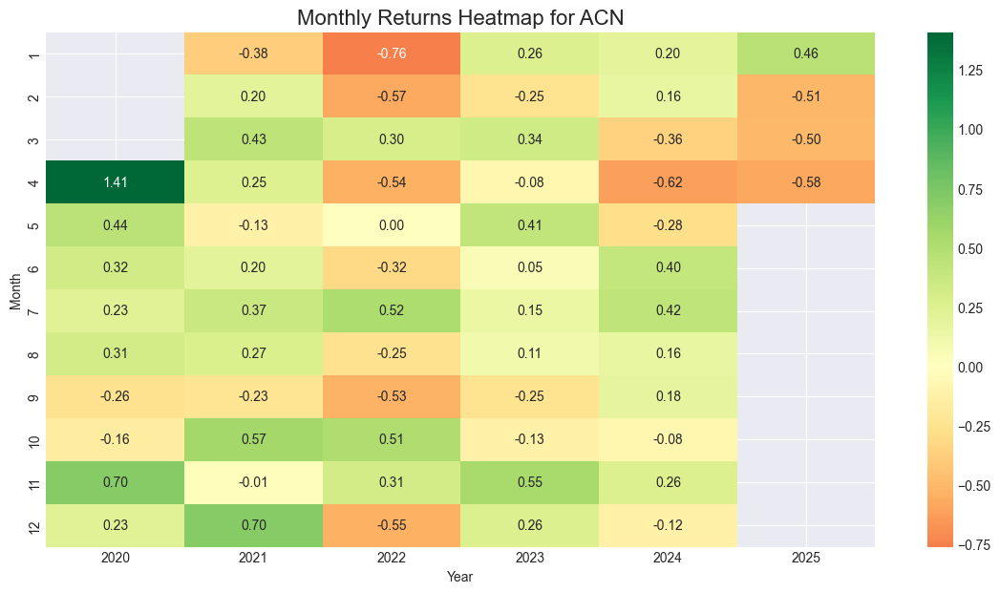

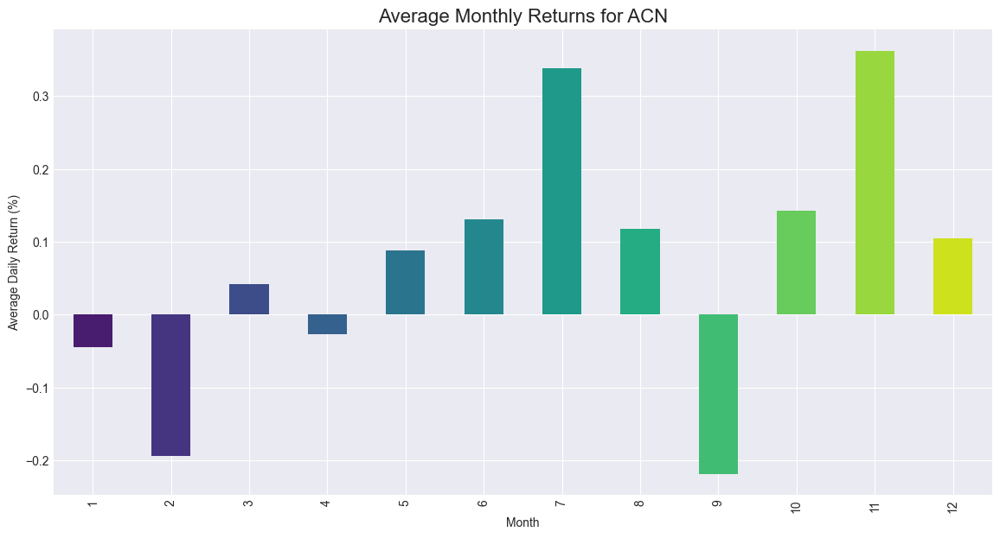

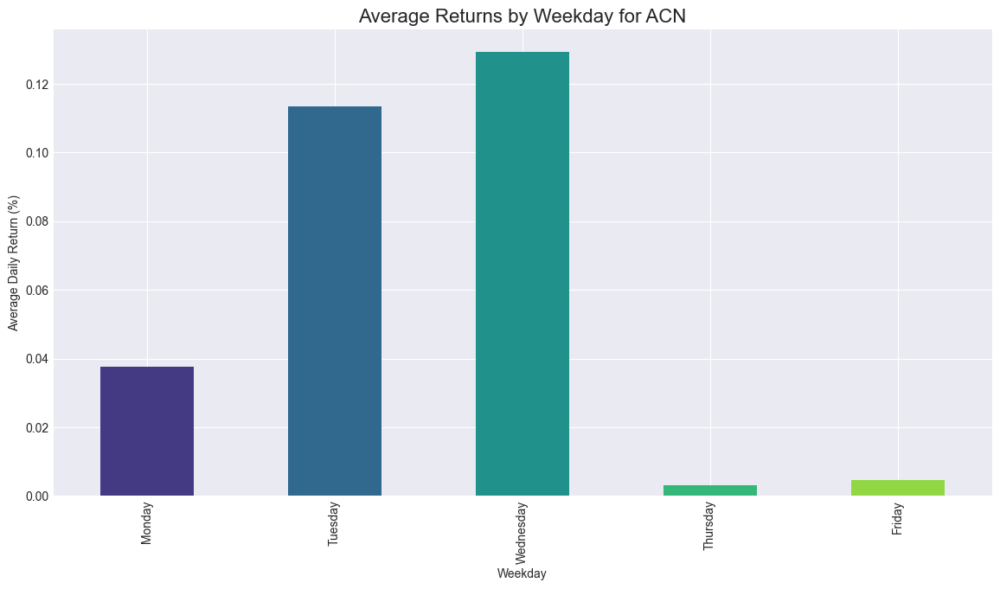

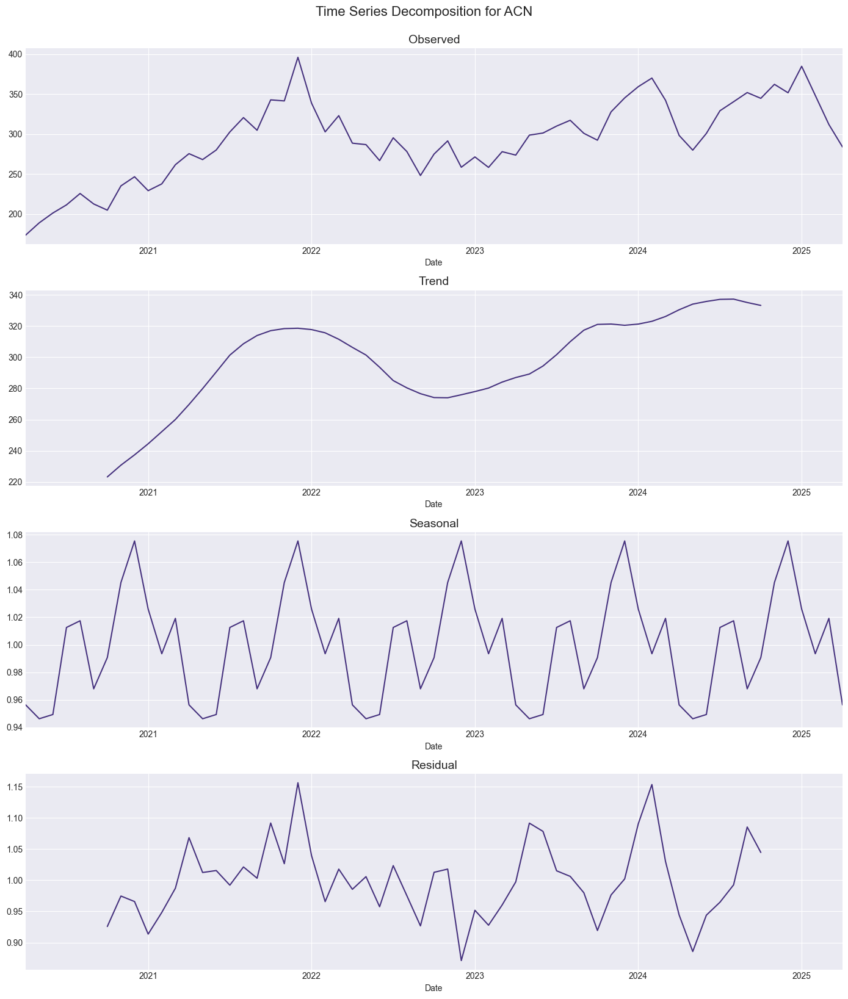

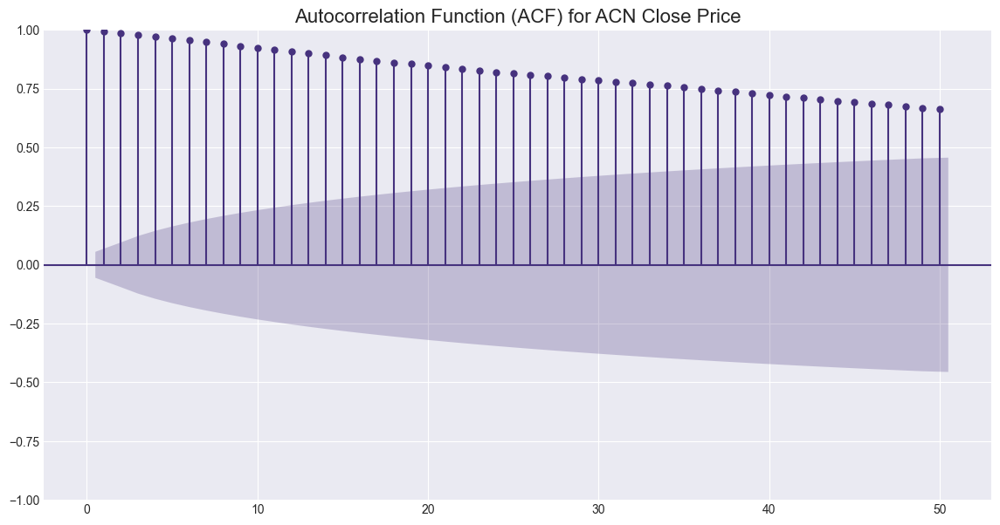

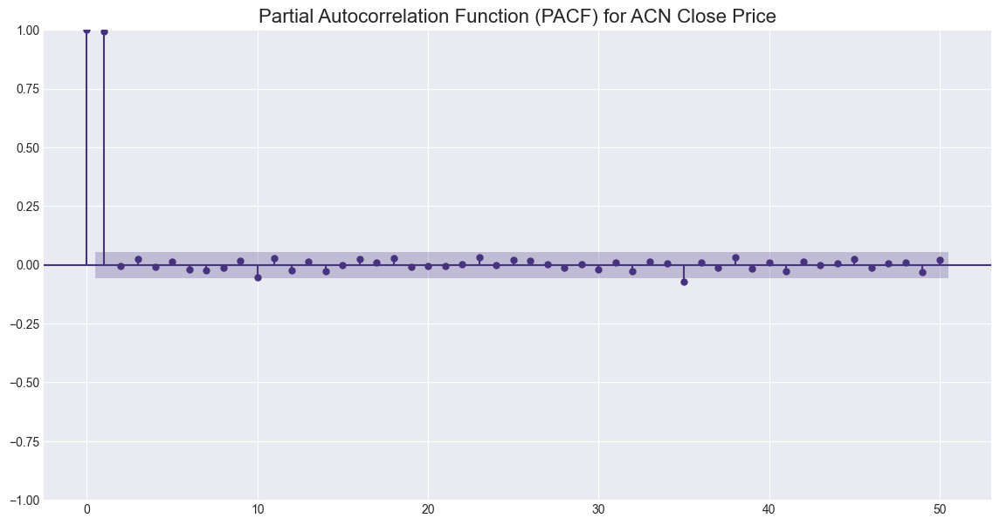


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.44      0.48      0.46        92
           1       0.57      0.53      0.55       120

    accuracy                           0.51       212
   macro avg       0.51      0.51      0.51       212
weighted avg       0.51      0.51      0.51       212



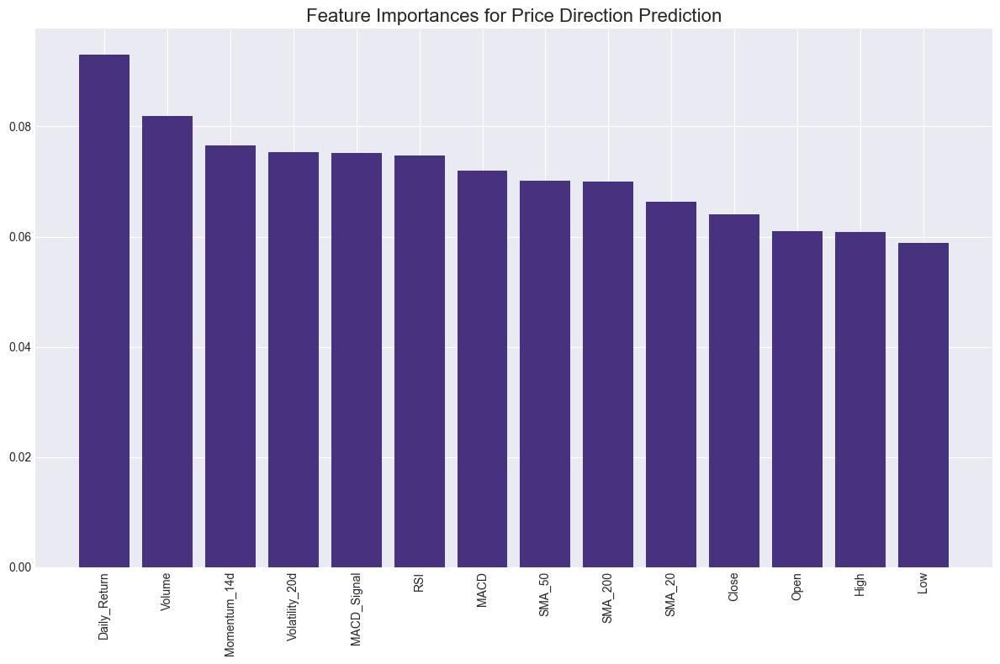


Saved processed data to ACN_data.csv

Analyzing CMCSA
Downloaded 1256 rows of data

Company Information:
Company: Comcast Corporation
Sector: Communication Services
Industry: Telecom Services
Market Cap: $130,888,876,032
52-Week High: $45.31
52-Week Low: $32.2
Beta: 0.943
P/E Ratio: 8.26087

Price Statistics (Last 5 years):
Mean Close Price: $40.48
Standard Deviation: $5.75
Min Close Price: $26.58
Max Close Price: $55.51
Current Close Price: $34.20

Return Statistics:
Mean Daily Return: 0.0201%
Daily Return Std Dev: 1.6659%
Min Daily Return: -11.0011%
Max Daily Return: 10.2684%
Annualized Return: 5.20%
Annualized Volatility: 26.45%
Sharpe Ratio (Risk-free rate = 0%): 0.1965


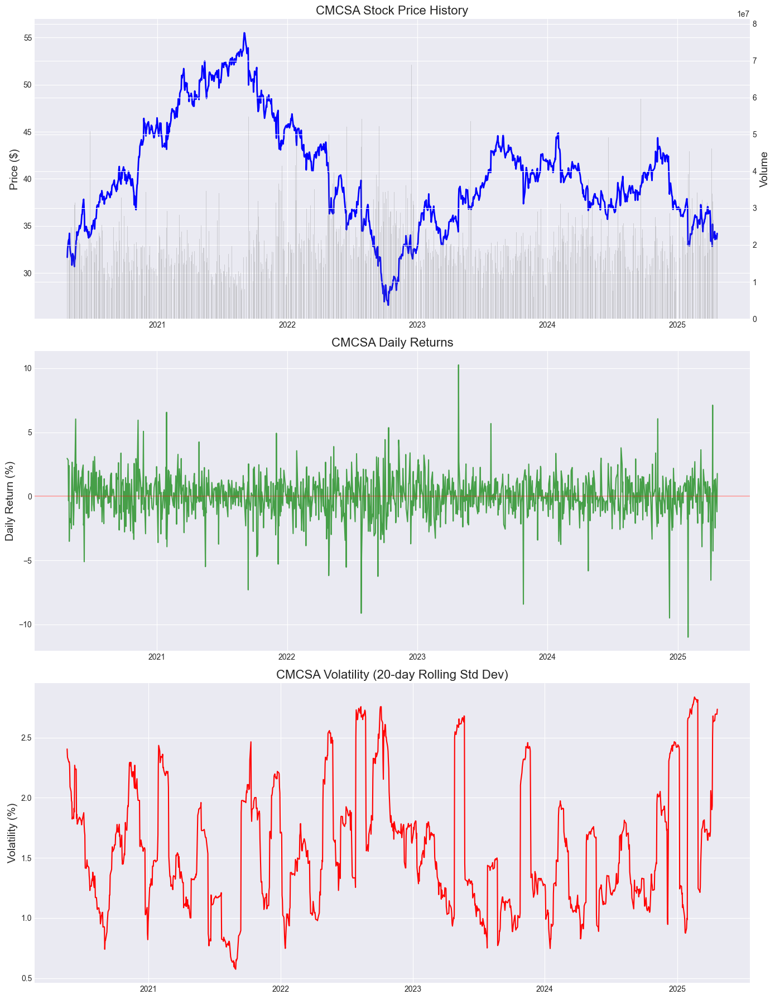

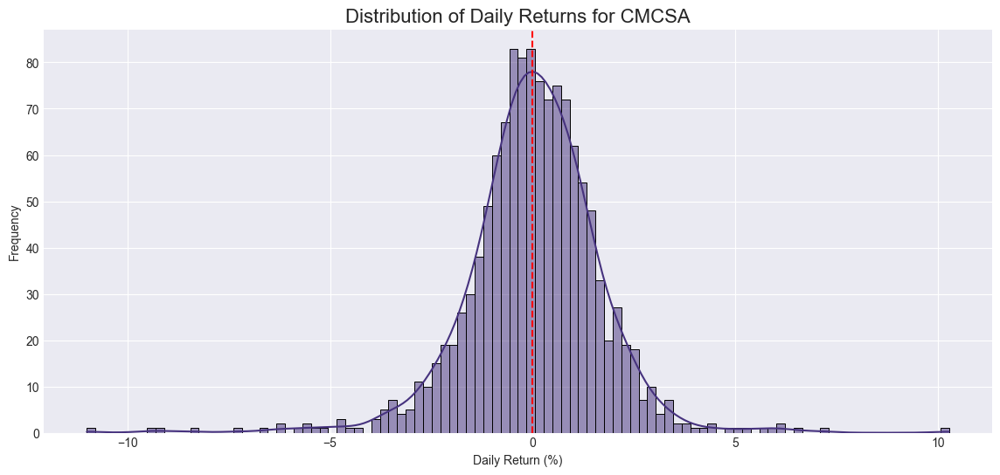

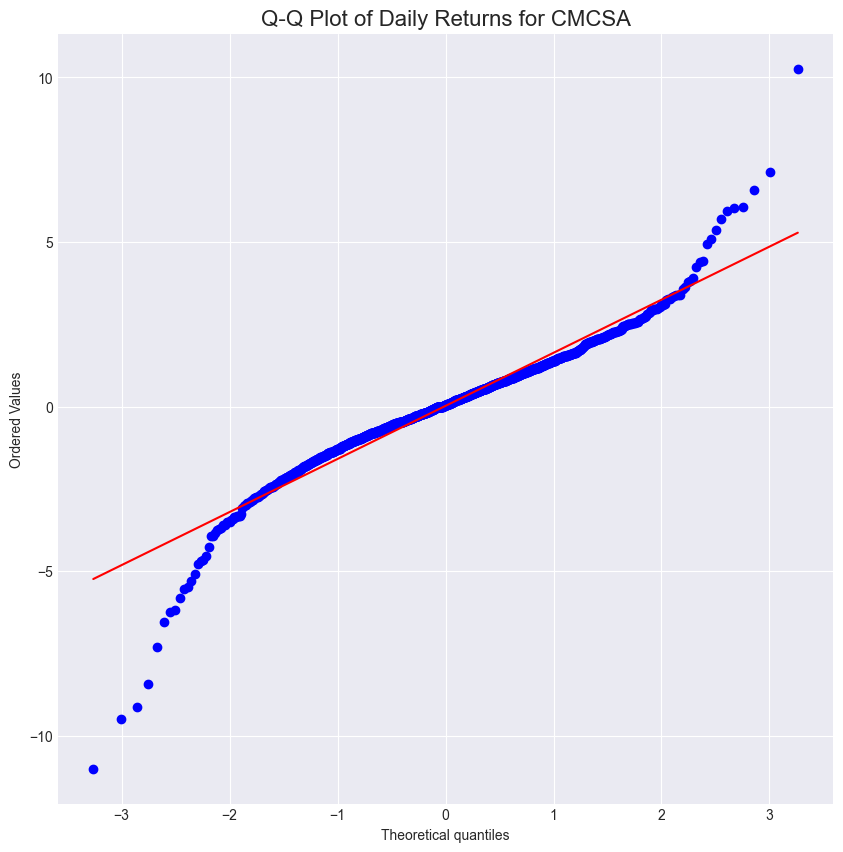

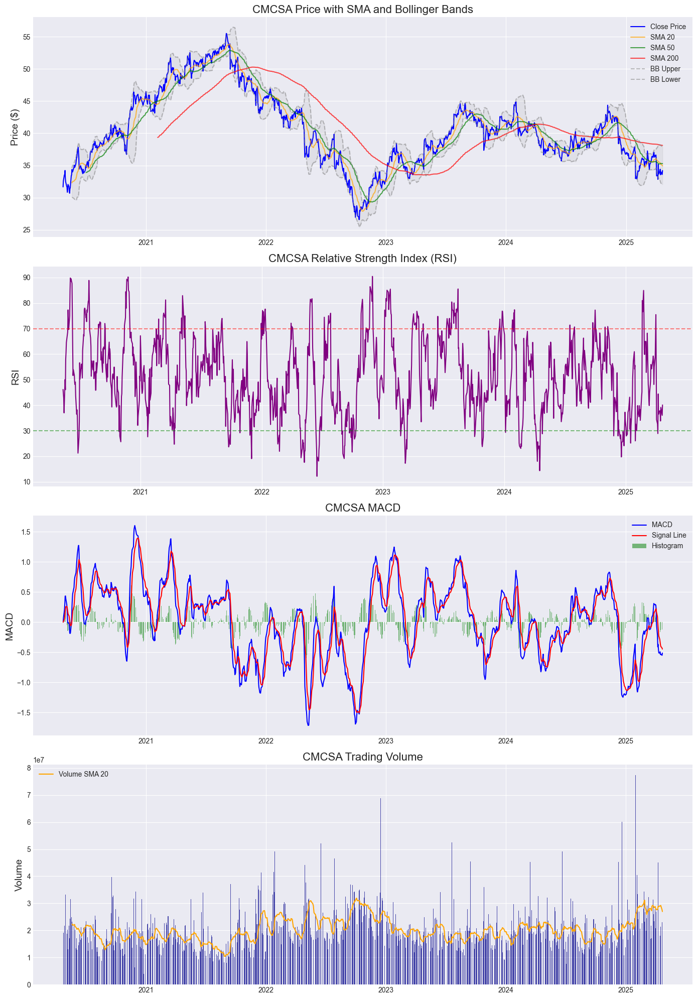

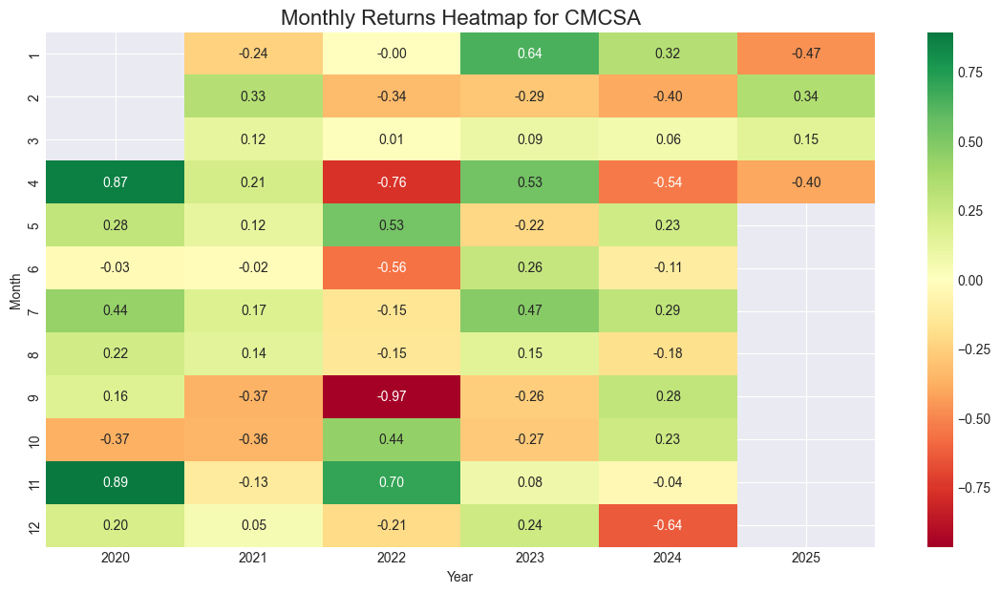

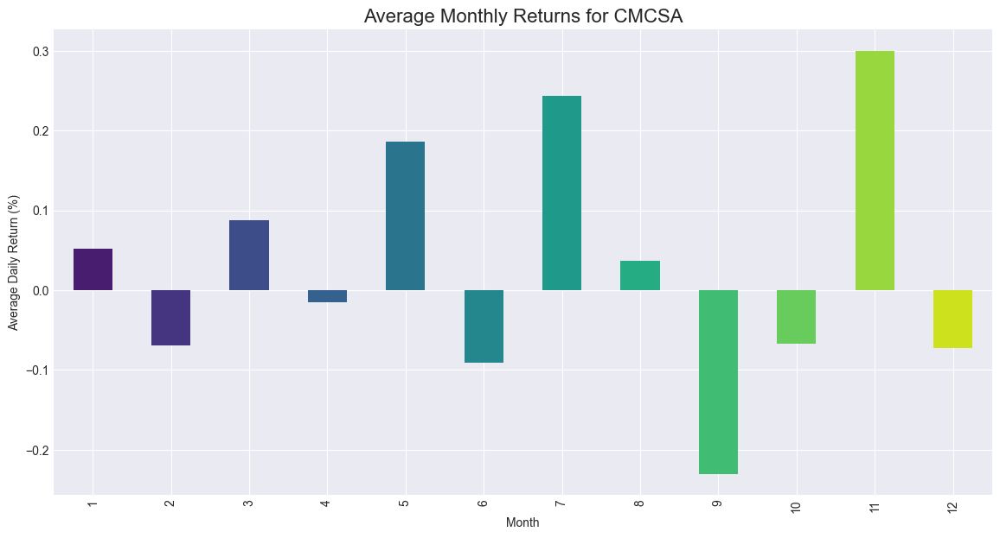

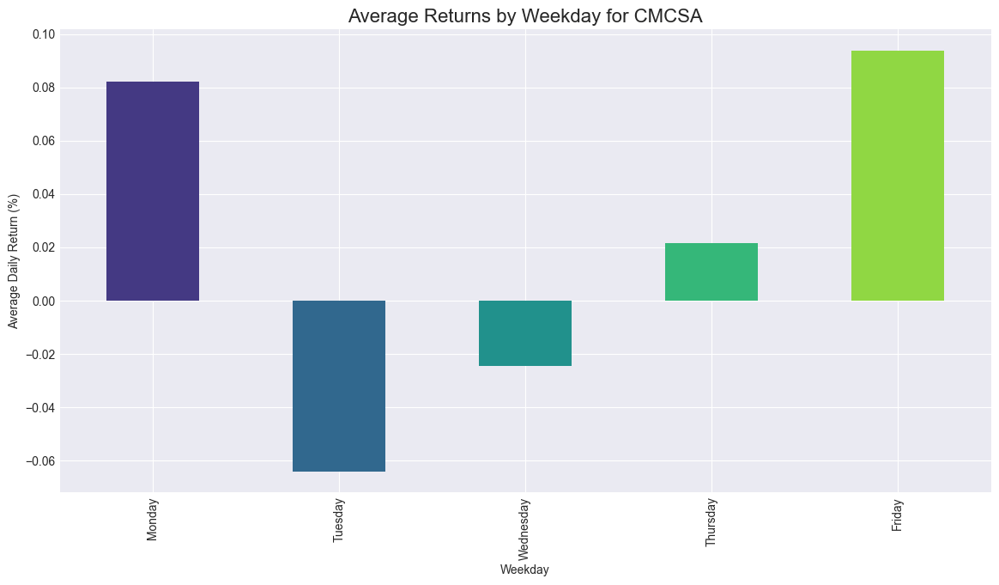

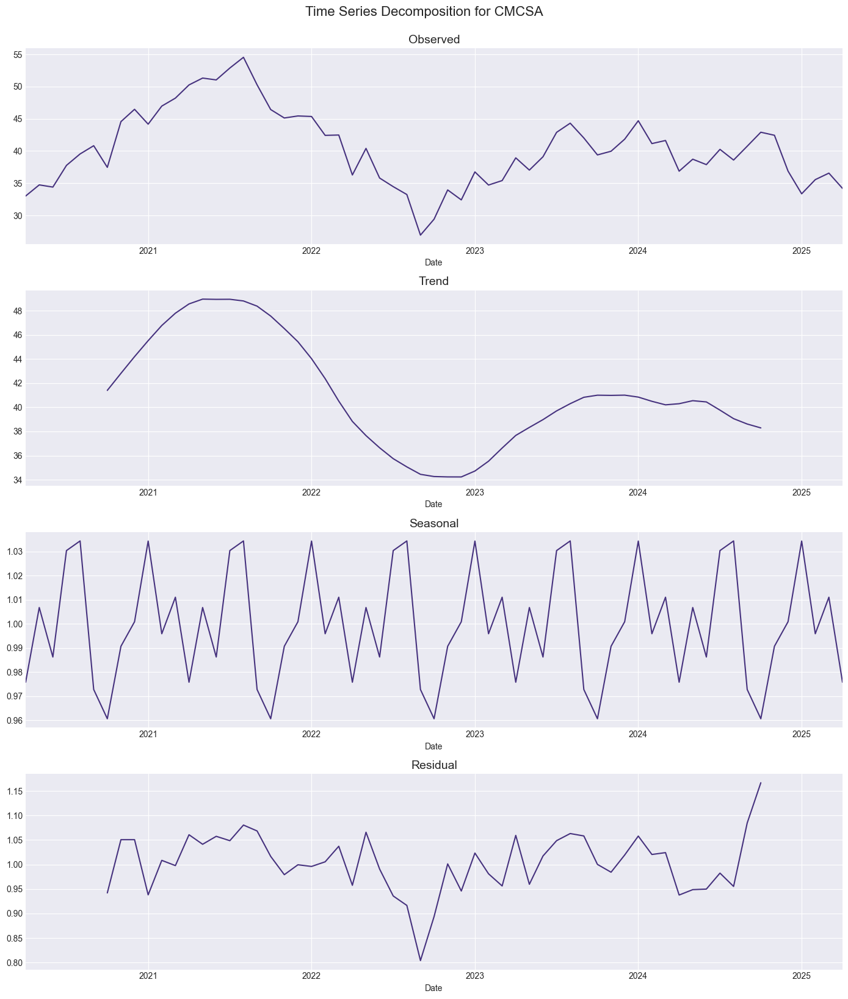

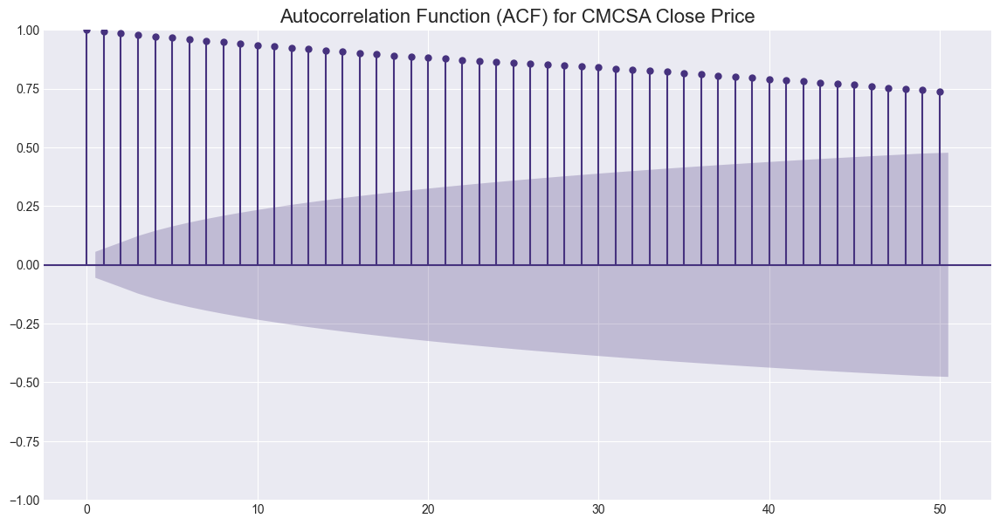

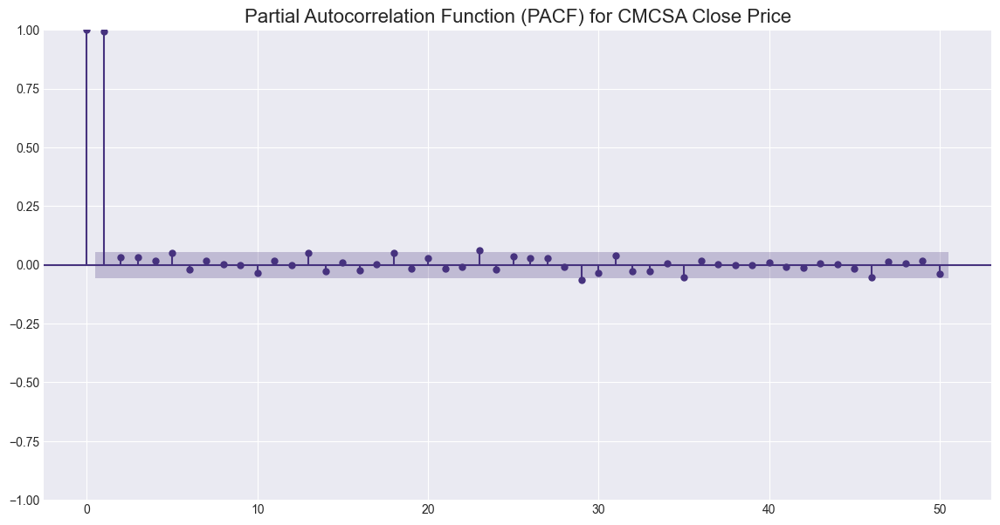


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.36      0.53      0.43        88
           1       0.49      0.32      0.39       124

    accuracy                           0.41       212
   macro avg       0.43      0.43      0.41       212
weighted avg       0.44      0.41      0.41       212



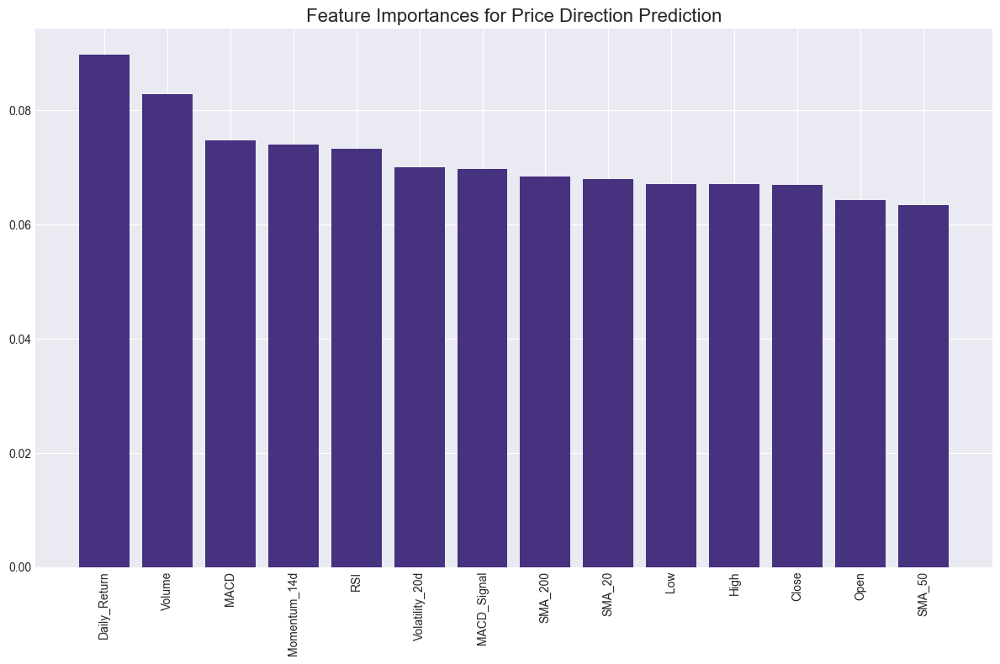


Saved processed data to CMCSA_data.csv

Analyzing LMT
Downloaded 1256 rows of data

Company Information:
Company: Lockheed Martin Corporation
Sector: Industrials
Industry: Aerospace & Defense
Market Cap: $109,751,386,112
52-Week High: $618.95
52-Week Low: $418.88
Beta: 0.388
P/E Ratio: 20.702509

Price Statistics (Last 5 years):
Mean Close Price: $402.97
Standard Deviation: $69.00
Min Close Price: $286.66
Max Close Price: $606.30
Current Close Price: $462.08

Return Statistics:
Mean Daily Return: 0.0368%
Daily Return Std Dev: 1.3991%
Min Daily Return: -11.8035%
Max Daily Return: 8.9337%
Annualized Return: 9.73%
Annualized Volatility: 22.21%
Sharpe Ratio (Risk-free rate = 0%): 0.4379


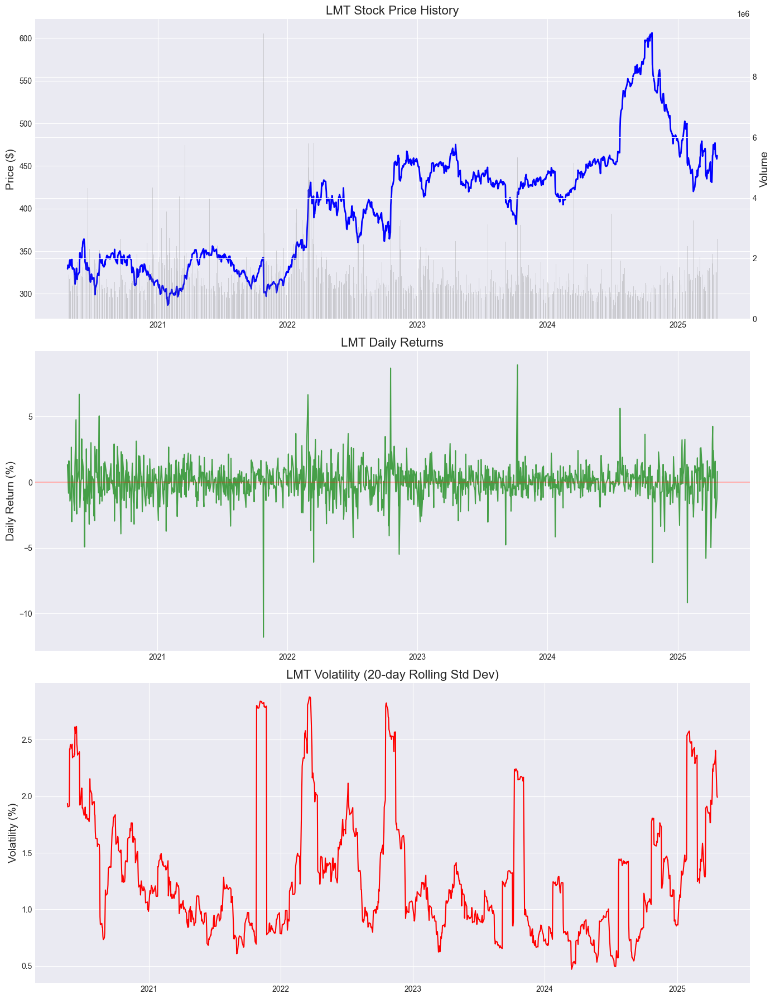

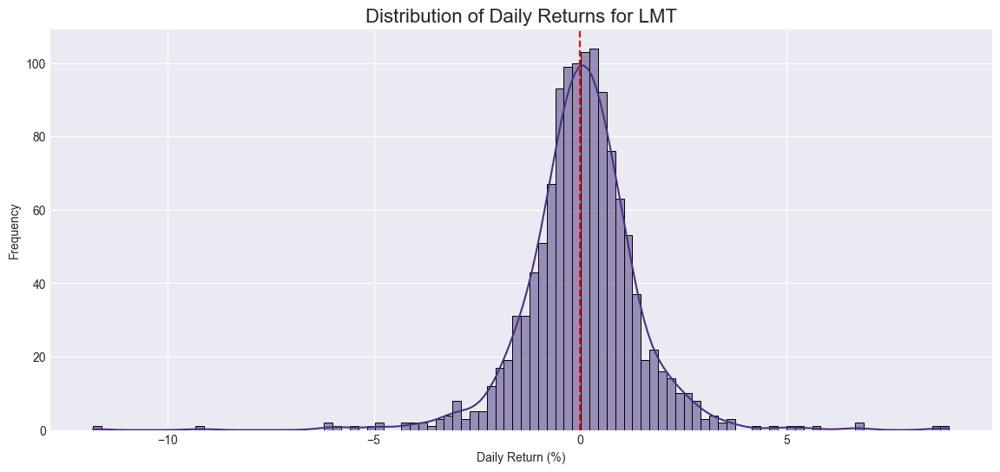

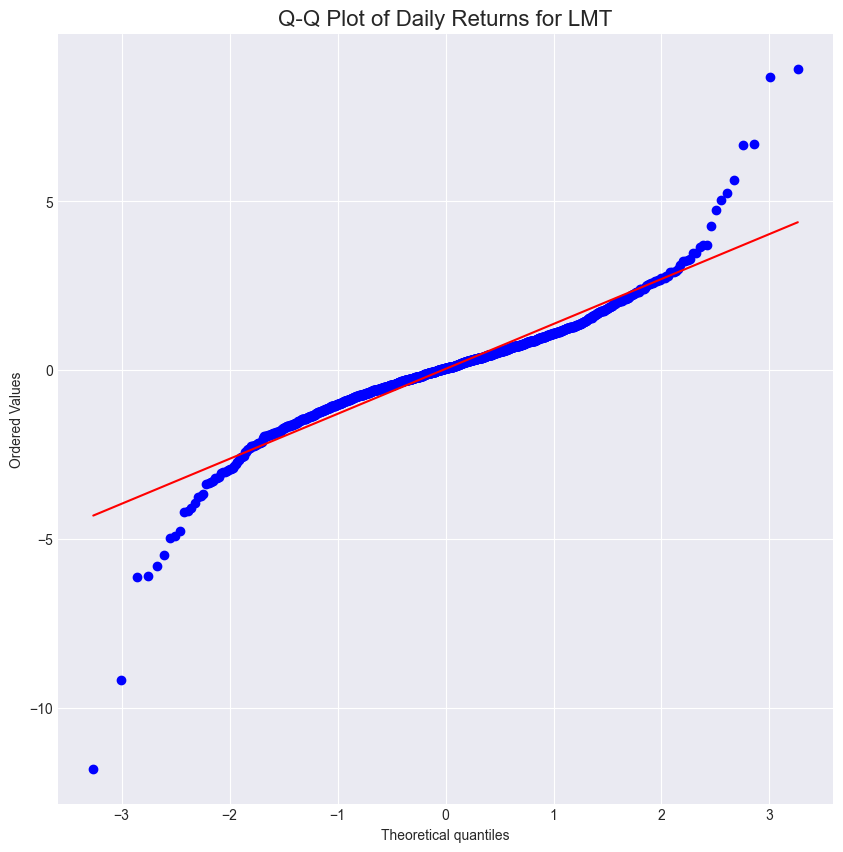

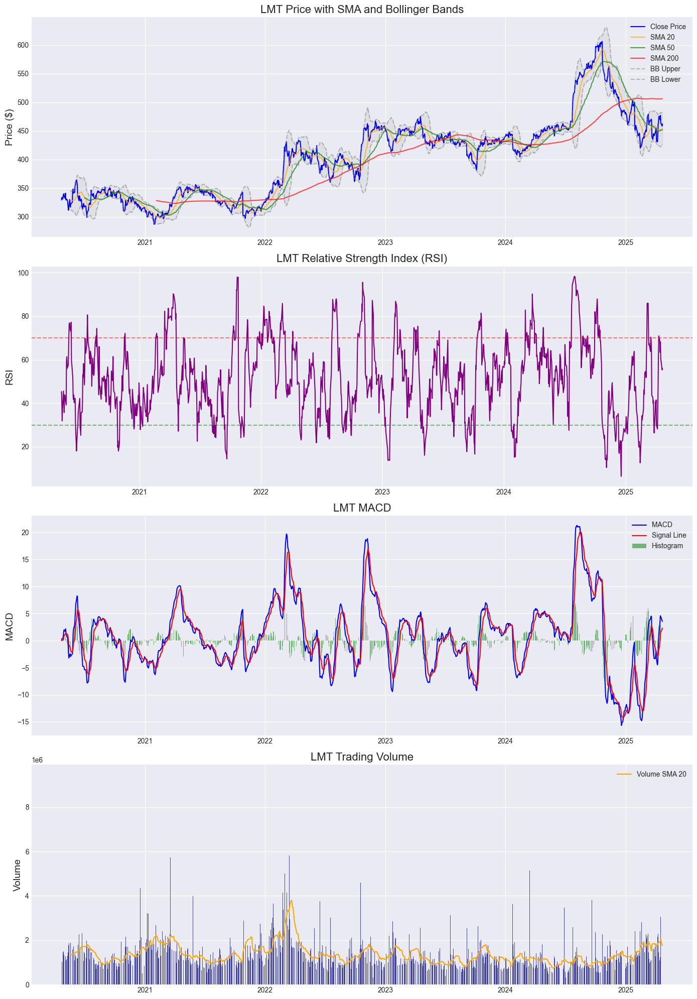

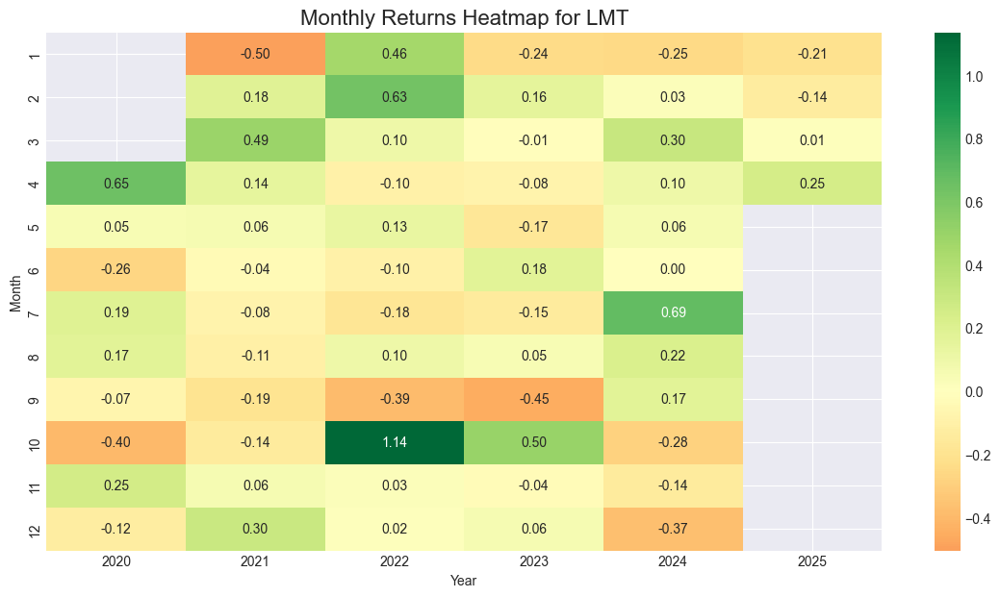

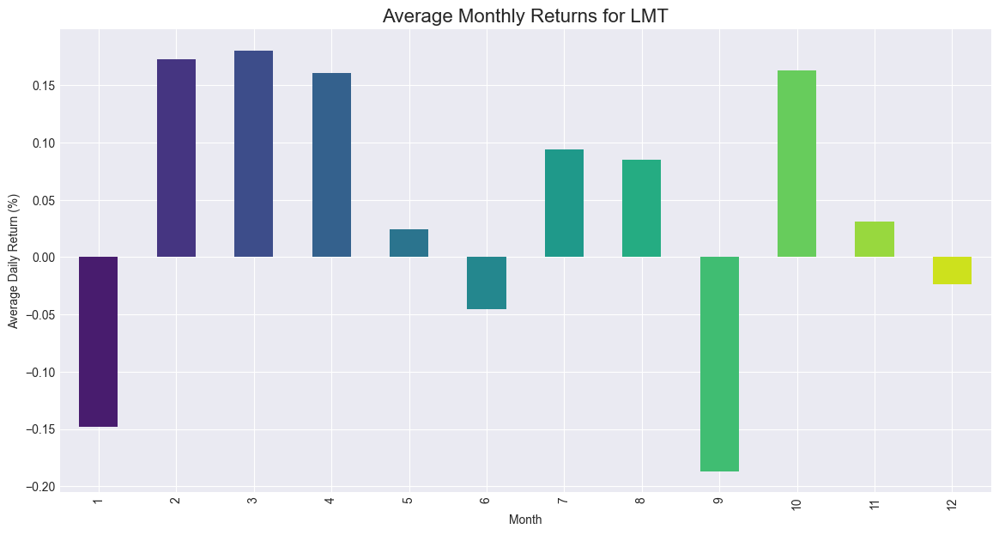

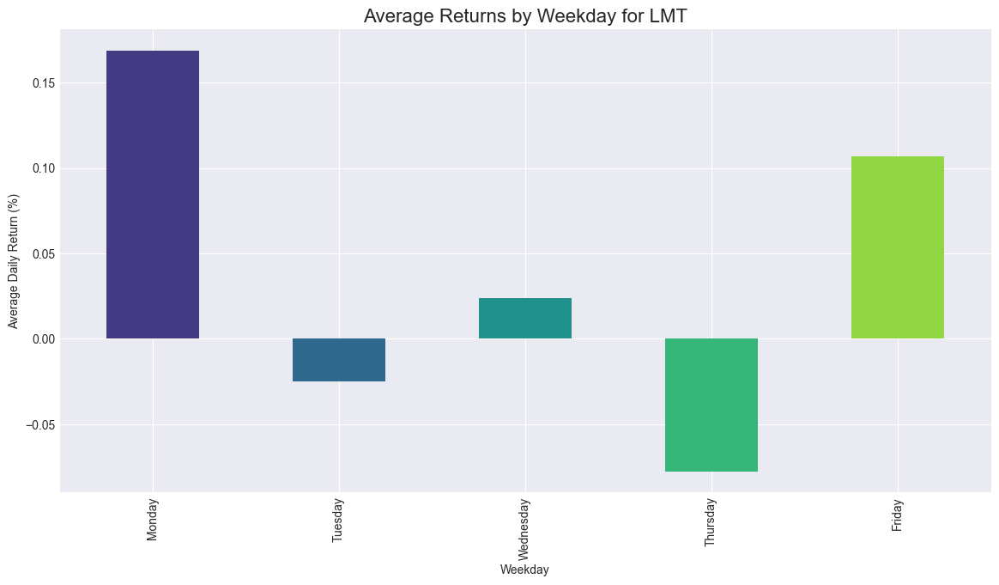

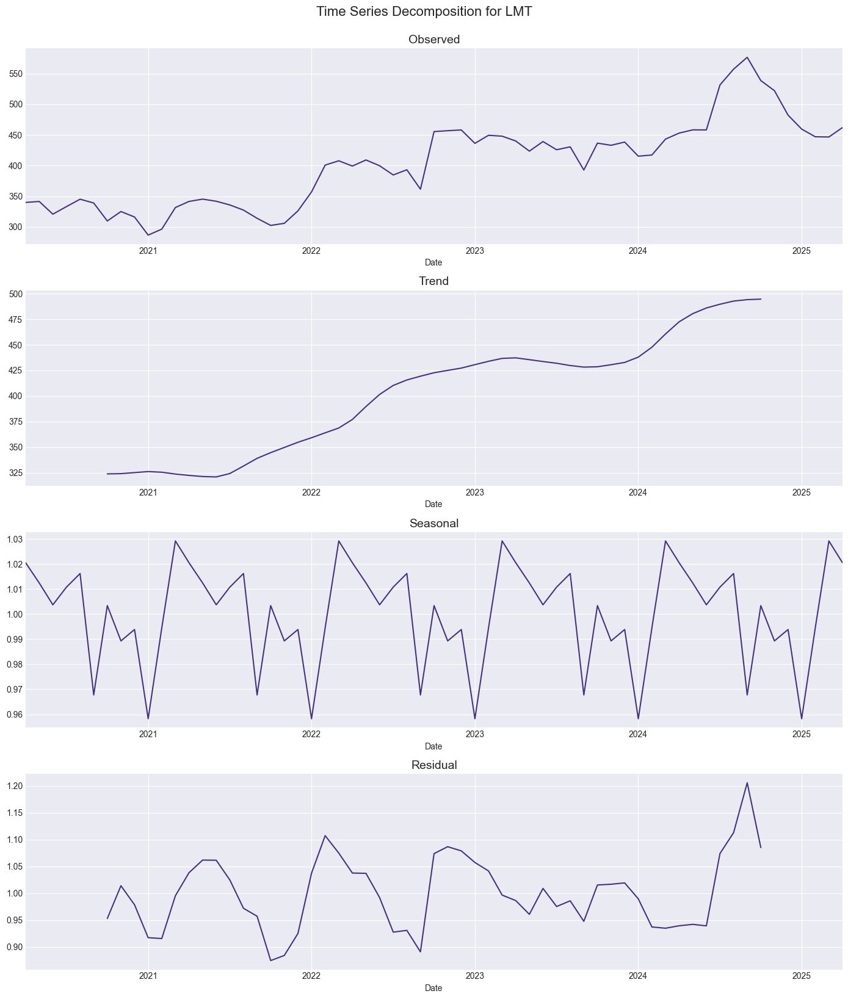

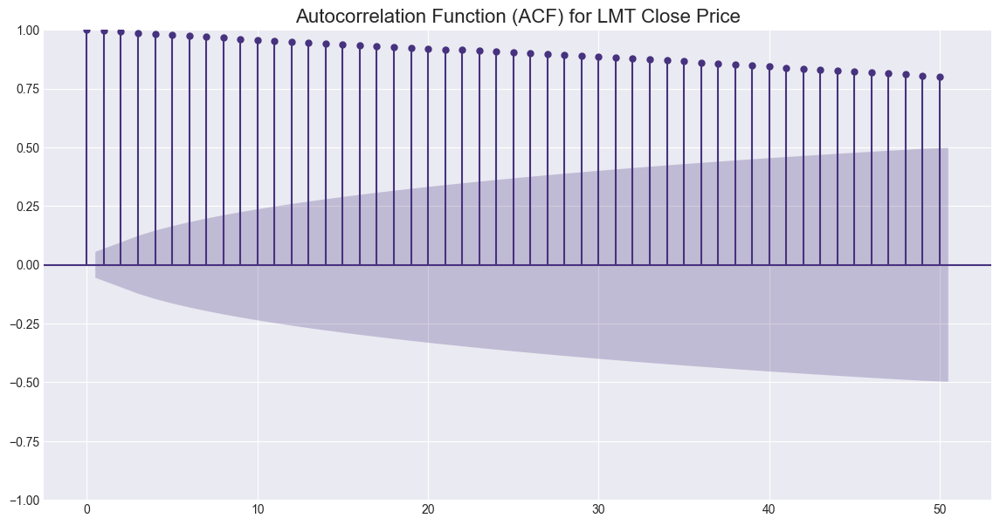

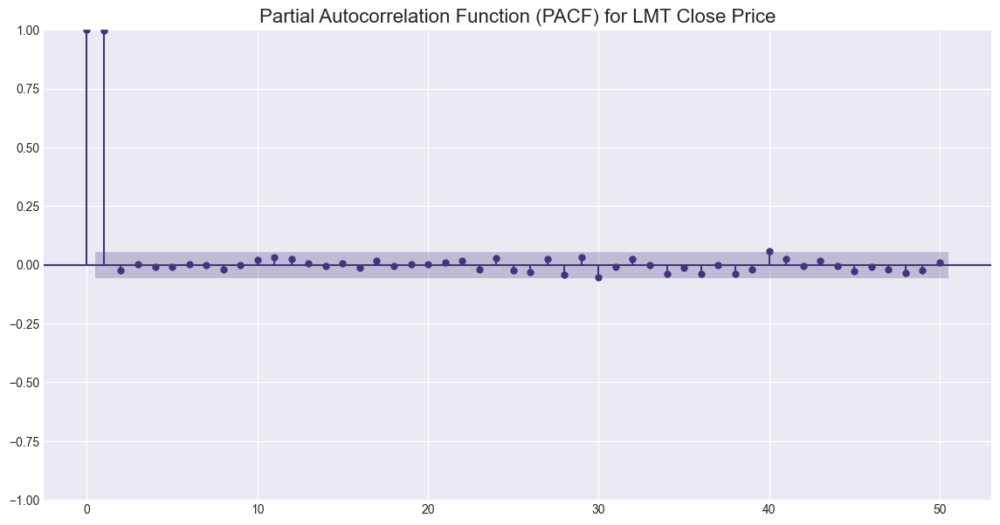


Random Forest Classification Report (Predicting Price Direction):
              precision    recall  f1-score   support

           0       0.40      0.41      0.41        87
           1       0.59      0.58      0.58       125

    accuracy                           0.51       212
   macro avg       0.49      0.49      0.49       212
weighted avg       0.51      0.51      0.51       212



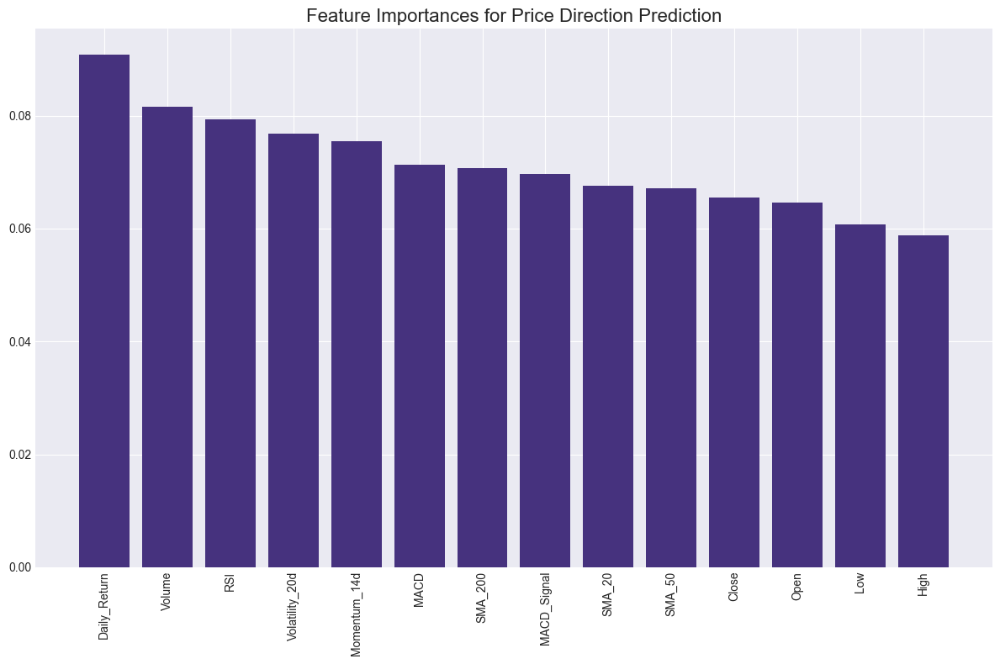


Saved processed data to LMT_data.csv

Analyzing correlations between stocks...
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1095 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data
Downloaded 1256 rows of data


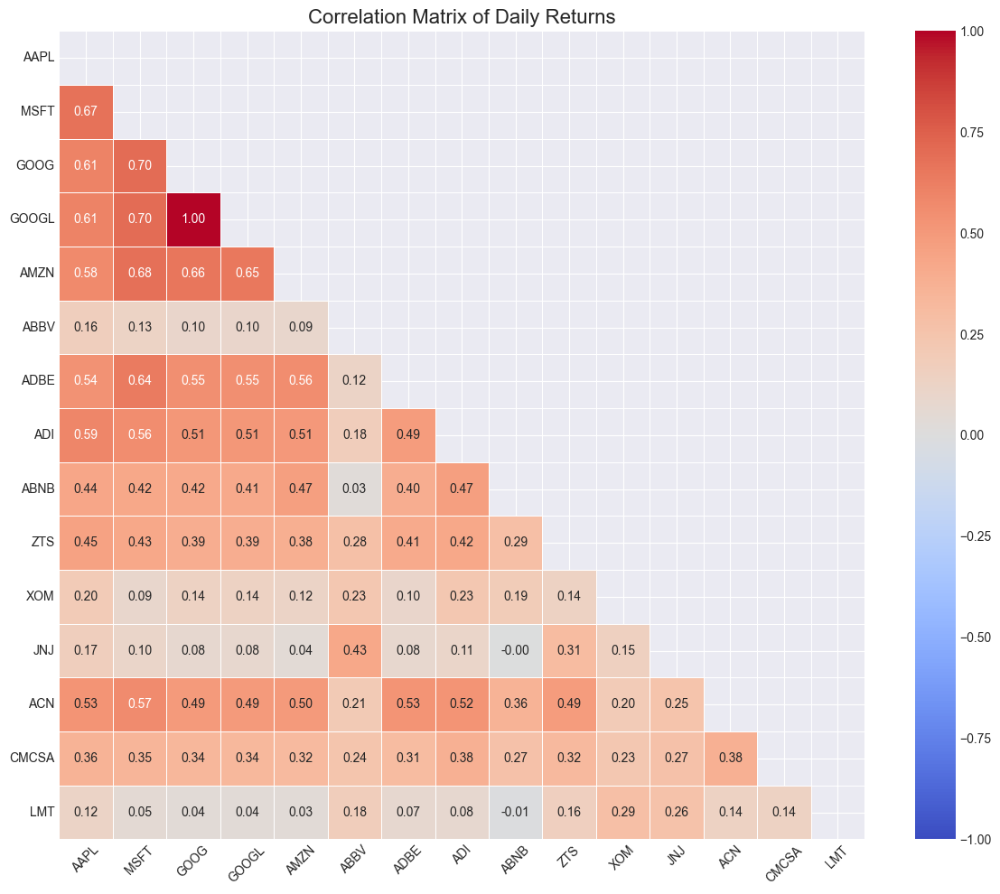

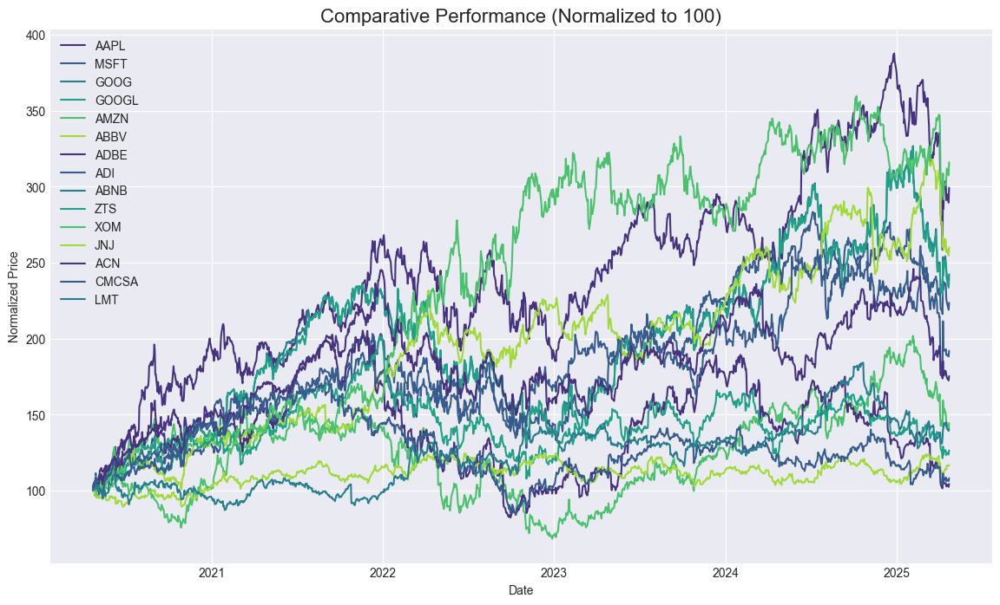


Exploration completed!


In [11]:
def main():
    """
    Main function to run the EDA
    """
    # Set of stocks to analyze
    # You can customize this list based on your interests
    stock_list = ['AAPL', 'MSFT', 'GOOG', 'GOOGL', 'AMZN', 'ABBV', 'ADBE', 'ADI', 'ABNB', 'ZTS', 'XOM', 'JNJ', 'ACN', 'CMCSA', 'LMT']
    
    # Analyze individual stocks
    explore_specific_stocks(stock_list)
    
    # Analyze correlations between stocks
    print("\nAnalyzing correlations between stocks...")
    returns_df, corr_matrix = correlation_analysis(stock_list)
    
    print("\nExploration completed!")

if __name__ == "__main__":
    main()